# Import packages & functions

In [1]:
%load_ext autoreload
%autoreload 2

import os
import cv2
import sys
import json
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import transforms
from tqdm import tqdm
from datetime import datetime
import webdataset as wds
import PIL

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
local_rank = 0
print("device:",device)

import utils
from models import BrainNetwork, BrainDiffusionPrior, Voxel2StableDiffusionModel, VersatileDiffusionPriorNetwork

seed=42
utils.seed_everything(seed=seed)

# Load CLIP extractor
from models import Clipper
clip_extractor = Clipper("ViT-L/14", hidden_state=True, norm_embs=True, device=device)
imsize = 512

device: cuda


2023-04-24 17:43:28.527949: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-04-24 17:43:32.700813: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


ViT-L/14 cuda


# CLIP retrieval evaluation

## Load pretrained voxel2clip model

In [9]:
# Load image token model
model_name = "fsdptest6new" #"v2c_vers___" #"v2c_vers_new_mse5_1e-3" # "v2c_vers"
out_dim = 512 #257 * 768

outdir = f'../train_logs/{model_name}'
ckpt_path = os.path.join(outdir, f'last_backup.pth')
print("ckpt_path",ckpt_path)
checkpoint = torch.load(ckpt_path, map_location='cpu')

print("EPOCH: ",checkpoint['epoch'])

with torch.no_grad():
    voxel2clip = BrainNetwork(out_dim=out_dim) 
    voxel2clip.eval()
    voxel2clip.load_state_dict(checkpoint['model_state_dict'],strict=False) 
    voxel2clip.requires_grad_(False) # dont need to calculate gradients
    voxel2clip.to(device)
    pass

del checkpoint

ckpt_path ../train_logs/fsdptest6new/last_backup.pth
EPOCH:  15


## For Alex

In [6]:
# # Load image token model
# model_name = "v2c_b32_image"
# out_dim = 512

# outdir = f'../train_logs/{model_name}'
# ckpt_path = os.path.join(outdir, f'last_backup.pth')
# print("ckpt_path",ckpt_path)
# checkpoint = torch.load(ckpt_path, map_location='cpu')

# print("EPOCH: ",checkpoint['epoch'])

# with torch.no_grad():
#     voxel2clip = BrainNetwork(out_dim=out_dim) 
#     voxel2clip.eval()
#     voxel2clip.load_state_dict(checkpoint['model_state_dict'],strict=False) 
#     voxel2clip.requires_grad_(False) # dont need to calculate gradients
#     voxel2clip.to(device)
#     pass

# del checkpoint

# train_url = "{/fsx/proj-medarc/fmri/natural-scenes-dataset/webdataset_avg_split/train/train_subj01_{0..17}.tar,/fsx/proj-medarc/fmri/natural-scenes-dataset/webdataset_avg_split/val/val_subj01_0.tar}"
# val_url = "/fsx/proj-medarc/fmri/natural-scenes-dataset/webdataset_avg_split/test/test_subj01_{0..1}.tar"
# meta_url = "/fsx/proj -medarc/fmri/natural-scenes-dataset/webdataset_avg_split/metadata_subj01.json"
# num_train = 8559 + 300
# num_val = 982
# batch_size = 300

# train_data = wds.WebDataset(train_url, resampled=False)\
#     .decode("torch")\
#     .rename(images="jpg;png", voxels='nsdgeneral.npy', trial="trial.npy", coco="coco73k.npy", reps="num_uniques.npy")\
#     .to_tuple("voxels", "images", "coco")\
#     .batched(batch_size, partial=True)

# train_dl = torch.utils.data.DataLoader(train_data, batch_size=None, shuffle=False)

# train_pred_clips = None
# for train_i, (voxel, img, coco) in enumerate(tqdm(train_dl,total=num_train//batch_size)):
#     with torch.no_grad():
#         voxel=voxel.to(device)
#         for i in range(3):
#             if i==0:
#                 emb_ = voxel2clip(voxel[:,i].float())[:,None]
#             else:
#                 emb_ = torch.cat((emb_, voxel2clip(voxel[:,i].float())[:,None] ),dim=1)
            
#         if train_pred_clips is None:
#             train_pred_clips = emb_
#         else:
#             train_pred_clips = torch.vstack((train_pred_clips, emb_))
            
# np.save('subj01_vitb32image_train_pred_clips.npy', train_pred_clips.detach().cpu().numpy())

# val_data = wds.WebDataset(val_url, resampled=False)\
#     .decode("torch")\
#     .rename(images="jpg;png", voxels='nsdgeneral.npy', trial="trial.npy", coco="coco73k.npy", reps="num_uniques.npy")\
#     .to_tuple("voxels", "images", "coco")\
#     .batched(batch_size, partial=True)

# val_dl = torch.utils.data.DataLoader(val_data, batch_size=None, shuffle=False)

# val_pred_clips = None
# for val_i, (voxel, img, coco) in enumerate(tqdm(val_dl,total=num_val//batch_size)):
#     with torch.no_grad():
#         voxel=voxel.to(device)
#         voxel = torch.mean(voxel,axis=1).to(device)
#         emb_ = voxel2clip(voxel.float())
#         if val_pred_clips is None:
#             val_pred_clips = emb_
#         else:
#             val_pred_clips = torch.vstack((val_pred_clips, emb_))
            
# np.save('subj01_vitb32image_test_pred_clips.npy', val_pred_clips.detach().cpu().numpy())

ckpt_path ../train_logs/v2c_b32_image/last_backup.pth
EPOCH:  265


30it [01:26,  2.87s/it]                                                                                     
4it [00:09,  2.32s/it]                                                                                      


## Prep data loader

In [10]:
batch_size = 300 # same as used in mind_reader

# train_url = "{/fsx/proj-medarc/fmri/natural-scenes-dataset/webdataset_avg_split/train/train_subj01_{0..17}.tar,/fsx/proj-medarc/fmri/natural-scenes-dataset/webdataset_avg_split/val/val_subj01_0.tar}"
val_url = "/fsx/proj-medarc/fmri/natural-scenes-dataset/webdataset_avg_split/test/test_subj01_{0..1}.tar"
meta_url = "/fsx/proj-medarc/fmri/natural-scenes-dataset/webdataset_avg_split/metadata_subj01.json"
num_train = 8559 + 300
num_val = 982

val_batch_size = 300
val_loops = 30

voxels_key = 'nsdgeneral.npy' # 1d inputs
# voxels_key = 'wholebrain_3d.npy' #3d inputs

val_data = wds.WebDataset(val_url, resampled=True)\
    .decode("torch")\
    .rename(images="jpg;png", voxels=voxels_key, trial="trial.npy", coco="coco73k.npy", reps="num_uniques.npy")\
    .to_tuple("voxels", "images", "coco")\
    .batched(val_batch_size, partial=False)\
    .with_epoch(val_loops)

val_dl = torch.utils.data.DataLoader(val_data, batch_size=None, shuffle=False)

# check that your data loader is working
for val_i, (voxel, img_input, coco) in enumerate(val_dl):
    print("idx",val_i)
    print("voxel.shape",voxel.shape)
    print("img_input.shape",img_input.shape)
    break

idx 0
voxel.shape torch.Size([300, 3, 15724])
img_input.shape torch.Size([300, 3, 256, 256])


100%|█████████████████████████████████████████████████████████████████| 30/30 [01:19<00:00,  2.65s/it]


## Forward / Backward quantification

In [14]:
# clip_extractor = Clipper("ViT-B/32", hidden_state=False, norm_embs=False, device=device)

percent_correct_fwd, percent_correct_bwd = None, None

for val_i, (voxel, img, coco) in enumerate(tqdm(val_dl,total=val_loops)):
    with torch.no_grad():
        voxel = torch.mean(voxel,axis=1).to(device) # average across repetitions

        emb = clip_extractor.embed_image(img.to(device)).float() # CLIP-Image
        emb_ = voxel2clip(voxel.float())#.view(len(voxel),-1,768) # CLIP-Brain
        # emb_ = emb_ / torch.norm(emb_[:, 0], dim=-1).reshape(-1, 1, 1)
        
        #emb = clip_extractor.embed_curated_annotations(subj01_annots[trial]) # CLIP-Text
        
        # flatten if necessary
        emb = emb.reshape(len(emb),-1)
        emb_ = emb_.reshape(len(emb_),-1)
        
        # l2norm 
        emb = nn.functional.normalize(emb,dim=-1)
        emb_ = nn.functional.normalize(emb_,dim=-1)
        
        labels = torch.arange(len(emb)).to(device)
        bwd_sim = utils.batchwise_cosine_similarity(emb,emb_)  # clip, brain
        fwd_sim = utils.batchwise_cosine_similarity(emb_,emb)  # brain, clip

        assert len(bwd_sim) == batch_size
        
        if percent_correct_fwd is None:
            cnt=len(fwd_sim)
            percent_correct_fwd = utils.topk(fwd_sim, labels,k=1)
            percent_correct_bwd = utils.topk(bwd_sim, labels,k=1)
        else:
            cnt+=len(fwd_sim)
            percent_correct_fwd += utils.topk(fwd_sim, labels,k=1)
            percent_correct_bwd += utils.topk(bwd_sim, labels,k=1)
print("cnt",cnt,"val_i",val_i)
percent_correct_fwd /= (val_i+1)
percent_correct_bwd /= (val_i+1)
print("fwd percent_correct", percent_correct_fwd)
print("bwd percent_correct", percent_correct_bwd)

100%|█████████████████████████████████████████████████████████████████| 30/30 [01:22<00:00,  2.74s/it]

cnt 9000 val_i 29
fwd percent_correct tensor(0.0691, device='cuda:0')
bwd percent_correct tensor(0.1164, device='cuda:0')


In [ ]:
# fwd percent_correct tensor(0.9369, device='cuda:0')
# bwd percent_correct tensor(0.9011, device='cuda:0')

In [26]:
percent_correct_fwd, percent_correct_bwd = None, None

for val_i, (voxel, img, coco) in enumerate(tqdm(val_dl,total=val_loops)):
    with torch.no_grad():
        voxel = voxel[:,0].to(device) # use first repetition

        emb = clip_extractor.embed_image(img.to(device)) # CLIP-Image
        emb_ = voxel2clip(voxel.float()) # CLIP-Brain
        
        # flatten if necessary
        emb = emb.reshape(len(emb),-1)
        emb_ = emb_.reshape(len(emb_),-1)

        # l2norm 
        emb = nn.functional.normalize(emb,dim=-1)
        emb_ = nn.functional.normalize(emb_,dim=-1)

        labels = torch.arange(len(emb)).to(device)
        bwd_sim = utils.batchwise_cosine_similarity(emb,emb_)  # clip, brain
        fwd_sim = utils.batchwise_cosine_similarity(emb_,emb)  # brain, clip

        assert len(bwd_sim) == batch_size
        
        if percent_correct_fwd is None:
            cnt=len(fwd_sim)
            percent_correct_fwd = utils.topk(fwd_sim, labels,k=1)
            percent_correct_bwd = utils.topk(bwd_sim, labels,k=1)
        else:
            cnt+=len(fwd_sim)
            percent_correct_fwd += utils.topk(fwd_sim, labels,k=1)
            percent_correct_bwd += utils.topk(bwd_sim, labels,k=1)
print("cnt",cnt,"val_i",val_i)
percent_correct_fwd /= (val_i+1)
percent_correct_bwd /= (val_i+1)
print("fwd percent_correct", percent_correct_fwd)
print("bwd percent_correct", percent_correct_bwd)

100%|███████████████████████████████████████████████████████████████████████████████| 30/30 [03:01<00:00,  6.04s/it]

cnt 9000 val_i 29
fwd percent_correct tensor(0.8652, device='cuda:0')
bwd percent_correct tensor(0.8397, device='cuda:0')


### Brain Diffuser results for comparison

In [ ]:
sub = 1
test_clips = np.load('brain-diffuser/data/extracted_features/subj{:02d}/nsd_clipvision_test.npy'.format(sub))
pred_clips = np.load('brain-diffuser/data/predicted_features/subj{:02d}/nsd_clipvision_predtest_nsdgeneral.npy'.format(sub))

In [27]:
percent_correct_fwd, percent_correct_bwd = None, None
for loop in tqdm(range(val_loops)):
    with torch.no_grad():
        random300 = np.random.permutation(np.arange(num_val))[:300]
        
        emb = torch.Tensor(test_clips[random300]).to(device)
        emb_ = torch.Tensor(pred_clips[random300]).to(device)
        
        # flatten if necessary
        emb = emb.reshape(len(emb),-1)
        emb_ = emb_.reshape(len(emb_),-1)

        # l2norm 
        emb = nn.functional.normalize(emb,dim=-1)
        emb_ = nn.functional.normalize(emb_,dim=-1)

        labels = torch.arange(len(emb)).to(device)
        bwd_sim = utils.batchwise_cosine_similarity(emb,emb_)  # clip, brain
        fwd_sim = utils.batchwise_cosine_similarity(emb_,emb)  # brain, clip

        assert len(bwd_sim) == batch_size
        
        if percent_correct_fwd is None:
            cnt=len(fwd_sim)
            percent_correct_fwd = utils.topk(fwd_sim, labels,k=1)
            percent_correct_bwd = utils.topk(bwd_sim, labels,k=1)
        else:
            cnt+=len(fwd_sim)
            percent_correct_fwd += utils.topk(fwd_sim, labels,k=1)
            percent_correct_bwd += utils.topk(bwd_sim, labels,k=1)
print("cnt",cnt,"val_i",val_i)
percent_correct_fwd /= (val_i+1)
percent_correct_bwd /= (val_i+1)
print("fwd percent_correct", percent_correct_fwd)
print("bwd percent_correct", percent_correct_bwd)

cnt 9000 val_i 29
fwd percent_correct tensor(0.2107, device='cuda:0')
bwd percent_correct tensor(0.3029, device='cuda:0')


### Plot some of the results

Forward retrieval
Aka given Brain embedding, find correct CLIP embedding


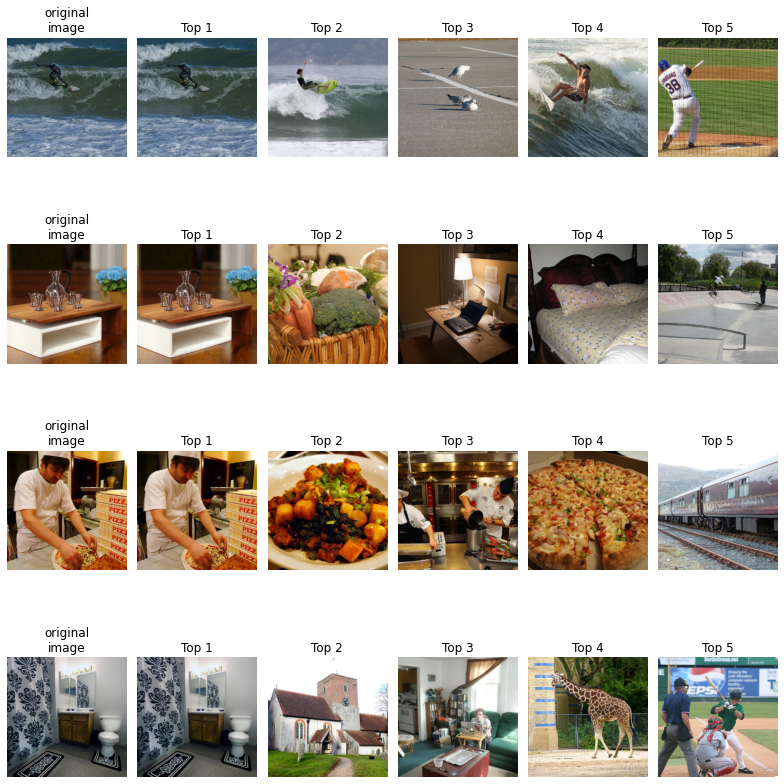

In [5]:
print("Forward retrieval")
print("Aka given Brain embedding, find correct CLIP embedding")
try:
    fwd_sim = np.array(fwd_sim.cpu())
except:
    fwd_sim = np.array(fwd_sim)
fig, ax = plt.subplots(nrows=4, ncols=6, figsize=(11,12))
for trial in range(4):
    ax[trial, 0].imshow(utils.torch_to_Image(img[trial]))
    ax[trial, 0].set_title("original\nimage")
    ax[trial, 0].axis("off")
    for attempt in range(5):
        which = np.flip(np.argsort(fwd_sim[trial]))[attempt]
        ax[trial, attempt+1].imshow(utils.torch_to_Image(img[which]))
        ax[trial, attempt+1].set_title(f"Top {attempt+1}")
        ax[trial, attempt+1].axis("off")
fig.tight_layout()
plt.show()

Backward retrieval
Aka given CLIP embedding, find correct Brain embedding


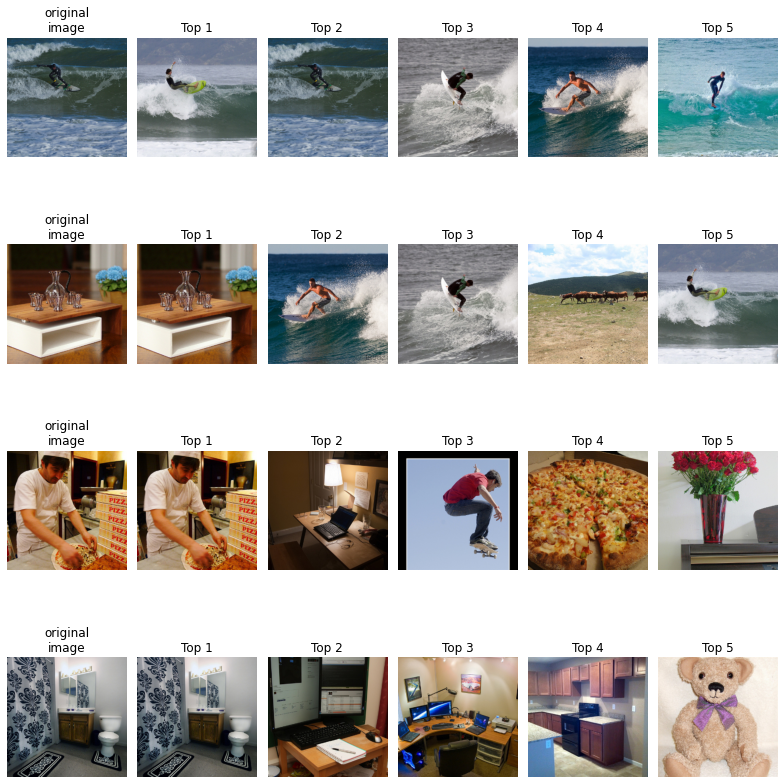

In [6]:
print("Backward retrieval")
print("Aka given CLIP embedding, find correct Brain embedding")
try:
    bwd_sim = np.array(bwd_sim.cpu())
except:
    bwd_sim = np.array(bwd_sim)
fig, ax = plt.subplots(nrows=4, ncols=6, figsize=(11,12))
for trial in range(4):
    ax[trial, 0].imshow(utils.torch_to_Image(img[trial]))
    ax[trial, 0].set_title("original\nimage")
    ax[trial, 0].axis("off")
    for attempt in range(5):
        which = np.flip(np.argsort(bwd_sim[trial]))[attempt]
        ax[trial, attempt+1].imshow(utils.torch_to_Image(img[which]))
        ax[trial, attempt+1].set_title(f"Top {attempt+1}")
        ax[trial, attempt+1].axis("off")
fig.tight_layout()
plt.show()

# Reconstruction evaluation

## Load pretrained models

In [26]:
# Load image token model
model_name = "v2c_v2" #"pearson4" #"v2c_vers_xmse_1e-3" #"v2c_vers_new_mse5_1e-3" # "v2c_vers"
out_dim = 257 * 768

outdir = f'../train_logs/{model_name}'
ckpt_path = os.path.join(outdir, f'last.pth')
print("ckpt_path",ckpt_path)
checkpoint = torch.load(ckpt_path, map_location='cpu')

print("EPOCH: ",checkpoint['epoch'])

with torch.no_grad():
    voxel2clip_img = BrainNetwork(out_dim=out_dim) 
    voxel2clip_img.eval()
    voxel2clip_img.load_state_dict(checkpoint['model_state_dict'], strict=False)
    voxel2clip_img.requires_grad_(False) # dont need to calculate gradients
    voxel2clip_img.to(device)
    pass

del checkpoint

ckpt_path ../train_logs/v2c_v2/last.pth
EPOCH:  299


In [2]:
out_dim = 257 * 768
voxel2clip_kwargs = dict(out_dim=out_dim, norm_type='ln', act_first=False)
voxel2clip = BrainNetwork(**voxel2clip_kwargs)
voxel2clip.requires_grad_(False)
voxel2clip.eval()

# need folder "checkpoints" with following files
# wget https://huggingface.co/nousr/conditioned-prior/raw/main/vit-l-14/aesthetic/prior_config.json
# wget https://huggingface.co/nousr/conditioned-prior/resolve/main/vit-l-14/aesthetic/best.pth
out_dim = 768
depth = 6
dim_head = 64
heads = 12 # heads * dim_head = 12 * 64 = 768
timesteps = 100

prior_network = VersatileDiffusionPriorNetwork(
        dim=out_dim,
        depth=depth,
        dim_head=dim_head,
        heads=heads,
        causal=False,
        learned_query_mode="pos_emb"
    ).to(device)

diffusion_prior = BrainDiffusionPrior(
    net=prior_network,
    image_embed_dim=out_dim,
    condition_on_text_encodings=False,
    timesteps=timesteps,
    cond_drop_prob=0.2,
    image_embed_scale=None,
    voxel2clip=voxel2clip,
).to(device)

# model_name = "prior9X"
# outdir = f'../train_logs/{model_name}'
# ckpt_path = os.path.join(outdir, f'last.pth')

model_name = 'prior_nodetr_noncausal_posemb_240_cont'
ckpt_path = '/fsx/proj-medarc/fmri/fMRI-reconstruction-NSD/train_logs/models/prior_nodetr_noncausal_posemb_240_cont/epoch239.pth'

print("ckpt_path",ckpt_path)
checkpoint = torch.load(ckpt_path, map_location=device)
state_dict = checkpoint['model_state_dict']
print("EPOCH: ",checkpoint['epoch'])
for key in list(state_dict.keys()):
    if 'module.' in key:
        state_dict[key.replace('module.', '')] = state_dict[key]
        del state_dict[key]
diffusion_prior.load_state_dict(state_dict,strict=False)
diffusion_prior.eval().to(device)
diffusion_priors = [diffusion_prior]
pass

ckpt_path /fsx/proj-medarc/fmri/fMRI-reconstruction-NSD/train_logs/models/prior_nodetr_noncausal_posemb_240_cont/epoch239.pth
EPOCH:  239


In [4]:
# # need folder "checkpoints" with following files
# # wget https://huggingface.co/nousr/conditioned-prior/raw/main/vit-l-14/aesthetic/prior_config.json
# # wget https://huggingface.co/nousr/conditioned-prior/resolve/main/vit-l-14/aesthetic/best.pth
# voxel2clip_cls = BrainNetwork(out_dim=768)
# diffusion_prior = BrainDiffusionPrior.from_pretrained(
#     dict(),
#     dict(
#         condition_on_text_encodings=False,
#         timesteps=1000,
#         voxel2clip=voxel2clip_cls,
#     ),
# )

# model_name = "v2c_1x768_1gpu_prior__"
# outdir = f'../train_logs/{model_name}'
# ckpt_path = os.path.join(outdir, f'last.pth')
# print("ckpt_path",ckpt_path)
# checkpoint = torch.load(ckpt_path, map_location=device)
# state_dict = checkpoint['model_state_dict']
# print("EPOCH: ",checkpoint['epoch'])
# for key in list(state_dict.keys()):
#     if 'module.' in key:
#         state_dict[key.replace('module.', '')] = state_dict[key]
#         del state_dict[key]
# diffusion_prior.load_state_dict(state_dict) # messes up expecting voxel2clip, which gets defined below
# diffusion_prior.eval().to(device)
# diffusion_priors = [diffusion_prior]
# pass

ckpt_path ../train_logs/v2c_1x768_1gpu_prior__/last.pth
EPOCH:  155


In [5]:
# Load image token model
model_name = "v2c_77x768_1gpu_mse_"#norm_ok"
out_dim = 77 * 768

outdir = f'../train_logs/{model_name}'
ckpt_path = os.path.join(outdir, f'last.pth')
print("ckpt_path",ckpt_path)
checkpoint = torch.load(ckpt_path, map_location='cpu')
print("EPOCH: ",checkpoint['epoch'])
with torch.no_grad():
    voxel2clip_txt = BrainNetwork(out_dim=out_dim) 
    print("converting ddp model to non-ddp format")
    state_dict = checkpoint['model_state_dict']
    for key in list(state_dict.keys()):
        if 'module.' in key:
            state_dict[key.replace('module.', '')] = state_dict[key]
            del state_dict[key]
    voxel2clip_txt.eval()
    voxel2clip_txt.load_state_dict(state_dict)
    for param in voxel2clip_txt.parameters():
        param.requires_grad = False # dont need to calculate gradients
    voxel2clip_txt.to(device)
    pass

del checkpoint

ckpt_path ../train_logs/v2c_77x768_1gpu_mse_/last.pth
EPOCH:  299
converting ddp model to non-ddp format


## Prep data loader

In [3]:
image_var = 'images'
# train_url = "{/fsx/proj-medarc/fmri/natural-scenes-dataset/webdataset_avg_split/train/train_subj01_{0..17}.tar,/fsx/proj-medarc/fmri/natural-scenes-dataset/webdataset_avg_split/val/val_subj01_0.tar}"
val_url = "/fsx/proj-medarc/fmri/natural-scenes-dataset/webdataset_avg_split/test/test_subj01_{0..1}.tar"
meta_url = "/fsx/proj-medarc/fmri/natural-scenes-dataset/webdataset_avg_split/metadata_subj01.json"
num_train = 8559 + 300
num_val = 982

batch_size = val_batch_size = 1

voxels_key = 'nsdgeneral.npy' # 1d inputs
# voxels_key = 'wholebrain_3d.npy' #3d inputs

val_data = wds.WebDataset(val_url, resampled=False)\
    .decode("torch")\
    .rename(images="jpg;png", voxels=voxels_key, trial="trial.npy", coco="coco73k.npy", reps="num_uniques.npy")\
    .to_tuple("voxels", "images", "coco")\
    .batched(val_batch_size, partial=False)

val_dl = torch.utils.data.DataLoader(val_data, batch_size=None, shuffle=False)

# check that your data loader is working
for val_i, (voxel, img_input, coco) in enumerate(val_dl):
    print("idx",val_i)
    print("voxel.shape",voxel.shape)
    print("img_input.shape",img_input.shape)
    break

idx 0
voxel.shape torch.Size([1, 3, 15724])
img_input.shape torch.Size([1, 3, 256, 256])


### Load pretrained generative model

In [14]:
from diffusers import VersatileDiffusionDualGuidedPipeline, UniPCMultistepScheduler
from diffusers.models import DualTransformer2DModel
vd_cache_dir = '/fsx/proj-medarc/fmri/cache/models--shi-labs--versatile-diffusion/snapshots/2926f8e11ea526b562cd592b099fcf9c2985d0b7'
vd_pipe =  VersatileDiffusionDualGuidedPipeline.from_pretrained(
        # "lambdalabs/sd-image-variations-diffusers",
        vd_cache_dir,
        safety_checker=None,
        requires_safety_checker=False,
        torch_dtype=torch.float16,
    )
vd_pipe.image_unet.eval().to(device)
vd_pipe.vae.eval().to(device)
vd_pipe.image_unet.requires_grad_(False)
vd_pipe.vae.requires_grad_(False)

vd_pipe.scheduler = UniPCMultistepScheduler.from_pretrained(vd_cache_dir, subfolder="scheduler")
num_inference_steps = 20

# Set weighting of Dual-Guidance 
text_image_ratio = .0 # .5 means equally weight text and image, 0 means only use image
condition_types = ("text", "image")
for name, module in vd_pipe.image_unet.named_modules():
    if isinstance(module, DualTransformer2DModel):
        module.mix_ratio = text_image_ratio
        for i, type in enumerate(condition_types):
            if type == "text":
                module.condition_lengths[i] = 77
                module.transformer_index_for_condition[i] = 1  # use the second (text) transformer
            else:
                module.condition_lengths[i] = 257
                module.transformer_index_for_condition[i] = 0  # use the first (image) transformer

Keyword arguments {'safety_checker': None, 'requires_safety_checker': False} are not expected by VersatileDiffusionDualGuidedPipeline and will be ignored.


In [3]:
# from diffusers import AutoencoderKL, PNDMScheduler, UNet2DConditionModel, UniPCMultistepScheduler, Transformer2DModel
# from diffusers.models import DualTransformer2DModel
# from diffusers.pipelines.versatile_diffusion.modeling_text_unet import UNetFlatConditionModel

# with torch.no_grad():
#     sd_cache_dir = '/fsx/proj-medarc/fmri/cache/models--shi-labs--versatile-diffusion/snapshots/2926f8e11ea526b562cd592b099fcf9c2985d0b7'
#     if not os.path.isdir(sd_cache_dir): # download from huggingface if not already downloaded / cached
#         from diffusers import VersatileDiffusionPipeline
#         print("Downloading from huggingface...")
#         sd_pipe = VersatileDiffusionPipeline.from_pretrained("shi-labs/versatile-diffusion")
#         sd_cache_dir = "shi-labs/versatile-diffusion"
#     unet = UNet2DConditionModel.from_pretrained(sd_cache_dir,subfolder="image_unet").to(device)
#     unet.eval() # dont want to train model
#     unet.requires_grad_(False) # dont need to calculate gradients

#     vae = AutoencoderKL.from_pretrained(sd_cache_dir,subfolder="vae").to(device)
#     vae.eval()
#     vae.requires_grad_(False)

#     scheduler = "unipc" # "pndms" or "unipc"

#     text_unet = UNetFlatConditionModel.from_pretrained(sd_cache_dir,subfolder="text_unet").to(device)
#     text_unet.eval() # dont want to train model
#     text_unet.requires_grad_(False) # dont need to calculate gradients

#     noise_scheduler = PNDMScheduler.from_pretrained(sd_cache_dir, subfolder="scheduler")
#     if scheduler == "unipc":
#         noise_scheduler = UniPCMultistepScheduler.from_config(noise_scheduler.config)
#         num_inference_steps = 20
#     else:
#         num_inference_steps = 50

#     # convert to dual attention         
#     for name, module in unet.named_modules():
#         if isinstance(module, Transformer2DModel):
#             parent_name, index = name.rsplit(".", 1)
#             index = int(index)

#             image_transformer = unet.get_submodule(parent_name)[index]
#             text_transformer = text_unet.get_submodule(parent_name)[index]

#             config = image_transformer.config
#             dual_transformer = DualTransformer2DModel(
#                 num_attention_heads=config.num_attention_heads,
#                 attention_head_dim=config.attention_head_dim,
#                 in_channels=config.in_channels,
#                 num_layers=config.num_layers,
#                 dropout=config.dropout,
#                 norm_num_groups=config.norm_num_groups,
#                 cross_attention_dim=config.cross_attention_dim,
#                 attention_bias=config.attention_bias,
#                 sample_size=config.sample_size,
#                 num_vector_embeds=config.num_vector_embeds,
#                 activation_fn=config.activation_fn,
#                 num_embeds_ada_norm=config.num_embeds_ada_norm,
#             )
#             dual_transformer.transformers[0] = image_transformer
#             dual_transformer.transformers[1] = text_transformer

#             unet.get_submodule(parent_name)[index] = dual_transformer
#             unet.register_to_config(dual_cross_attention=True)
            
#     import logging
#     logging.getLogger("transformers.modeling_utils").setLevel(logging.ERROR)
#     from transformers import CLIPTextModelWithProjection, CLIPTokenizer
#     tokenizer = CLIPTokenizer.from_pretrained("openai/clip-vit-large-patch14")
#     text_encoder = CLIPTextModelWithProjection.from_pretrained("openai/clip-vit-large-patch14").to(device)
#     text_encoder.eval()
#     text_encoder.requires_grad_(False)

#     # annots = np.load("/fsx/proj-medarc/fmri/natural-scenes-dataset/COCO_73k_annots_curated.npy")
    
#     text_image_ratio = .0 # .5 means equally weight text and image, 0 means only use image
#     condition_types = ("text", "image")
#     for name, module in unet.named_modules():
#         if isinstance(module, DualTransformer2DModel):
#             module.mix_ratio = text_image_ratio
#             for i, type in enumerate(condition_types):
#                 if type == "text":
#                     module.condition_lengths[i] = 77
#                     module.transformer_index_for_condition[i] = 1  # use the second (text) transformer
#                 else:
#                     module.condition_lengths[i] = 257
#                     module.transformer_index_for_condition[i] = 0  # use the first (image) transformer

## Check autoencoder works

In [21]:
voxel2sd = Voxel2StableDiffusionModel()
state_dict = torch.load('../train_logs/models/autoencoder/test/ckpt-epoch120.pth', 
                        map_location='cpu')["model_state_dict"]
# for key in list(state_dict.keys()):
#     if 'module.' in key:
#         state_dict[key.replace('module.', '')] = state_dict[key]
#         del state_dict[key]
voxel2sd.load_state_dict(state_dict)
voxel2sd.eval()
voxel2sd.to(device)
pass

## Testing Furkan's code

  0%|                                                   | 0/982 [00:00<?, ?it/s]

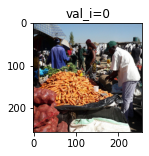

  0%|                                           | 1/982 [00:00<02:21,  6.93it/s]

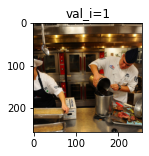

  0%|                                           | 2/982 [00:00<02:04,  7.87it/s]

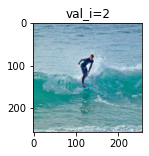

  0%|▏                                          | 3/982 [00:00<02:06,  7.75it/s]

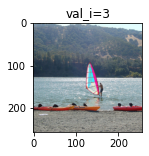

  0%|▏                                          | 4/982 [00:00<02:01,  8.02it/s]

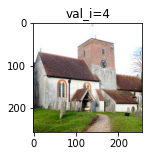

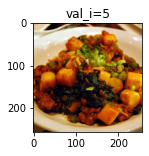

  1%|▎                                          | 6/982 [00:00<01:39,  9.79it/s]

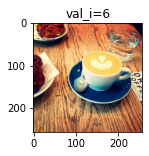

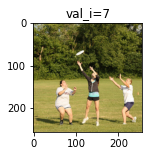

  1%|▎                                          | 8/982 [00:00<01:35, 10.17it/s]

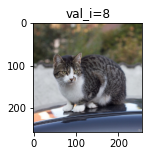

  1%|▍                                          | 9/982 [00:01<01:45,  9.21it/s]

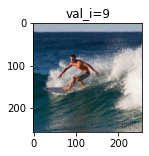

  1%|▍                                         | 10/982 [00:01<01:51,  8.73it/s]

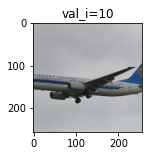

  1%|▍                                         | 11/982 [00:01<01:51,  8.74it/s]

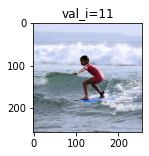

  1%|▌                                         | 12/982 [00:01<01:51,  8.74it/s]

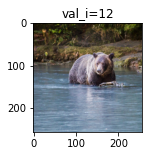

  1%|▌                                         | 13/982 [00:01<01:51,  8.70it/s]

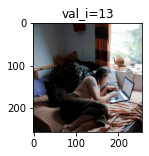

  1%|▌                                         | 14/982 [00:01<01:51,  8.70it/s]

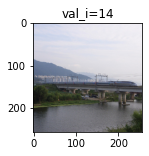

  2%|▋                                         | 15/982 [00:01<01:52,  8.61it/s]

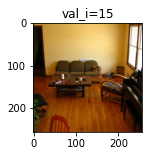

  2%|▋                                         | 16/982 [00:01<02:02,  7.86it/s]

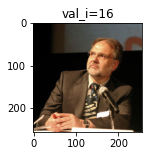

  2%|▋                                         | 17/982 [00:02<02:05,  7.68it/s]

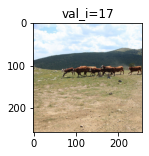

  2%|▊                                         | 18/982 [00:02<02:05,  7.68it/s]

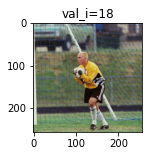

  2%|▊                                         | 19/982 [00:02<02:06,  7.59it/s]

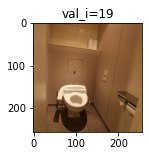

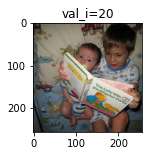

  2%|▉                                         | 21/982 [00:02<01:50,  8.67it/s]

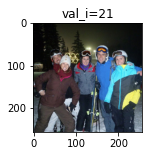

  2%|▉                                         | 22/982 [00:02<01:49,  8.80it/s]

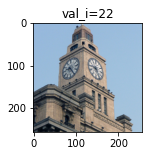

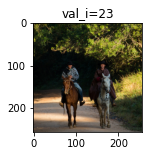

  2%|█                                         | 24/982 [00:02<01:41,  9.45it/s]

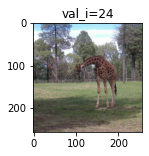

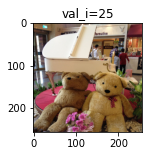

  3%|█                                         | 26/982 [00:03<02:29,  6.41it/s]

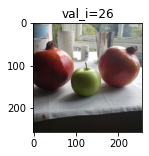

  3%|█▏                                        | 27/982 [00:03<02:23,  6.66it/s]

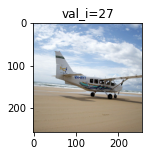

  3%|█▏                                        | 28/982 [00:03<02:15,  7.06it/s]

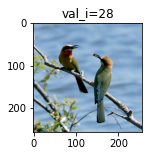

  3%|█▏                                        | 29/982 [00:03<02:08,  7.42it/s]

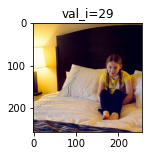

  3%|█▎                                        | 30/982 [00:03<02:03,  7.71it/s]

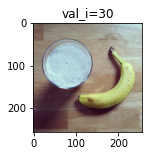

  3%|█▎                                        | 31/982 [00:03<01:59,  7.95it/s]

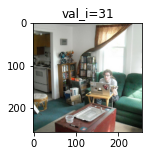

  3%|█▎                                        | 32/982 [00:03<01:56,  8.15it/s]

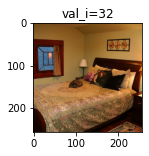

  3%|█▍                                        | 33/982 [00:04<01:53,  8.33it/s]

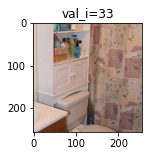

  3%|█▍                                        | 34/982 [00:04<01:52,  8.46it/s]

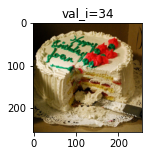

  4%|█▍                                        | 35/982 [00:04<01:50,  8.56it/s]

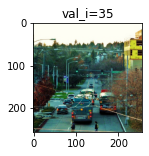

  4%|█▌                                        | 36/982 [00:04<01:49,  8.61it/s]

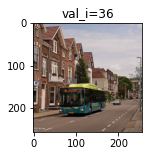

  4%|█▌                                        | 37/982 [00:04<01:49,  8.67it/s]

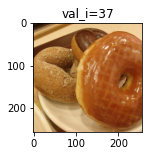

  4%|█▋                                        | 38/982 [00:04<01:48,  8.71it/s]

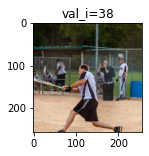

  4%|█▋                                        | 39/982 [00:04<01:48,  8.72it/s]

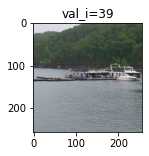

  4%|█▋                                        | 40/982 [00:04<01:50,  8.51it/s]

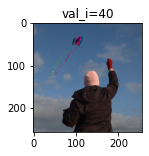

  4%|█▊                                        | 41/982 [00:04<01:52,  8.36it/s]

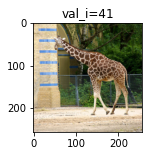

  4%|█▊                                        | 42/982 [00:05<01:53,  8.28it/s]

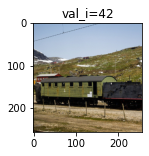

  4%|█▊                                        | 43/982 [00:05<01:49,  8.56it/s]

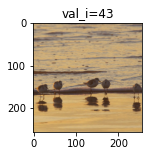

  4%|█▉                                        | 44/982 [00:05<01:58,  7.94it/s]

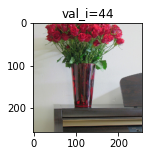

  5%|█▉                                        | 45/982 [00:05<01:57,  7.95it/s]

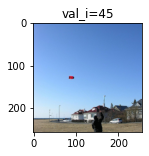

  5%|█▉                                        | 46/982 [00:05<01:54,  8.21it/s]

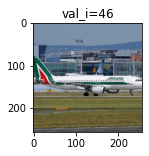

  5%|██                                        | 47/982 [00:05<01:54,  8.13it/s]

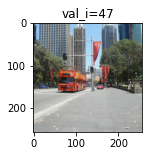

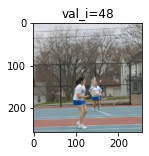

  5%|██                                        | 49/982 [00:05<01:45,  8.87it/s]

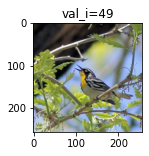

  5%|██▏                                       | 50/982 [00:06<01:42,  9.08it/s]

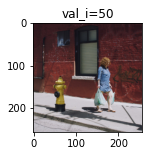

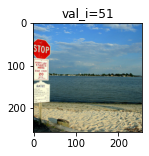

  5%|██▏                                       | 52/982 [00:06<01:37,  9.58it/s]

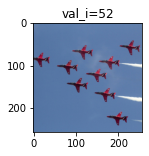

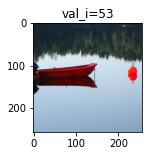

  5%|██▎                                       | 54/982 [00:06<01:32, 10.04it/s]

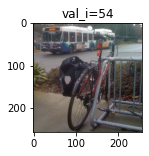

  6%|██▎                                       | 55/982 [00:06<01:34,  9.79it/s]

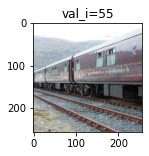

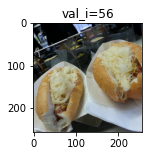

  6%|██▍                                       | 57/982 [00:06<01:32,  9.99it/s]

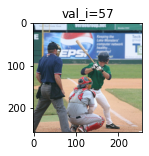

  6%|██▍                                       | 58/982 [00:06<01:43,  8.92it/s]

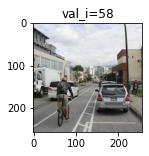

  6%|██▌                                       | 59/982 [00:06<01:46,  8.67it/s]

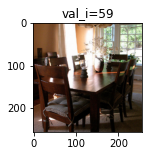

  6%|██▌                                       | 60/982 [00:07<01:52,  8.19it/s]

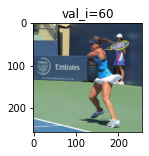

  6%|██▌                                       | 61/982 [00:07<02:01,  7.59it/s]

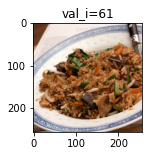

  6%|██▋                                       | 62/982 [00:07<01:59,  7.73it/s]

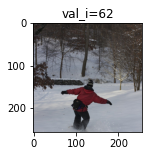

  6%|██▋                                       | 63/982 [00:07<01:54,  8.04it/s]

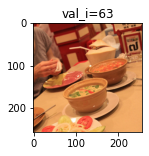

  7%|██▋                                       | 64/982 [00:07<01:54,  8.05it/s]

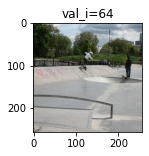

  7%|██▊                                       | 65/982 [00:07<01:48,  8.44it/s]

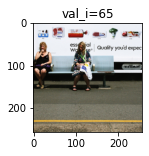

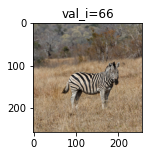

  7%|██▊                                       | 67/982 [00:07<01:33,  9.76it/s]

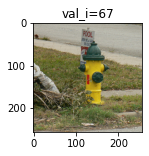

  7%|██▉                                       | 68/982 [00:08<01:34,  9.66it/s]

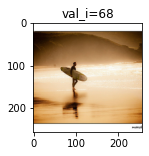

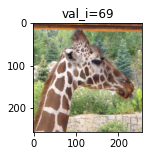

  7%|██▉                                       | 70/982 [00:08<01:30, 10.06it/s]

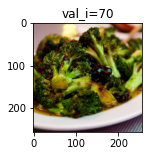

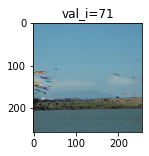

  7%|███                                       | 72/982 [00:08<01:33,  9.76it/s]

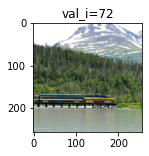

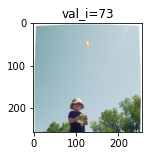

  8%|███▏                                      | 74/982 [00:08<01:30, 10.06it/s]

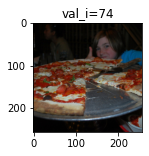

  8%|███▏                                      | 75/982 [00:08<01:32,  9.77it/s]

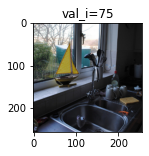

  8%|███▎                                      | 76/982 [00:08<01:40,  9.06it/s]

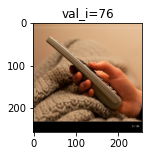

  8%|███▎                                      | 77/982 [00:09<02:51,  5.27it/s]

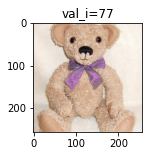

  8%|███▎                                      | 78/982 [00:09<02:33,  5.87it/s]

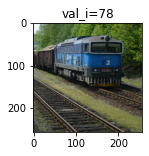

  8%|███▍                                      | 79/982 [00:09<02:24,  6.26it/s]

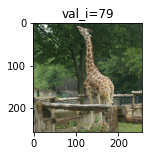

  8%|███▍                                      | 80/982 [00:09<02:12,  6.81it/s]

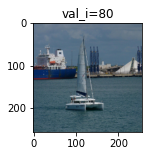

  8%|███▍                                      | 81/982 [00:09<02:03,  7.28it/s]

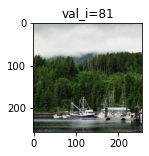

  8%|███▌                                      | 82/982 [00:09<01:57,  7.68it/s]

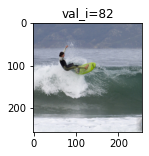

  8%|███▌                                      | 83/982 [00:10<01:55,  7.77it/s]

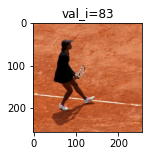

  9%|███▌                                      | 84/982 [00:10<01:53,  7.92it/s]

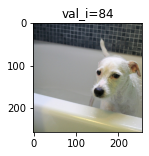

  9%|███▋                                      | 85/982 [00:10<01:49,  8.17it/s]

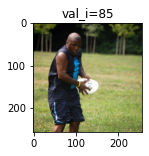

  9%|███▋                                      | 86/982 [00:10<01:47,  8.35it/s]

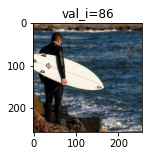

  9%|███▋                                      | 87/982 [00:10<01:48,  8.24it/s]

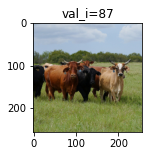

  9%|███▊                                      | 88/982 [00:10<01:46,  8.38it/s]

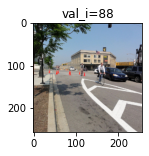

  9%|███▊                                      | 89/982 [00:10<01:45,  8.44it/s]

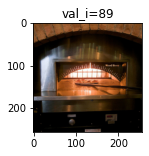

  9%|███▊                                      | 90/982 [00:10<01:49,  8.15it/s]

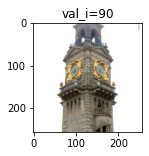

  9%|███▉                                      | 91/982 [00:10<01:49,  8.17it/s]

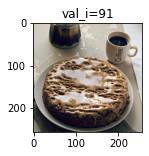

  9%|███▉                                      | 92/982 [00:11<01:46,  8.33it/s]

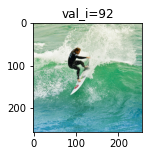

  9%|███▉                                      | 93/982 [00:11<01:44,  8.49it/s]

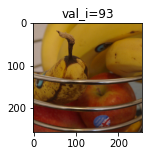

 10%|████                                      | 94/982 [00:11<01:43,  8.60it/s]

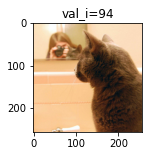

 10%|████                                      | 95/982 [00:11<01:45,  8.42it/s]

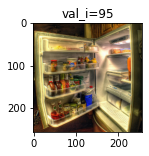

 10%|████                                      | 96/982 [00:11<01:43,  8.54it/s]

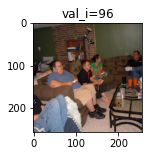

 10%|████▏                                     | 97/982 [00:11<01:42,  8.62it/s]

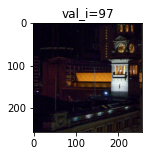

 10%|████▏                                     | 98/982 [00:11<01:45,  8.41it/s]

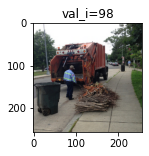

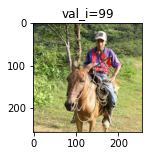

 10%|████▏                                    | 100/982 [00:12<01:38,  8.92it/s]

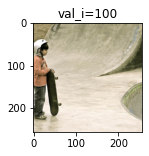

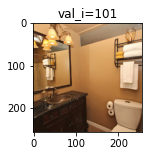

 10%|████▎                                    | 102/982 [00:12<01:36,  9.12it/s]

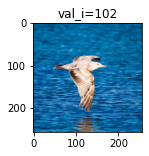

 10%|████▎                                    | 103/982 [00:12<01:42,  8.60it/s]

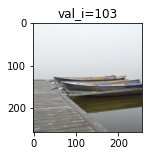

 11%|████▎                                    | 104/982 [00:12<01:44,  8.43it/s]

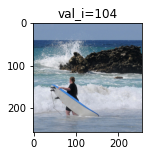

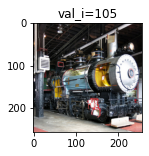

 11%|████▍                                    | 106/982 [00:12<01:35,  9.21it/s]

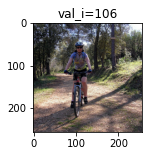

 11%|████▍                                    | 107/982 [00:12<01:41,  8.63it/s]

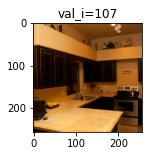

 11%|████▌                                    | 108/982 [00:12<01:40,  8.67it/s]

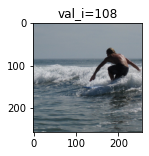

 11%|████▌                                    | 109/982 [00:13<01:40,  8.72it/s]

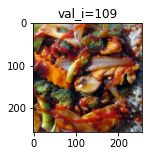

 11%|████▌                                    | 110/982 [00:13<01:41,  8.56it/s]

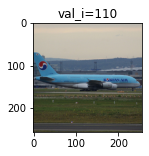

 11%|████▋                                    | 111/982 [00:13<01:41,  8.62it/s]

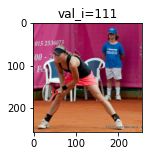

 11%|████▋                                    | 112/982 [00:13<01:40,  8.68it/s]

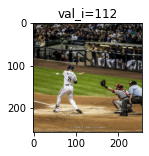

 12%|████▋                                    | 113/982 [00:13<01:39,  8.71it/s]

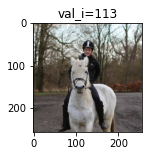

 12%|████▊                                    | 114/982 [00:13<01:42,  8.49it/s]

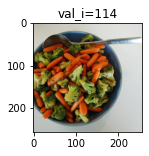

 12%|████▊                                    | 115/982 [00:13<01:40,  8.61it/s]

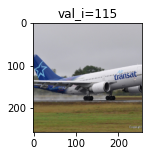

 12%|████▊                                    | 116/982 [00:13<01:41,  8.54it/s]

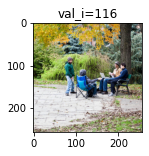

 12%|████▉                                    | 117/982 [00:13<01:39,  8.71it/s]

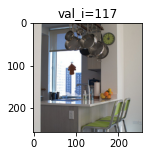

 12%|████▉                                    | 118/982 [00:14<01:41,  8.53it/s]

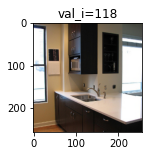

 12%|████▉                                    | 119/982 [00:14<01:40,  8.61it/s]

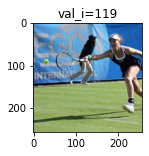

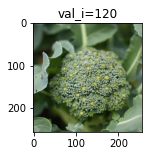

 12%|█████                                    | 121/982 [00:14<01:26, 10.01it/s]

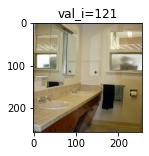

 12%|█████                                    | 122/982 [00:14<01:26,  9.90it/s]

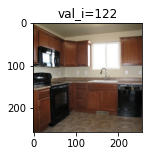

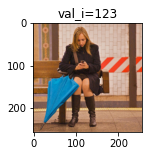

 13%|█████▏                                   | 124/982 [00:14<01:25,  9.98it/s]

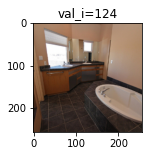

 13%|█████▏                                   | 125/982 [00:14<01:26,  9.93it/s]

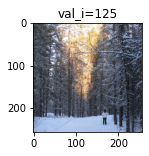

 13%|█████▎                                   | 126/982 [00:14<01:26,  9.94it/s]

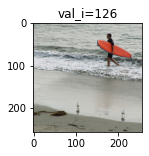

 13%|█████▎                                   | 127/982 [00:14<01:26,  9.92it/s]

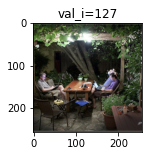

 13%|█████▎                                   | 128/982 [00:15<02:55,  4.87it/s]

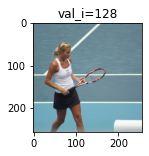

 13%|█████▍                                   | 129/982 [00:15<03:05,  4.60it/s]

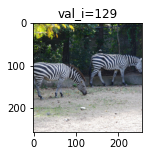

 13%|█████▍                                   | 130/982 [00:15<02:37,  5.40it/s]

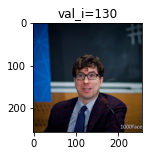

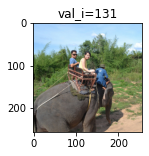

 13%|█████▌                                   | 132/982 [00:16<02:02,  6.96it/s]

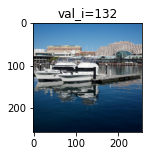

 14%|█████▌                                   | 133/982 [00:16<01:53,  7.47it/s]

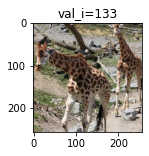

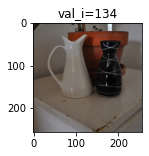

 14%|█████▋                                   | 135/982 [00:16<01:39,  8.55it/s]

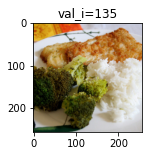

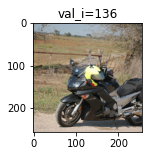

 14%|█████▋                                   | 137/982 [00:16<01:33,  9.01it/s]

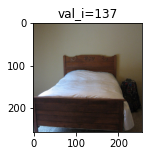

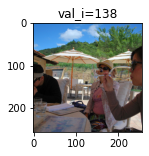

 14%|█████▊                                   | 139/982 [00:16<01:30,  9.32it/s]

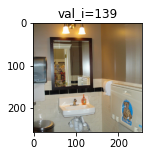

 14%|█████▊                                   | 140/982 [00:16<01:30,  9.35it/s]

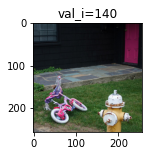

 14%|█████▉                                   | 141/982 [00:16<01:29,  9.42it/s]

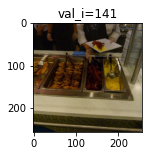

 14%|█████▉                                   | 142/982 [00:17<01:28,  9.49it/s]

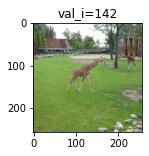

 15%|█████▉                                   | 143/982 [00:17<01:28,  9.50it/s]

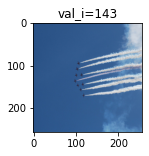

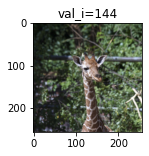

 15%|██████                                   | 145/982 [00:17<01:26,  9.72it/s]

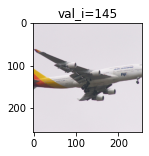

 15%|██████                                   | 146/982 [00:17<01:25,  9.77it/s]

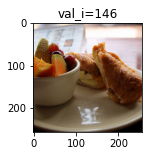

 15%|██████▏                                  | 147/982 [00:17<01:26,  9.68it/s]

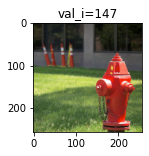

 15%|██████▏                                  | 148/982 [00:17<01:27,  9.53it/s]

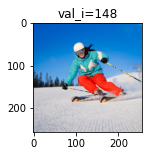

 15%|██████▏                                  | 149/982 [00:17<01:26,  9.58it/s]

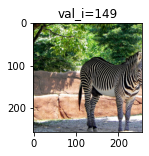

 15%|██████▎                                  | 150/982 [00:17<01:26,  9.65it/s]

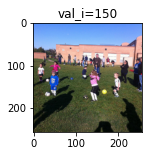

 15%|██████▎                                  | 151/982 [00:17<01:25,  9.67it/s]

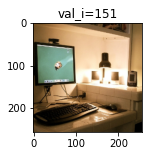

 15%|██████▎                                  | 152/982 [00:18<01:26,  9.56it/s]

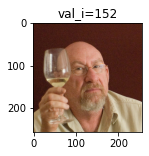

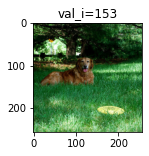

 16%|██████▍                                  | 154/982 [00:18<01:23,  9.88it/s]

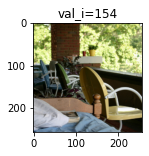

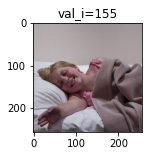

 16%|██████▌                                  | 156/982 [00:18<01:23,  9.88it/s]

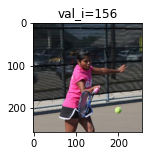

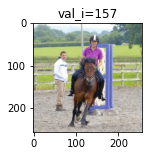

 16%|██████▌                                  | 158/982 [00:18<01:22, 10.00it/s]

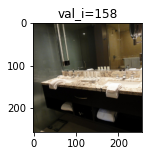

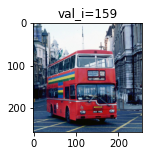

 16%|██████▋                                  | 160/982 [00:18<01:22, 10.00it/s]

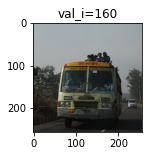

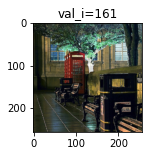

 16%|██████▊                                  | 162/982 [00:19<01:20, 10.16it/s]

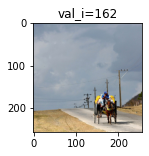

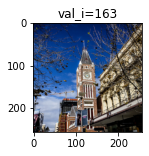

 17%|██████▊                                  | 164/982 [00:19<01:21, 10.07it/s]

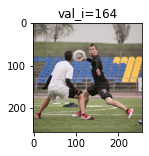

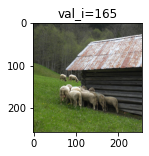

 17%|██████▉                                  | 166/982 [00:19<01:19, 10.22it/s]

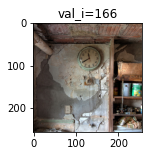

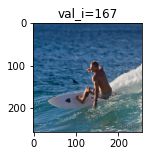

 17%|███████                                  | 168/982 [00:19<01:20, 10.11it/s]

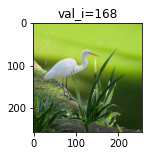

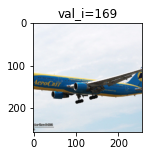

 17%|███████                                  | 170/982 [00:19<01:19, 10.18it/s]

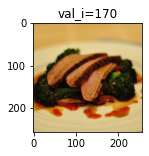

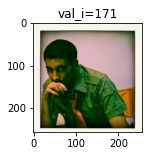

 18%|███████▏                                 | 172/982 [00:20<01:20, 10.05it/s]

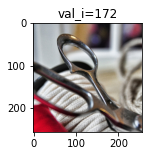

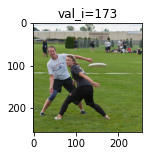

 18%|███████▎                                 | 174/982 [00:20<01:20, 10.07it/s]

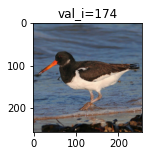

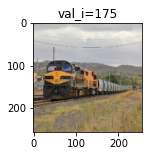

 18%|███████▎                                 | 176/982 [00:20<01:20, 10.06it/s]

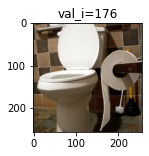

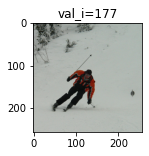

 18%|███████▍                                 | 178/982 [00:20<01:19, 10.16it/s]

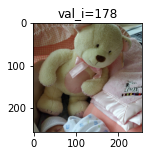

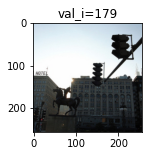

 18%|███████▌                                 | 180/982 [00:21<02:25,  5.53it/s]

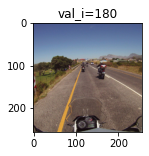

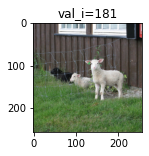

 19%|███████▌                                 | 182/982 [00:21<02:03,  6.50it/s]

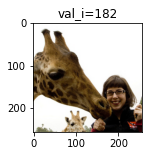

 19%|███████▋                                 | 183/982 [00:21<01:55,  6.92it/s]

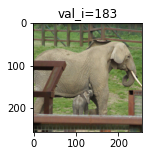

 19%|███████▋                                 | 184/982 [00:21<01:48,  7.33it/s]

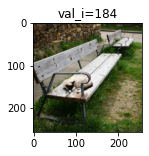

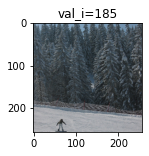

 19%|███████▊                                 | 186/982 [00:21<01:37,  8.19it/s]

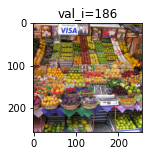

 19%|███████▊                                 | 187/982 [00:22<01:35,  8.29it/s]

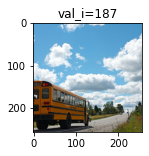

 19%|███████▊                                 | 188/982 [00:22<01:34,  8.43it/s]

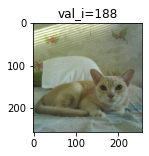

 19%|███████▉                                 | 189/982 [00:22<01:31,  8.65it/s]

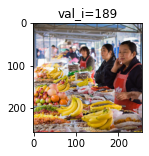

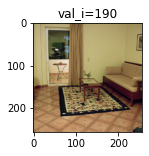

 19%|███████▉                                 | 191/982 [00:22<01:26,  9.18it/s]

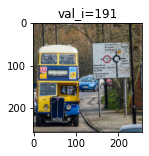

 20%|████████                                 | 192/982 [00:22<01:26,  9.12it/s]

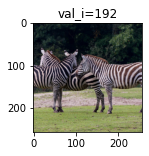

 20%|████████                                 | 193/982 [00:22<01:27,  9.01it/s]

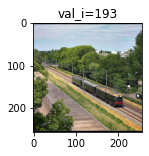

 20%|████████                                 | 194/982 [00:22<01:25,  9.21it/s]

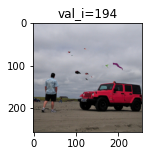

 20%|████████▏                                | 195/982 [00:22<01:27,  8.96it/s]

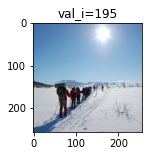

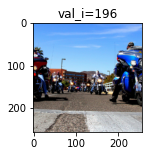

 20%|████████▏                                | 197/982 [00:23<01:23,  9.37it/s]

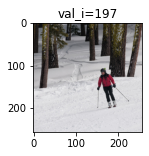

 20%|████████▎                                | 198/982 [00:23<01:24,  9.31it/s]

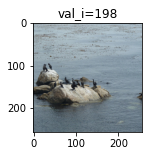

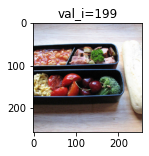

 20%|████████▎                                | 200/982 [00:23<01:20,  9.72it/s]

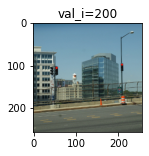

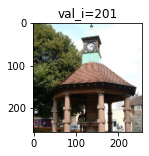

 21%|████████▍                                | 202/982 [00:23<01:19,  9.86it/s]

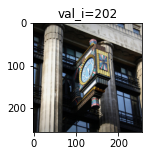

 21%|████████▍                                | 203/982 [00:23<01:19,  9.79it/s]

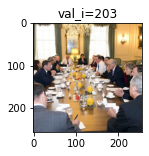

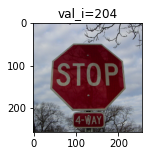

 21%|████████▌                                | 205/982 [00:23<01:18,  9.85it/s]

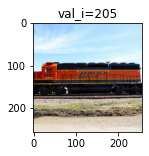

 21%|████████▌                                | 206/982 [00:24<01:18,  9.86it/s]

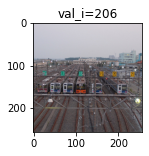

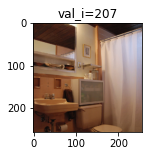

 21%|████████▋                                | 208/982 [00:24<01:16, 10.10it/s]

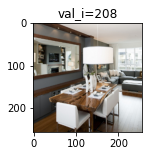

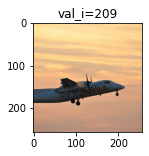

 21%|████████▊                                | 210/982 [00:24<01:17, 10.00it/s]

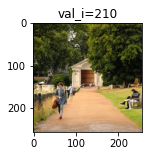

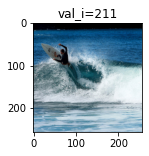

 22%|████████▊                                | 212/982 [00:24<01:15, 10.17it/s]

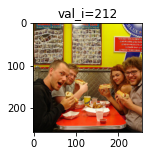

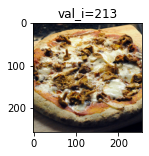

 22%|████████▉                                | 214/982 [00:24<01:16, 10.03it/s]

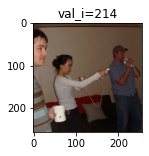

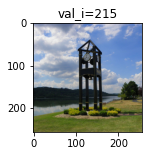

 22%|█████████                                | 216/982 [00:24<01:15, 10.16it/s]

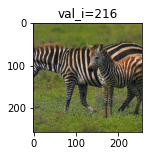

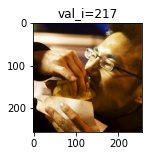

 22%|█████████                                | 218/982 [00:25<01:15, 10.11it/s]

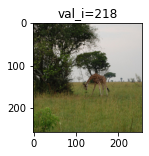

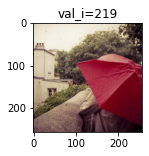

 22%|█████████▏                               | 220/982 [00:25<01:14, 10.28it/s]

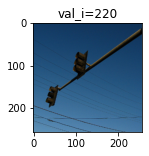

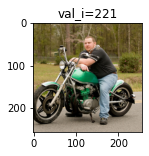

 23%|█████████▎                               | 222/982 [00:25<01:15, 10.04it/s]

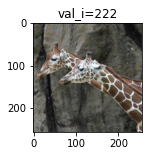

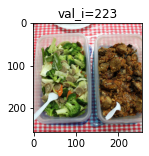

 23%|█████████▎                               | 224/982 [00:25<01:14, 10.15it/s]

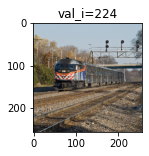

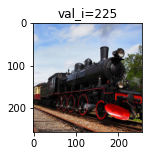

 23%|█████████▍                               | 226/982 [00:25<01:15,  9.98it/s]

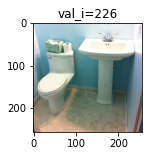

 23%|█████████▍                               | 227/982 [00:26<01:16,  9.92it/s]

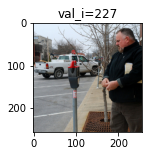

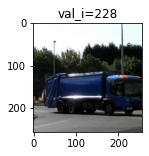

 23%|█████████▌                               | 229/982 [00:26<01:15,  9.95it/s]

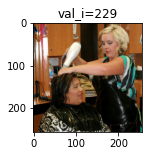

 23%|█████████▌                               | 230/982 [00:26<02:12,  5.67it/s]

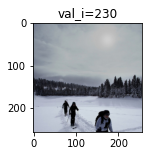

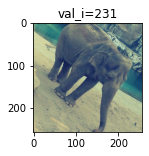

 24%|█████████▋                               | 232/982 [00:26<01:51,  6.76it/s]

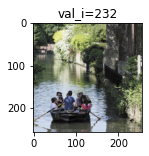

 24%|█████████▋                               | 233/982 [00:27<01:45,  7.11it/s]

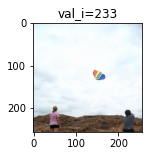

 24%|█████████▊                               | 234/982 [00:27<01:40,  7.44it/s]

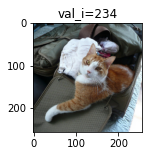

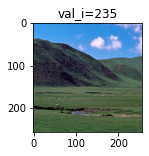

 24%|█████████▊                               | 236/982 [00:27<01:28,  8.41it/s]

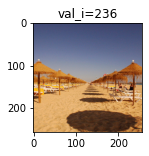

 24%|█████████▉                               | 237/982 [00:27<01:25,  8.68it/s]

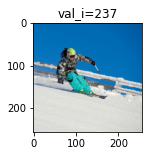

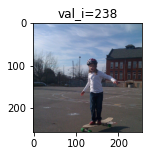

 24%|█████████▉                               | 239/982 [00:27<01:19,  9.34it/s]

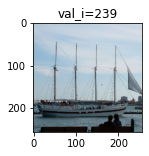

 24%|██████████                               | 240/982 [00:27<01:19,  9.29it/s]

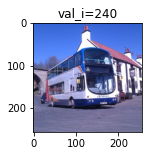

 25%|██████████                               | 241/982 [00:27<01:19,  9.38it/s]

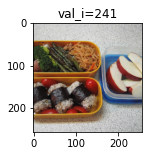

 25%|██████████                               | 242/982 [00:28<01:19,  9.35it/s]

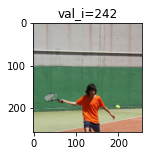

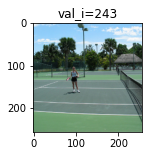

 25%|██████████▏                              | 244/982 [00:28<01:16,  9.67it/s]

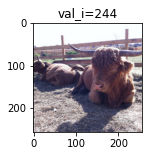

 25%|██████████▏                              | 245/982 [00:28<01:16,  9.65it/s]

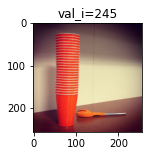

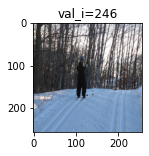

 25%|██████████▎                              | 247/982 [00:28<01:13, 10.03it/s]

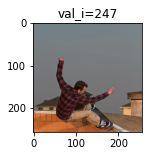

 25%|██████████▎                              | 248/982 [00:28<01:13,  9.96it/s]

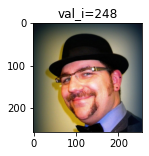

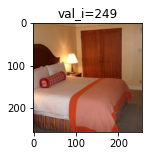

 25%|██████████▍                              | 250/982 [00:28<01:11, 10.21it/s]

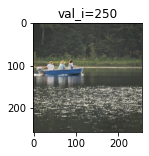

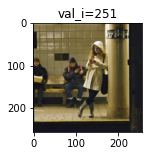

 26%|██████████▌                              | 252/982 [00:28<01:11, 10.19it/s]

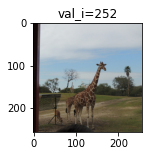

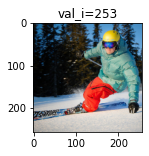

 26%|██████████▌                              | 254/982 [00:29<01:10, 10.34it/s]

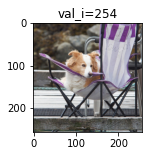

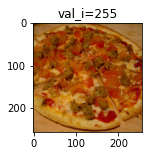

 26%|██████████▋                              | 256/982 [00:29<01:10, 10.27it/s]

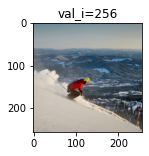

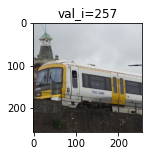

 26%|██████████▊                              | 258/982 [00:29<01:09, 10.39it/s]

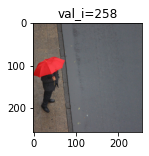

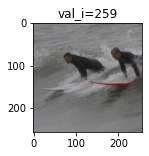

 26%|██████████▊                              | 260/982 [00:29<01:10, 10.31it/s]

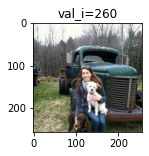

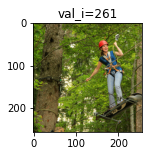

 27%|██████████▉                              | 262/982 [00:29<01:09, 10.36it/s]

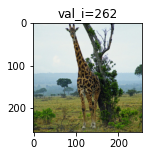

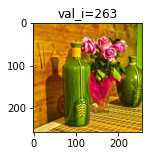

 27%|███████████                              | 264/982 [00:30<01:09, 10.30it/s]

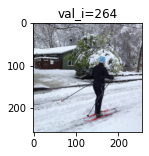

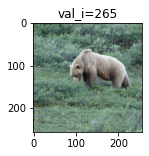

 27%|███████████                              | 266/982 [00:30<01:10, 10.19it/s]

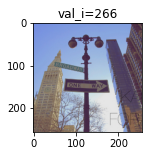

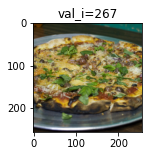

 27%|███████████▏                             | 268/982 [00:30<01:10, 10.07it/s]

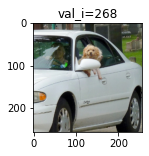

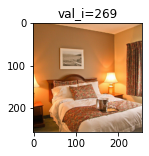

 27%|███████████▎                             | 270/982 [00:30<01:07, 10.59it/s]

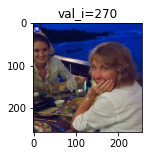

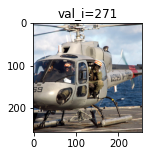

 28%|███████████▎                             | 272/982 [00:30<01:07, 10.47it/s]

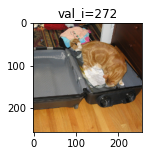

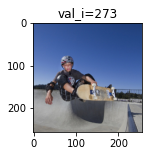

 28%|███████████▍                             | 274/982 [00:31<01:07, 10.51it/s]

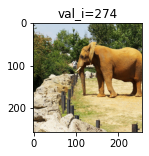

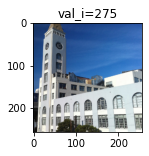

 28%|███████████▌                             | 276/982 [00:31<01:07, 10.43it/s]

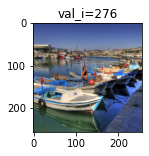

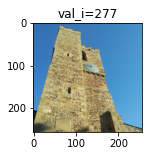

 28%|███████████▌                             | 278/982 [00:31<01:07, 10.44it/s]

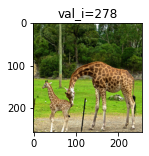

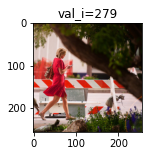

 29%|███████████▋                             | 280/982 [00:31<01:08, 10.20it/s]

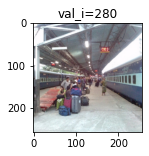

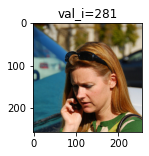

 29%|███████████▊                             | 282/982 [00:32<01:54,  6.11it/s]

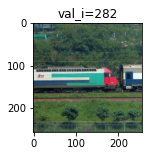

 29%|███████████▊                             | 283/982 [00:32<01:47,  6.51it/s]

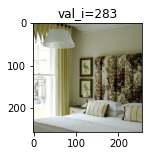

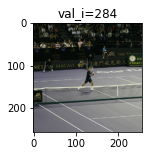

 29%|███████████▉                             | 285/982 [00:32<01:34,  7.39it/s]

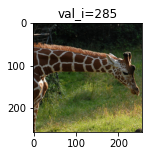

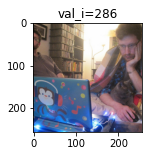

 29%|███████████▉                             | 287/982 [00:32<01:23,  8.29it/s]

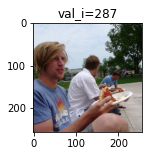

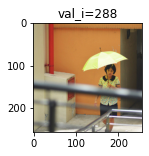

 29%|████████████                             | 289/982 [00:33<01:19,  8.76it/s]

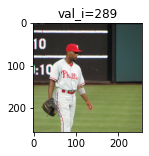

 30%|████████████                             | 290/982 [00:33<01:17,  8.89it/s]

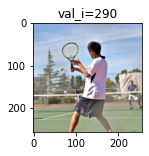

 30%|████████████▏                            | 291/982 [00:33<01:17,  8.91it/s]

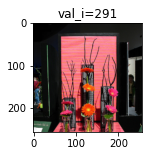

 30%|████████████▏                            | 292/982 [00:33<01:15,  9.10it/s]

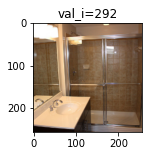

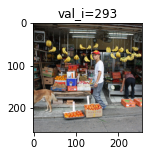

 30%|████████████▎                            | 294/982 [00:33<01:13,  9.38it/s]

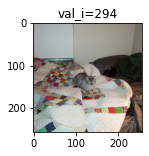

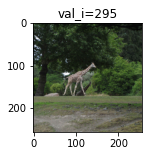

 30%|████████████▎                            | 296/982 [00:33<01:10,  9.79it/s]

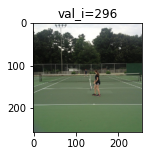

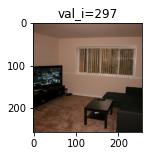

 30%|████████████▍                            | 298/982 [00:33<01:09,  9.91it/s]

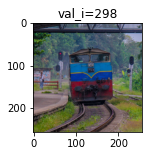

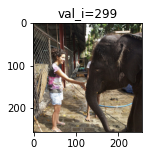

 31%|████████████▌                            | 300/982 [00:34<01:07, 10.11it/s]

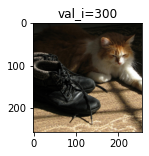

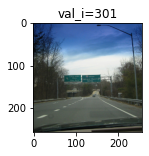

 31%|████████████▌                            | 302/982 [00:34<01:07, 10.12it/s]

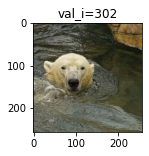

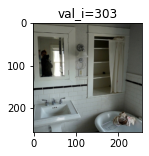

 31%|████████████▋                            | 304/982 [00:34<01:05, 10.28it/s]

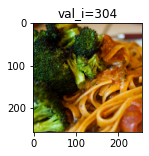

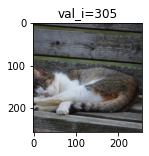

 31%|████████████▊                            | 306/982 [00:34<01:06, 10.22it/s]

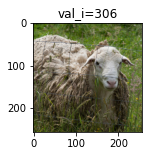

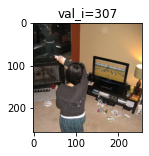

 31%|████████████▊                            | 308/982 [00:34<01:05, 10.34it/s]

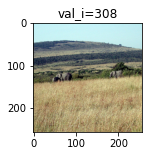

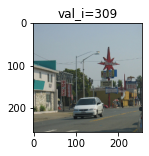

 32%|████████████▉                            | 310/982 [00:35<01:05, 10.24it/s]

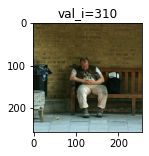

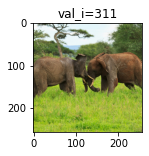

 32%|█████████████                            | 312/982 [00:35<01:05, 10.20it/s]

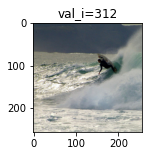

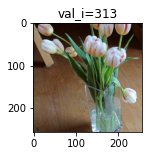

 32%|█████████████                            | 314/982 [00:35<01:06,  9.99it/s]

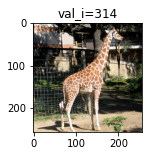

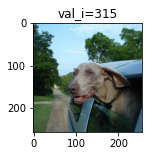

 32%|█████████████▏                           | 316/982 [00:35<01:05, 10.11it/s]

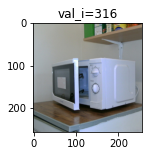

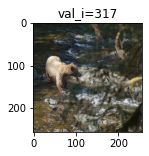

 32%|█████████████▎                           | 318/982 [00:35<01:05, 10.09it/s]

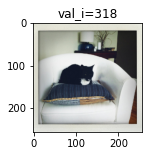

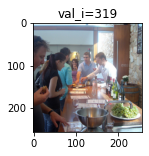

 33%|█████████████▎                           | 320/982 [00:36<01:04, 10.25it/s]

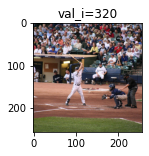

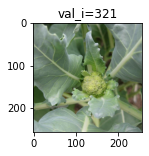

 33%|█████████████▍                           | 322/982 [00:36<01:04, 10.23it/s]

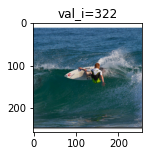

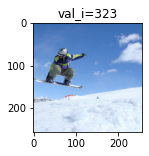

 33%|█████████████▌                           | 324/982 [00:36<01:05, 10.09it/s]

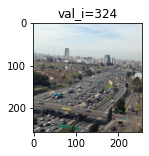

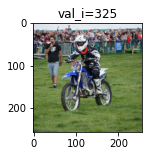

 33%|█████████████▌                           | 326/982 [00:36<01:04, 10.15it/s]

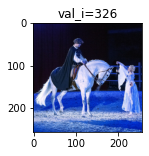

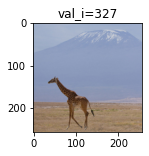

 33%|█████████████▋                           | 328/982 [00:36<01:03, 10.32it/s]

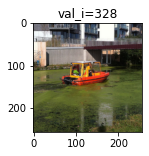

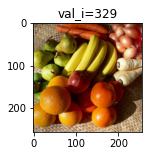

 34%|█████████████▊                           | 330/982 [00:37<01:04, 10.13it/s]

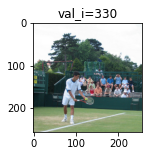

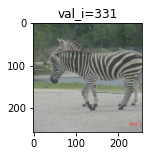

 34%|█████████████▊                           | 332/982 [00:37<01:38,  6.63it/s]

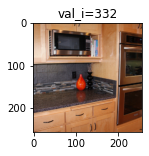

 34%|█████████████▉                           | 333/982 [00:37<01:32,  7.02it/s]

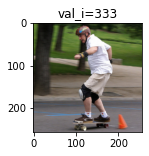

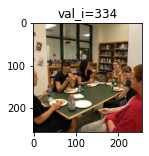

 34%|█████████████▉                           | 335/982 [00:37<01:19,  8.17it/s]

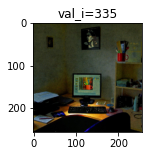

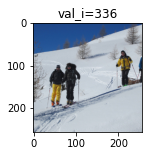

 34%|██████████████                           | 337/982 [00:38<01:14,  8.70it/s]

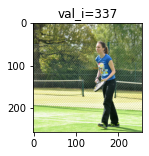

 34%|██████████████                           | 338/982 [00:38<01:12,  8.90it/s]

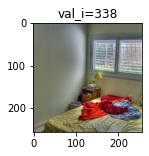

 35%|██████████████▏                          | 339/982 [00:38<01:11,  9.04it/s]

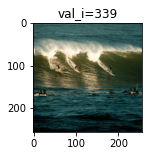

 35%|██████████████▏                          | 340/982 [00:38<01:09,  9.23it/s]

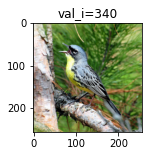

 35%|██████████████▏                          | 341/982 [00:38<01:08,  9.38it/s]

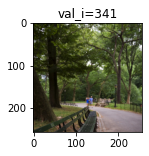

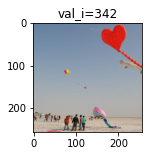

 35%|██████████████▎                          | 343/982 [00:38<01:04,  9.86it/s]

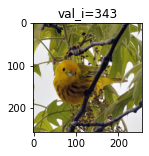

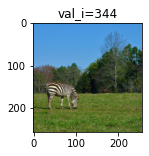

 35%|██████████████▍                          | 345/982 [00:38<01:04,  9.95it/s]

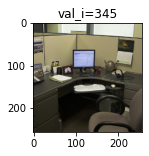

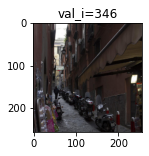

 35%|██████████████▍                          | 347/982 [00:39<01:02, 10.08it/s]

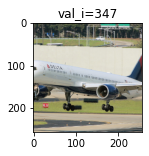

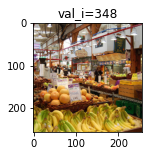

 36%|██████████████▌                          | 349/982 [00:39<01:02, 10.09it/s]

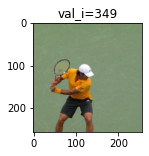

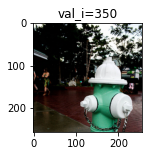

 36%|██████████████▋                          | 351/982 [00:39<01:01, 10.27it/s]

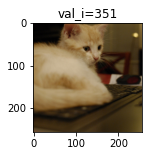

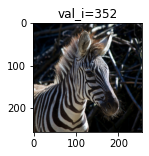

 36%|██████████████▋                          | 353/982 [00:39<01:02, 10.11it/s]

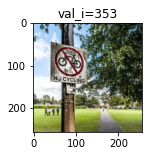

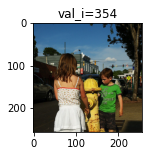

 36%|██████████████▊                          | 355/982 [00:39<01:00, 10.29it/s]

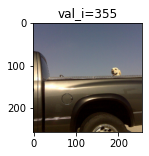

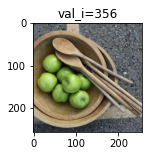

 36%|██████████████▉                          | 357/982 [00:40<01:00, 10.26it/s]

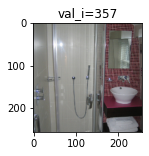

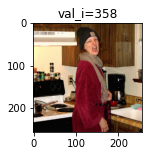

 37%|██████████████▉                          | 359/982 [00:40<01:00, 10.23it/s]

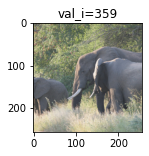

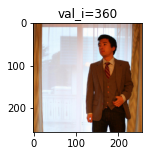

 37%|███████████████                          | 361/982 [00:40<01:01, 10.09it/s]

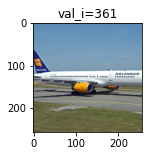

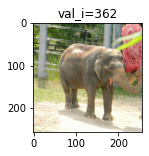

 37%|███████████████▏                         | 363/982 [00:40<01:01, 10.13it/s]

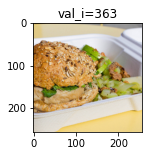

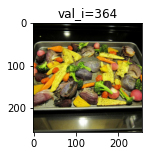

 37%|███████████████▏                         | 365/982 [00:40<01:00, 10.21it/s]

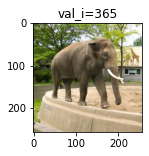

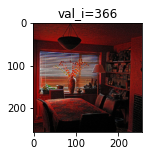

 37%|███████████████▎                         | 367/982 [00:41<01:00, 10.12it/s]

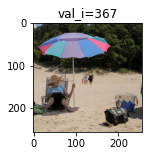

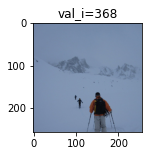

 38%|███████████████▍                         | 369/982 [00:41<01:00, 10.17it/s]

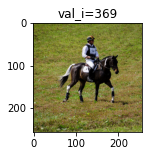

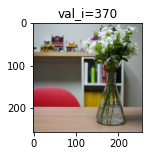

 38%|███████████████▍                         | 371/982 [00:41<01:00, 10.13it/s]

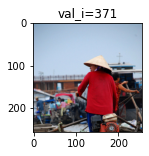

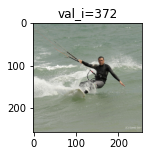

 38%|███████████████▌                         | 373/982 [00:41<00:59, 10.16it/s]

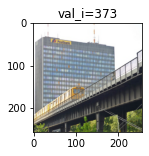

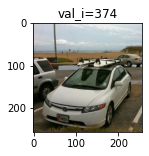

 38%|███████████████▋                         | 375/982 [00:41<01:00, 10.09it/s]

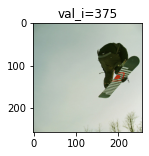

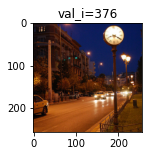

 38%|███████████████▋                         | 377/982 [00:42<00:59, 10.17it/s]

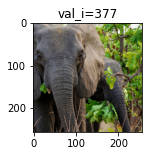

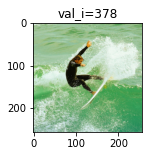

 39%|███████████████▊                         | 379/982 [00:42<00:59, 10.16it/s]

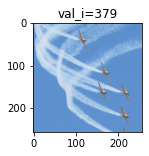

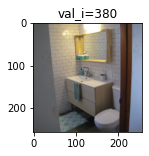

 39%|███████████████▉                         | 381/982 [00:42<00:59, 10.12it/s]

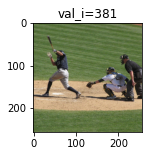

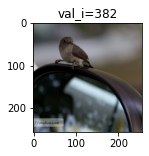

 39%|███████████████▉                         | 383/982 [00:42<01:29,  6.72it/s]

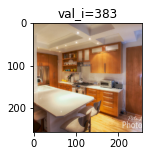

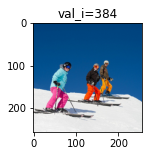

 39%|████████████████                         | 385/982 [00:43<01:18,  7.56it/s]

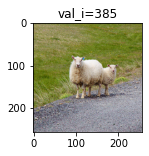

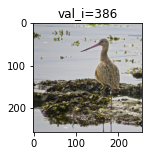

 39%|████████████████▏                        | 387/982 [00:43<01:13,  8.15it/s]

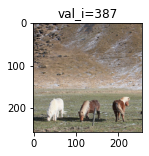

 40%|████████████████▏                        | 388/982 [00:43<01:11,  8.34it/s]

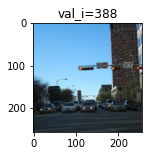

 40%|████████████████▏                        | 389/982 [00:43<01:10,  8.45it/s]

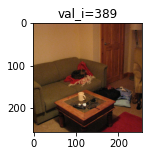

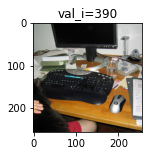

 40%|████████████████▎                        | 391/982 [00:43<01:05,  8.96it/s]

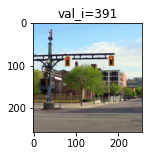

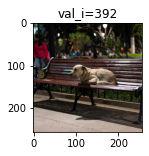

 40%|████████████████▍                        | 393/982 [00:43<01:02,  9.45it/s]

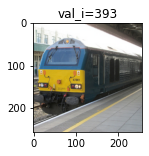

 40%|████████████████▍                        | 394/982 [00:44<01:02,  9.36it/s]

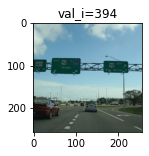

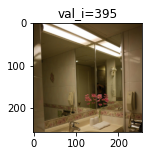

 40%|████████████████▌                        | 396/982 [00:44<00:59,  9.80it/s]

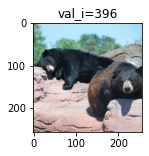

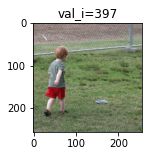

 41%|████████████████▌                        | 398/982 [00:44<00:58,  9.97it/s]

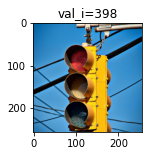

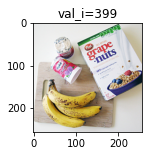

 41%|████████████████▋                        | 400/982 [00:44<00:57, 10.17it/s]

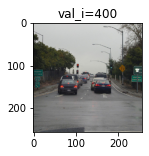

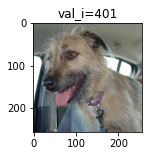

 41%|████████████████▊                        | 402/982 [00:44<00:56, 10.27it/s]

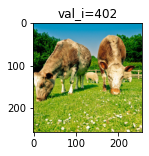

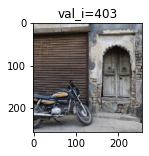

 41%|████████████████▊                        | 404/982 [00:44<00:55, 10.44it/s]

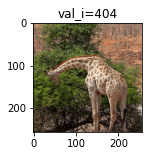

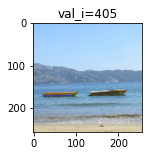

 41%|████████████████▉                        | 406/982 [00:45<00:55, 10.38it/s]

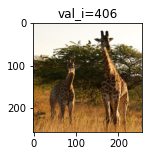

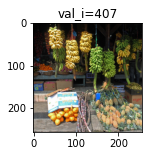

 42%|█████████████████                        | 408/982 [00:45<00:54, 10.48it/s]

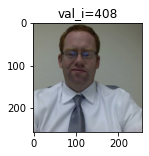

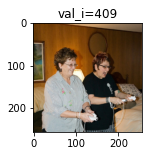

 42%|█████████████████                        | 410/982 [00:45<00:55, 10.32it/s]

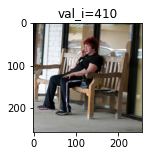

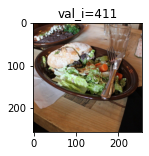

 42%|█████████████████▏                       | 412/982 [00:45<00:53, 10.70it/s]

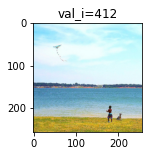

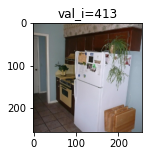

 42%|█████████████████▎                       | 414/982 [00:45<00:54, 10.43it/s]

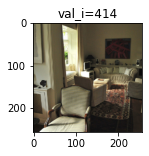

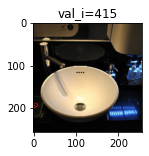

 42%|█████████████████▎                       | 416/982 [00:46<00:54, 10.43it/s]

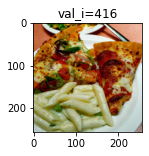

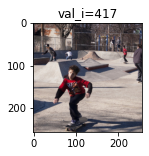

 43%|█████████████████▍                       | 418/982 [00:46<00:54, 10.34it/s]

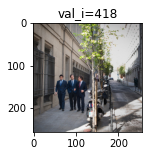

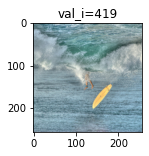

 43%|█████████████████▌                       | 420/982 [00:46<00:53, 10.46it/s]

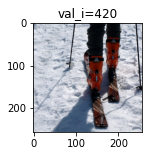

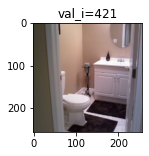

 43%|█████████████████▌                       | 422/982 [00:46<00:53, 10.41it/s]

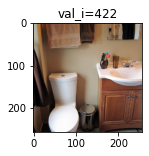

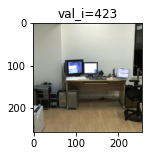

 43%|█████████████████▋                       | 424/982 [00:46<00:53, 10.41it/s]

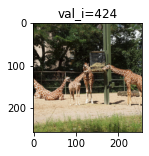

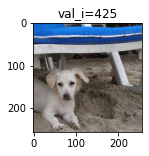

 43%|█████████████████▊                       | 426/982 [00:47<00:54, 10.25it/s]

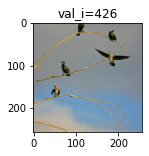

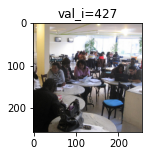

 44%|█████████████████▊                       | 428/982 [00:47<00:53, 10.31it/s]

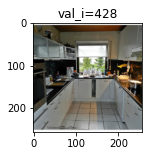

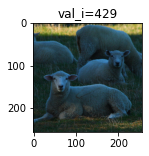

 44%|█████████████████▉                       | 430/982 [00:47<00:54, 10.14it/s]

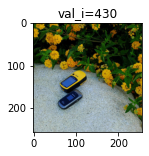

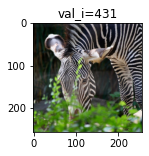

 44%|██████████████████                       | 432/982 [00:47<00:53, 10.28it/s]

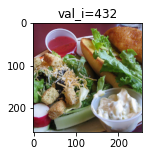

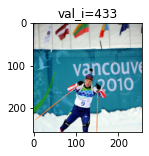

 44%|██████████████████                       | 434/982 [00:48<01:18,  6.95it/s]

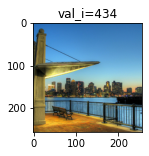

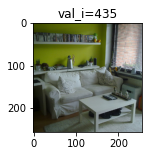

 44%|██████████████████▏                      | 436/982 [00:48<01:10,  7.76it/s]

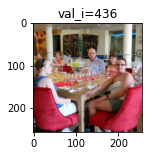

 45%|██████████████████▏                      | 437/982 [00:48<01:08,  8.00it/s]

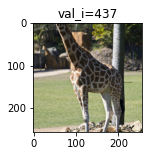

 45%|██████████████████▎                      | 438/982 [00:48<01:06,  8.18it/s]

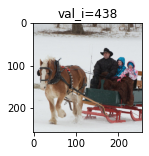

 45%|██████████████████▎                      | 439/982 [00:48<01:05,  8.33it/s]

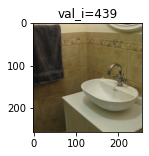

 45%|██████████████████▎                      | 440/982 [00:48<01:04,  8.35it/s]

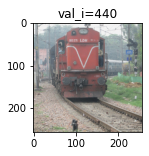

 45%|██████████████████▍                      | 441/982 [00:48<01:03,  8.57it/s]

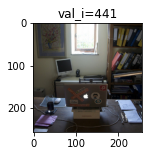

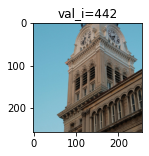

 45%|██████████████████▍                      | 443/982 [00:49<00:57,  9.40it/s]

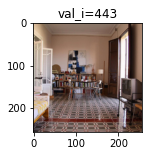

 45%|██████████████████▌                      | 444/982 [00:49<00:56,  9.50it/s]

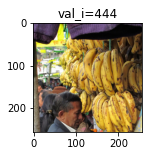

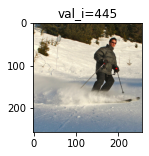

 45%|██████████████████▌                      | 446/982 [00:49<00:53,  9.98it/s]

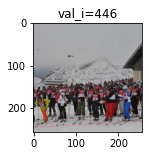

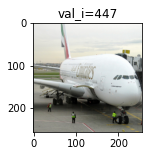

 46%|██████████████████▋                      | 448/982 [00:49<00:53,  9.95it/s]

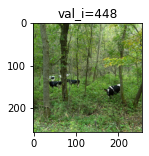

 46%|██████████████████▋                      | 449/982 [00:49<00:53,  9.96it/s]

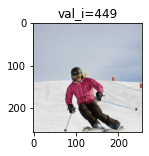

 46%|██████████████████▊                      | 450/982 [00:49<00:53,  9.93it/s]

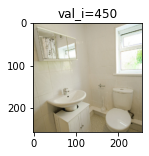

 46%|██████████████████▊                      | 451/982 [00:49<00:53,  9.85it/s]

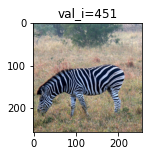

 46%|██████████████████▊                      | 452/982 [00:50<00:54,  9.72it/s]

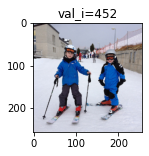

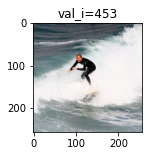

 46%|██████████████████▉                      | 454/982 [00:50<00:52, 10.01it/s]

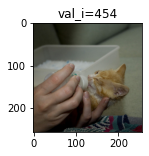

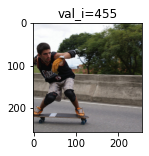

 46%|███████████████████                      | 456/982 [00:50<00:52, 10.07it/s]

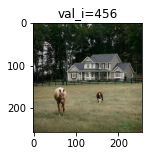

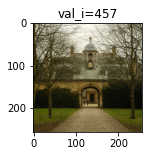

 47%|███████████████████                      | 458/982 [00:50<00:51, 10.20it/s]

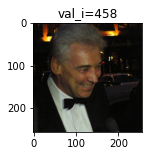

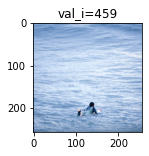

 47%|███████████████████▏                     | 460/982 [00:50<00:51, 10.08it/s]

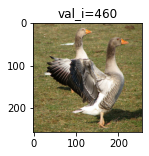

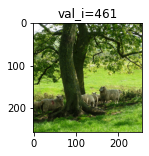

 47%|███████████████████▎                     | 462/982 [00:50<00:50, 10.30it/s]

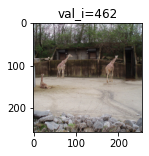

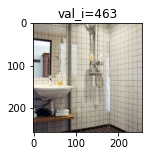

 47%|███████████████████▎                     | 464/982 [00:51<00:50, 10.27it/s]

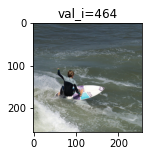

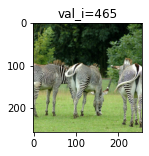

 47%|███████████████████▍                     | 466/982 [00:51<00:50, 10.31it/s]

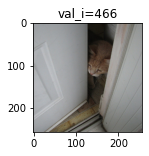

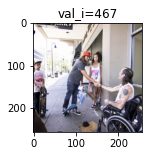

 48%|███████████████████▌                     | 468/982 [00:51<00:49, 10.31it/s]

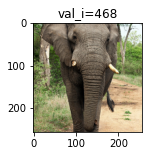

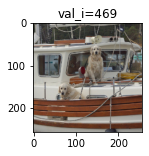

 48%|███████████████████▌                     | 470/982 [00:51<00:49, 10.39it/s]

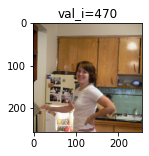

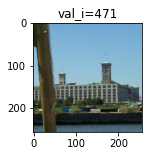

 48%|███████████████████▋                     | 472/982 [00:51<00:49, 10.33it/s]

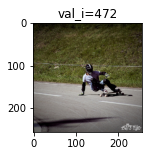

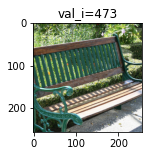

 48%|███████████████████▊                     | 474/982 [00:52<00:48, 10.39it/s]

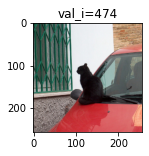

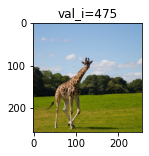

 48%|███████████████████▊                     | 476/982 [00:52<00:49, 10.20it/s]

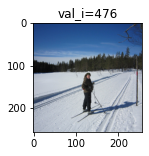

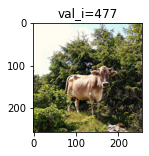

 49%|███████████████████▉                     | 478/982 [00:52<00:48, 10.34it/s]

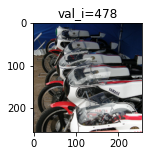

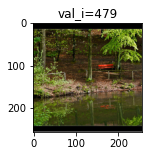

 49%|████████████████████                     | 480/982 [00:52<00:48, 10.35it/s]

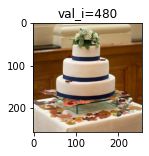

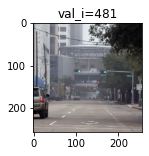

 49%|████████████████████                     | 482/982 [00:52<00:48, 10.33it/s]

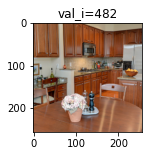

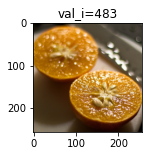

 49%|████████████████████▏                    | 484/982 [00:53<00:48, 10.29it/s]

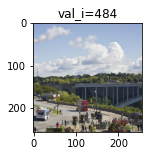

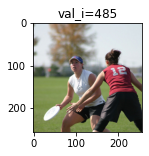

 49%|████████████████████▎                    | 486/982 [00:53<01:11,  6.90it/s]

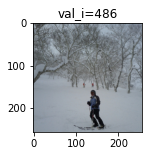

 50%|████████████████████▎                    | 487/982 [00:53<01:07,  7.29it/s]

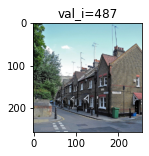

 50%|████████████████████▎                    | 488/982 [00:53<01:04,  7.68it/s]

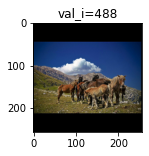

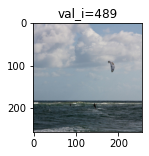

 50%|████████████████████▍                    | 490/982 [00:54<00:57,  8.53it/s]

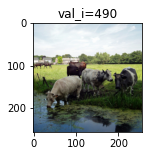

 50%|████████████████████▌                    | 491/982 [00:54<00:56,  8.73it/s]

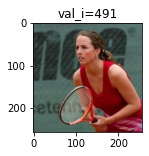

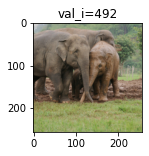

 50%|████████████████████▌                    | 493/982 [00:54<00:52,  9.25it/s]

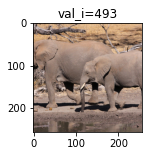

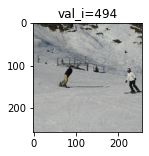

 50%|████████████████████▋                    | 495/982 [00:54<00:50,  9.63it/s]

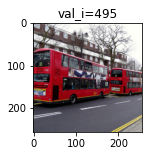

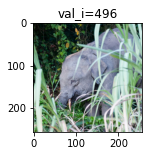

 51%|████████████████████▊                    | 497/982 [00:54<00:49,  9.72it/s]

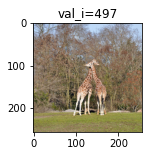

 51%|████████████████████▊                    | 498/982 [00:54<00:49,  9.77it/s]

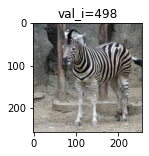

 51%|████████████████████▊                    | 499/982 [00:54<00:49,  9.74it/s]

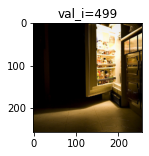

 51%|████████████████████▉                    | 500/982 [00:55<00:49,  9.69it/s]

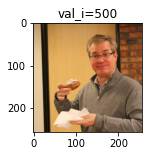

 51%|████████████████████▉                    | 501/982 [00:55<00:49,  9.66it/s]

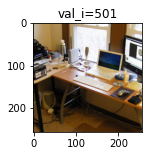

 51%|████████████████████▉                    | 502/982 [00:55<00:50,  9.60it/s]

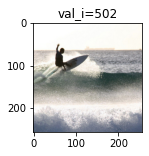

 51%|█████████████████████                    | 503/982 [00:55<00:49,  9.65it/s]

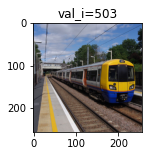

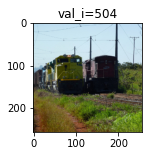

 51%|█████████████████████                    | 505/982 [00:55<00:47,  9.94it/s]

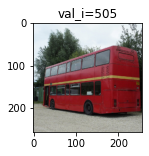

 52%|█████████████████████▏                   | 506/982 [00:55<00:48,  9.74it/s]

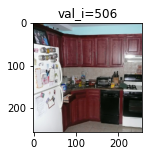

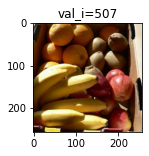

 52%|█████████████████████▏                   | 508/982 [00:55<00:48,  9.71it/s]

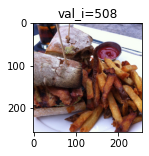

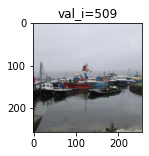

 52%|█████████████████████▎                   | 510/982 [00:56<00:48,  9.83it/s]

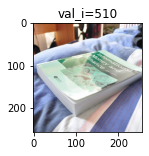

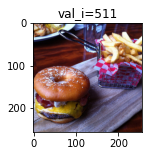

 52%|█████████████████████▍                   | 512/982 [00:56<00:47,  9.97it/s]

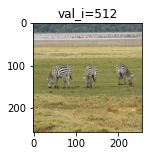

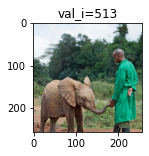

 52%|█████████████████████▍                   | 514/982 [00:56<00:46, 10.16it/s]

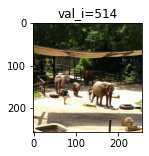

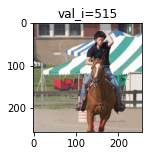

 53%|█████████████████████▌                   | 516/982 [00:56<00:45, 10.17it/s]

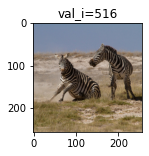

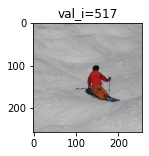

 53%|█████████████████████▋                   | 518/982 [00:56<00:45, 10.09it/s]

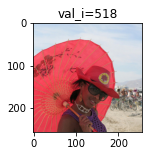

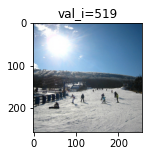

 53%|█████████████████████▋                   | 520/982 [00:57<00:45, 10.15it/s]

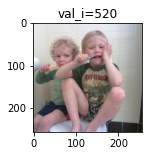

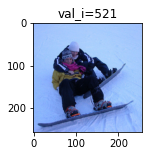

 53%|█████████████████████▊                   | 522/982 [00:57<00:45, 10.14it/s]

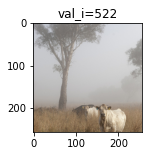

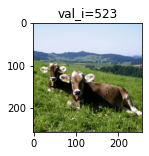

 53%|█████████████████████▉                   | 524/982 [00:57<00:45, 10.13it/s]

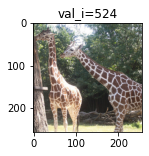

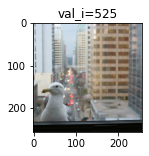

 54%|█████████████████████▉                   | 526/982 [00:57<00:44, 10.27it/s]

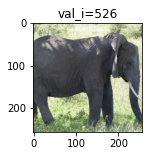

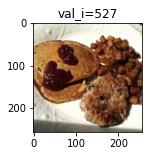

 54%|██████████████████████                   | 528/982 [00:57<00:44, 10.09it/s]

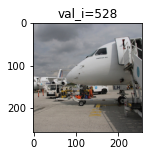

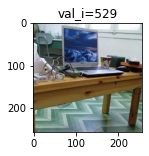

 54%|██████████████████████▏                  | 530/982 [00:58<00:44, 10.25it/s]

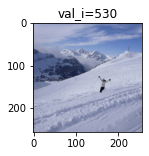

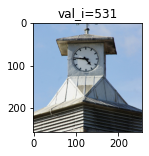

 54%|██████████████████████▏                  | 532/982 [00:58<00:44, 10.21it/s]

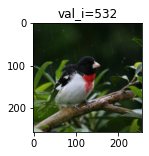

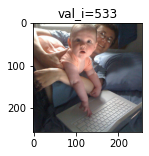

 54%|██████████████████████▎                  | 534/982 [00:58<00:43, 10.30it/s]

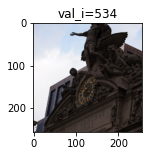

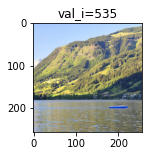

 55%|██████████████████████▍                  | 536/982 [00:58<01:07,  6.57it/s]

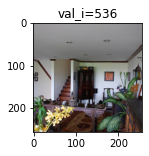

 55%|██████████████████████▍                  | 537/982 [00:59<01:04,  6.89it/s]

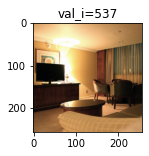

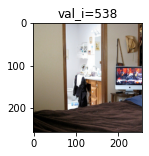

 55%|██████████████████████▌                  | 539/982 [00:59<00:58,  7.56it/s]

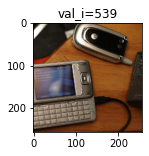

 55%|██████████████████████▌                  | 540/982 [00:59<00:56,  7.89it/s]

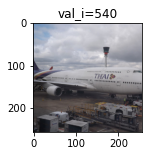

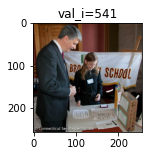

 55%|██████████████████████▋                  | 542/982 [00:59<00:50,  8.66it/s]

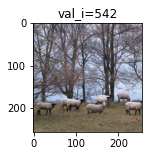

 55%|██████████████████████▋                  | 543/982 [00:59<00:49,  8.89it/s]

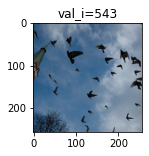

 55%|██████████████████████▋                  | 544/982 [00:59<00:48,  9.06it/s]

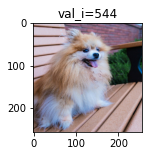

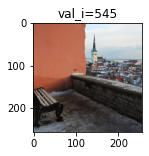

 56%|██████████████████████▊                  | 546/982 [00:59<00:45,  9.60it/s]

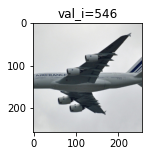

 56%|██████████████████████▊                  | 547/982 [01:00<00:45,  9.63it/s]

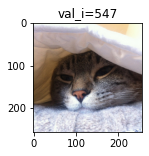

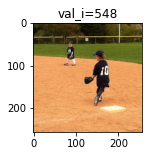

 56%|██████████████████████▉                  | 549/982 [01:00<00:43,  9.91it/s]

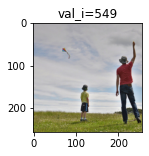

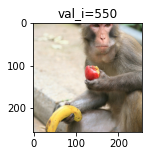

 56%|███████████████████████                  | 551/982 [01:00<00:43,  9.97it/s]

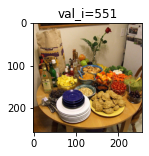

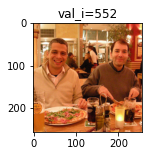

 56%|███████████████████████                  | 553/982 [01:00<00:41, 10.22it/s]

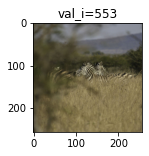

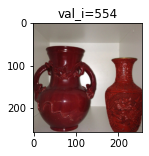

 57%|███████████████████████▏                 | 555/982 [01:00<00:41, 10.22it/s]

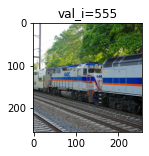

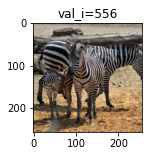

 57%|███████████████████████▎                 | 557/982 [01:01<00:41, 10.25it/s]

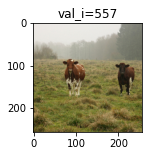

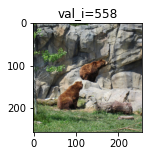

 57%|███████████████████████▎                 | 559/982 [01:01<00:41, 10.22it/s]

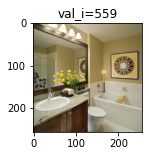

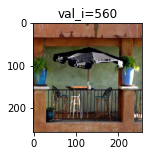

 57%|███████████████████████▍                 | 561/982 [01:01<00:40, 10.33it/s]

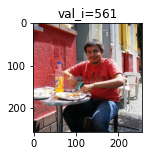

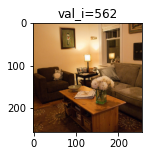

 57%|███████████████████████▌                 | 563/982 [01:01<00:40, 10.25it/s]

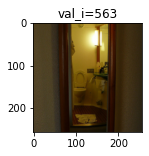

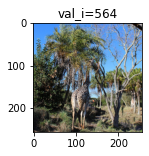

 58%|███████████████████████▌                 | 565/982 [01:01<00:40, 10.37it/s]

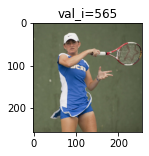

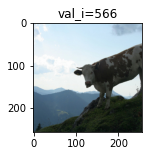

 58%|███████████████████████▋                 | 567/982 [01:02<00:40, 10.21it/s]

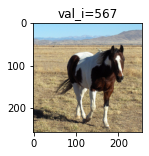

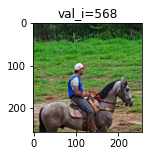

 58%|███████████████████████▊                 | 569/982 [01:02<00:39, 10.38it/s]

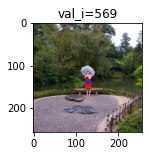

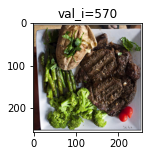

 58%|███████████████████████▊                 | 571/982 [01:02<00:39, 10.35it/s]

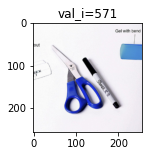

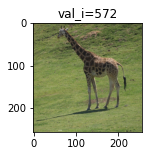

 58%|███████████████████████▉                 | 573/982 [01:02<00:39, 10.30it/s]

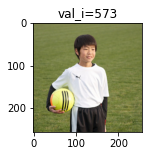

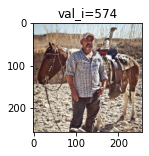

 59%|████████████████████████                 | 575/982 [01:02<00:39, 10.39it/s]

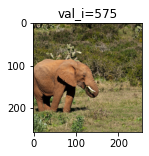

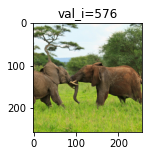

 59%|████████████████████████                 | 577/982 [01:02<00:39, 10.29it/s]

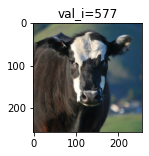

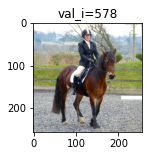

 59%|████████████████████████▏                | 579/982 [01:03<00:38, 10.37it/s]

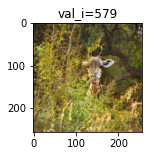

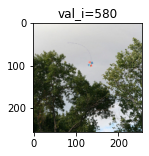

 59%|████████████████████████▎                | 581/982 [01:03<00:38, 10.35it/s]

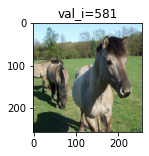

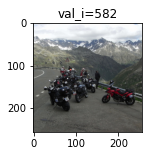

 59%|████████████████████████▎                | 583/982 [01:03<00:38, 10.40it/s]

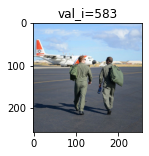

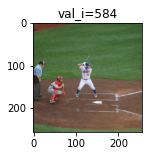

 60%|████████████████████████▍                | 585/982 [01:03<00:38, 10.29it/s]

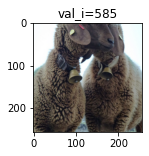

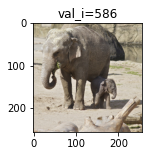

 60%|████████████████████████▌                | 587/982 [01:04<00:58,  6.81it/s]

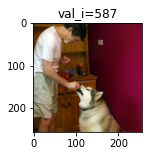

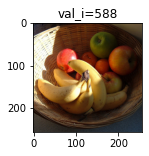

 60%|████████████████████████▌                | 589/982 [01:04<00:52,  7.46it/s]

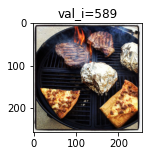

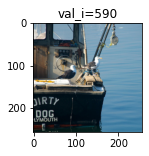

 60%|████████████████████████▋                | 591/982 [01:04<00:47,  8.20it/s]

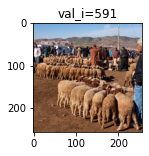

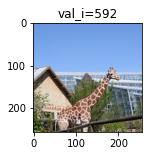

 60%|████████████████████████▊                | 593/982 [01:04<00:44,  8.71it/s]

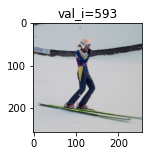

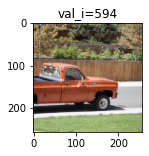

 61%|████████████████████████▊                | 595/982 [01:05<00:41,  9.23it/s]

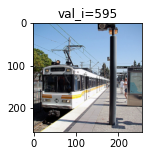

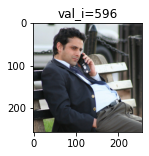

 61%|████████████████████████▉                | 597/982 [01:05<00:40,  9.47it/s]

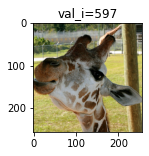

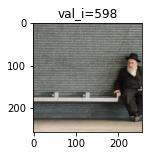

 61%|█████████████████████████                | 599/982 [01:05<00:38,  9.82it/s]

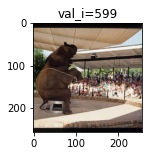

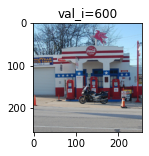

 61%|█████████████████████████                | 601/982 [01:05<00:38,  9.86it/s]

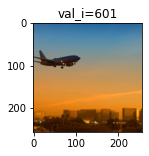

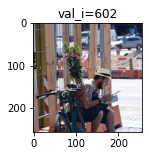

 61%|█████████████████████████▏               | 603/982 [01:05<00:37, 10.08it/s]

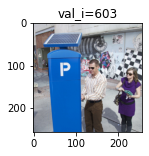

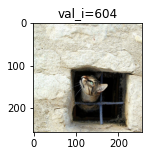

 62%|█████████████████████████▎               | 605/982 [01:06<00:37, 10.04it/s]

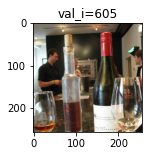

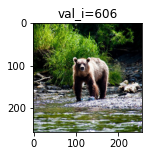

 62%|█████████████████████████▎               | 607/982 [01:06<00:36, 10.27it/s]

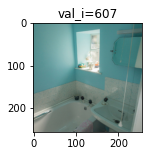

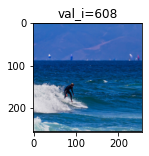

 62%|█████████████████████████▍               | 609/982 [01:06<00:36, 10.08it/s]

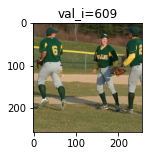

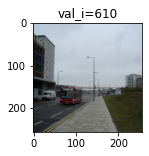

 62%|█████████████████████████▌               | 611/982 [01:06<00:36, 10.21it/s]

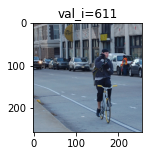

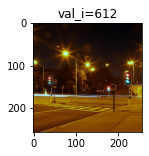

 62%|█████████████████████████▌               | 613/982 [01:06<00:36, 10.12it/s]

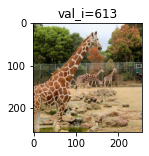

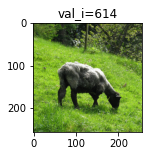

 63%|█████████████████████████▋               | 615/982 [01:06<00:35, 10.31it/s]

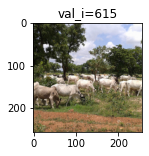

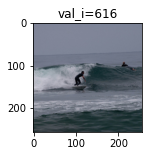

 63%|█████████████████████████▊               | 617/982 [01:07<00:35, 10.29it/s]

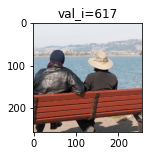

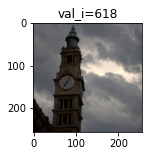

 63%|█████████████████████████▊               | 619/982 [01:07<00:35, 10.37it/s]

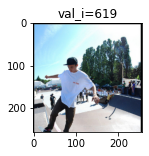

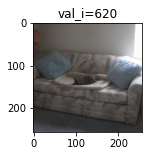

 63%|█████████████████████████▉               | 621/982 [01:07<00:35, 10.12it/s]

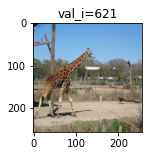

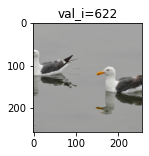

 63%|██████████████████████████               | 623/982 [01:07<00:35, 10.05it/s]

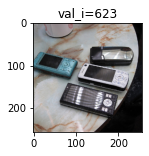

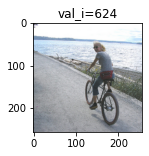

 64%|██████████████████████████               | 625/982 [01:07<00:34, 10.27it/s]

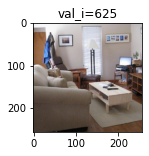

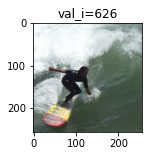

 64%|██████████████████████████▏              | 627/982 [01:08<00:34, 10.20it/s]

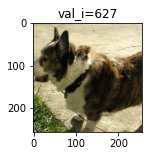

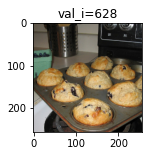

 64%|██████████████████████████▎              | 629/982 [01:08<00:34, 10.37it/s]

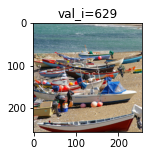

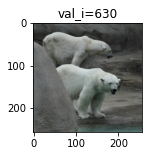

 64%|██████████████████████████▎              | 631/982 [01:08<00:34, 10.26it/s]

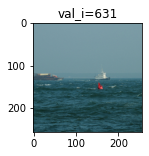

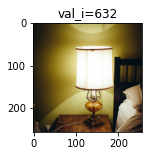

 64%|██████████████████████████▍              | 633/982 [01:08<00:33, 10.36it/s]

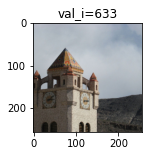

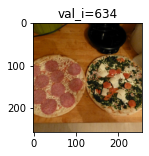

 65%|██████████████████████████▌              | 635/982 [01:08<00:34, 10.11it/s]

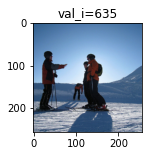

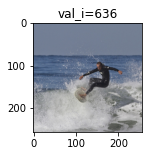

 65%|██████████████████████████▌              | 637/982 [01:09<00:33, 10.30it/s]

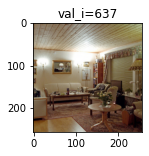

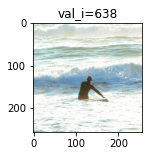

 65%|██████████████████████████▋              | 639/982 [01:09<00:51,  6.70it/s]

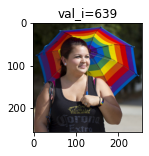

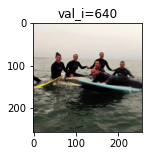

 65%|██████████████████████████▊              | 641/982 [01:09<00:45,  7.50it/s]

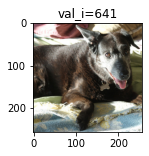

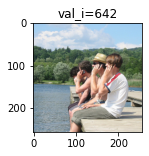

 65%|██████████████████████████▊              | 643/982 [01:10<00:41,  8.14it/s]

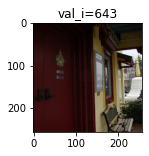

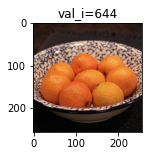

 66%|██████████████████████████▉              | 645/982 [01:10<00:38,  8.77it/s]

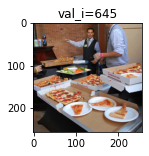

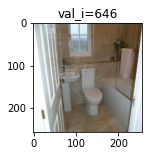

 66%|███████████████████████████              | 647/982 [01:10<00:36,  9.18it/s]

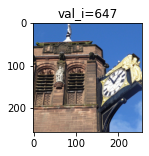

 66%|███████████████████████████              | 648/982 [01:10<00:35,  9.29it/s]

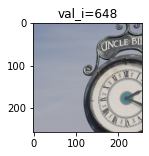

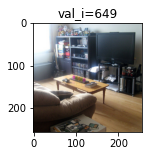

 66%|███████████████████████████▏             | 650/982 [01:10<00:34,  9.53it/s]

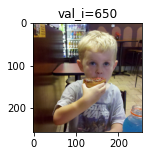

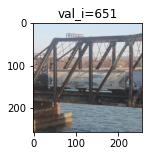

 66%|███████████████████████████▏             | 652/982 [01:10<00:33,  9.85it/s]

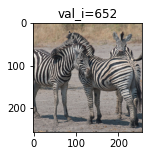

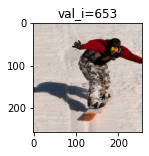

 67%|███████████████████████████▎             | 654/982 [01:11<00:32,  9.94it/s]

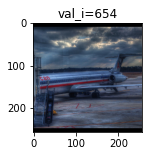

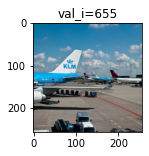

 67%|███████████████████████████▍             | 656/982 [01:11<00:31, 10.19it/s]

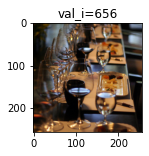

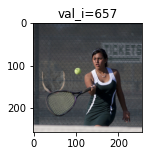

 67%|███████████████████████████▍             | 658/982 [01:11<00:32, 10.08it/s]

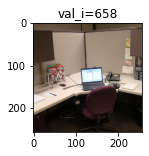

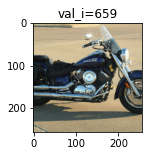

 67%|███████████████████████████▌             | 660/982 [01:11<00:31, 10.12it/s]

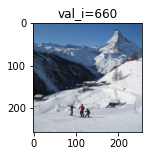

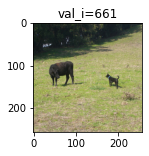

 67%|███████████████████████████▋             | 662/982 [01:11<00:32,  9.98it/s]

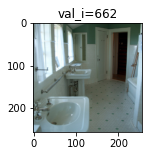

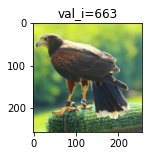

 68%|███████████████████████████▋             | 664/982 [01:12<00:31, 10.09it/s]

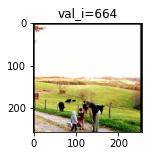

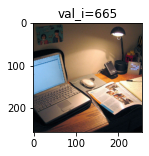

 68%|███████████████████████████▊             | 666/982 [01:12<00:31, 10.16it/s]

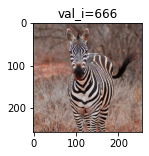

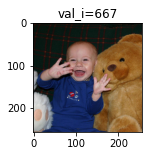

 68%|███████████████████████████▉             | 668/982 [01:12<00:30, 10.26it/s]

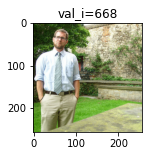

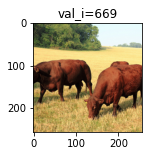

 68%|███████████████████████████▉             | 670/982 [01:12<00:30, 10.24it/s]

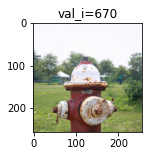

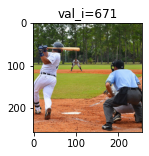

 68%|████████████████████████████             | 672/982 [01:12<00:30, 10.26it/s]

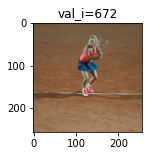

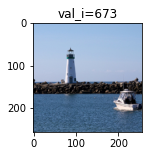

 69%|████████████████████████████▏            | 674/982 [01:13<00:30, 10.16it/s]

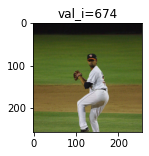

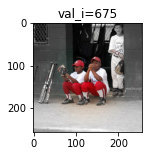

 69%|████████████████████████████▏            | 676/982 [01:13<00:29, 10.33it/s]

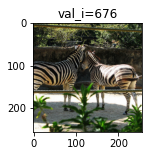

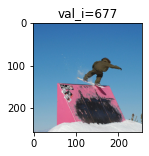

 69%|████████████████████████████▎            | 678/982 [01:13<00:29, 10.28it/s]

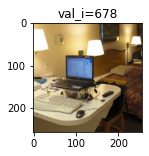

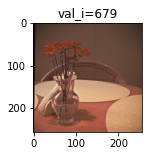

 69%|████████████████████████████▍            | 680/982 [01:13<00:29, 10.36it/s]

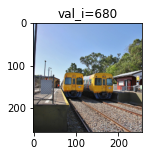

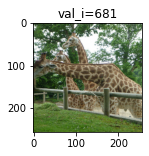

 69%|████████████████████████████▍            | 682/982 [01:13<00:29, 10.31it/s]

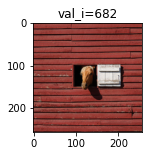

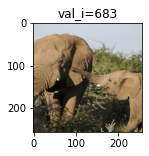

 70%|████████████████████████████▌            | 684/982 [01:14<00:28, 10.32it/s]

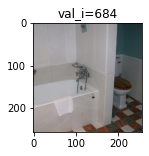

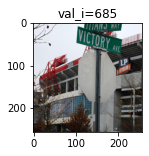

 70%|████████████████████████████▋            | 686/982 [01:14<00:28, 10.27it/s]

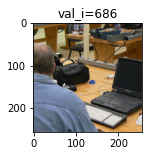

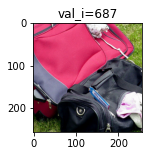

 70%|████████████████████████████▋            | 688/982 [01:14<00:28, 10.29it/s]

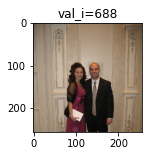

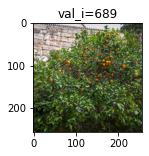

 70%|████████████████████████████▊            | 690/982 [01:15<00:44,  6.60it/s]

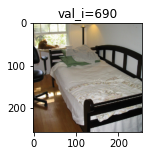

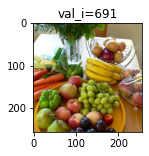

 70%|████████████████████████████▉            | 692/982 [01:15<00:38,  7.44it/s]

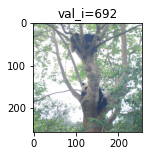

 71%|████████████████████████████▉            | 693/982 [01:15<00:37,  7.77it/s]

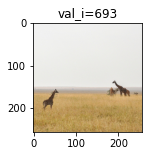

 71%|████████████████████████████▉            | 694/982 [01:15<00:35,  8.08it/s]

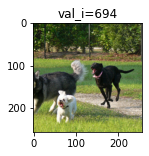

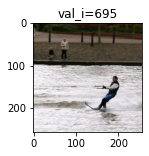

 71%|█████████████████████████████            | 696/982 [01:15<00:33,  8.55it/s]

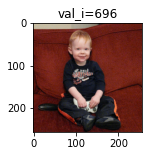

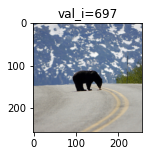

 71%|█████████████████████████████▏           | 698/982 [01:15<00:31,  8.98it/s]

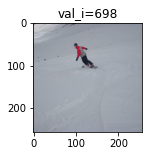

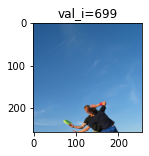

 71%|█████████████████████████████▏           | 700/982 [01:16<00:30,  9.25it/s]

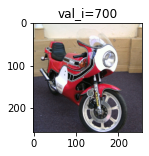

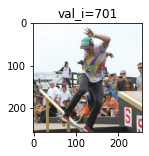

 71%|█████████████████████████████▎           | 702/982 [01:16<00:28,  9.66it/s]

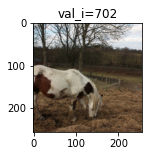

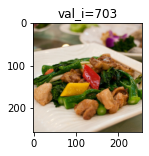

 72%|█████████████████████████████▍           | 704/982 [01:16<00:28,  9.74it/s]

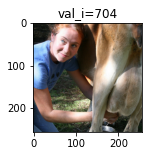

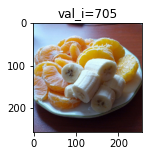

 72%|█████████████████████████████▍           | 706/982 [01:16<00:27, 10.00it/s]

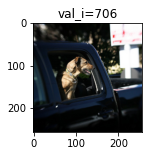

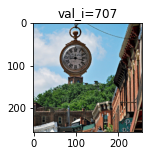

 72%|█████████████████████████████▌           | 708/982 [01:16<00:27, 10.03it/s]

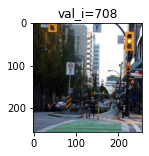

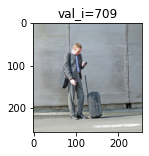

 72%|█████████████████████████████▋           | 710/982 [01:16<00:26, 10.29it/s]

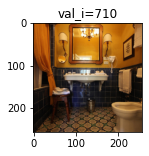

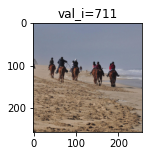

 73%|█████████████████████████████▋           | 712/982 [01:17<00:26, 10.23it/s]

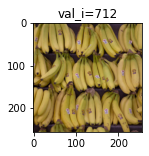

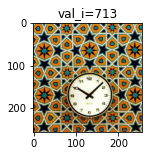

 73%|█████████████████████████████▊           | 714/982 [01:17<00:25, 10.32it/s]

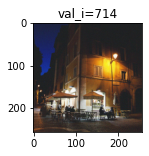

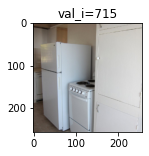

 73%|█████████████████████████████▉           | 716/982 [01:17<00:25, 10.34it/s]

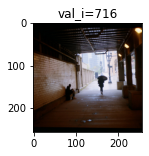

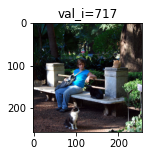

 73%|█████████████████████████████▉           | 718/982 [01:17<00:25, 10.34it/s]

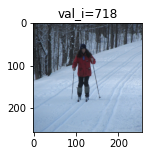

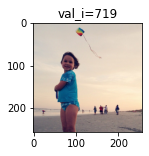

 73%|██████████████████████████████           | 720/982 [01:17<00:25, 10.21it/s]

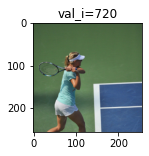

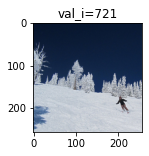

 74%|██████████████████████████████▏          | 722/982 [01:18<00:25, 10.17it/s]

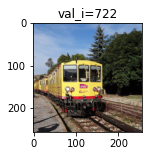

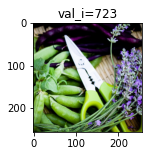

 74%|██████████████████████████████▏          | 724/982 [01:18<00:25, 10.09it/s]

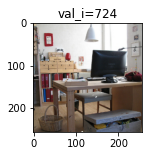

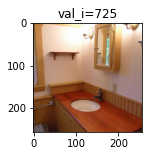

 74%|██████████████████████████████▎          | 726/982 [01:18<00:24, 10.25it/s]

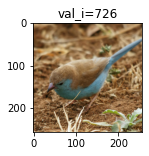

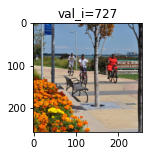

 74%|██████████████████████████████▍          | 728/982 [01:18<00:24, 10.22it/s]

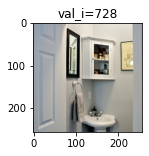

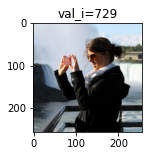

 74%|██████████████████████████████▍          | 730/982 [01:18<00:24, 10.29it/s]

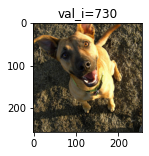

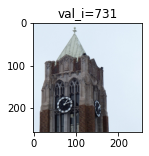

 75%|██████████████████████████████▌          | 732/982 [01:19<00:24, 10.17it/s]

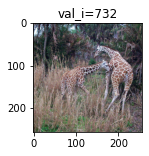

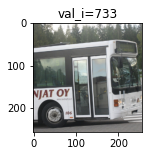

 75%|██████████████████████████████▋          | 734/982 [01:19<00:24, 10.10it/s]

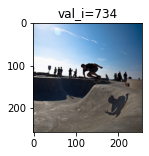

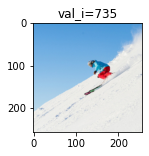

 75%|██████████████████████████████▋          | 736/982 [01:19<00:26,  9.26it/s]

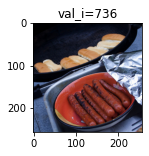

 75%|██████████████████████████████▊          | 737/982 [01:19<00:28,  8.65it/s]

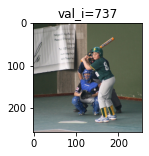

 75%|██████████████████████████████▊          | 738/982 [01:19<00:29,  8.32it/s]

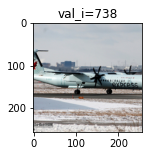

 75%|██████████████████████████████▊          | 739/982 [01:20<00:31,  7.79it/s]

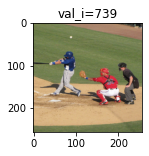

 75%|██████████████████████████████▉          | 740/982 [01:20<00:57,  4.17it/s]

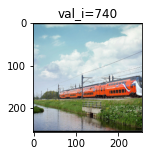

 75%|██████████████████████████████▉          | 741/982 [01:20<00:51,  4.70it/s]

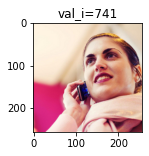

 76%|██████████████████████████████▉          | 742/982 [01:20<00:46,  5.21it/s]

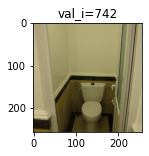

 76%|███████████████████████████████          | 743/982 [01:21<00:42,  5.59it/s]

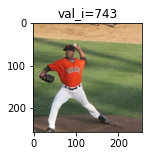

 76%|███████████████████████████████          | 744/982 [01:21<00:38,  6.20it/s]

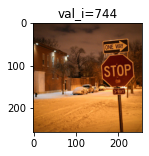

 76%|███████████████████████████████          | 745/982 [01:21<00:35,  6.72it/s]

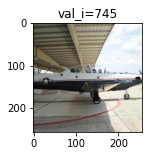

 76%|███████████████████████████████▏         | 746/982 [01:21<00:33,  7.06it/s]

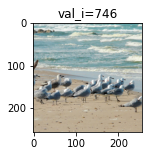

 76%|███████████████████████████████▏         | 747/982 [01:21<00:31,  7.48it/s]

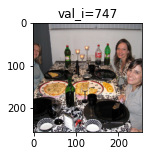

 76%|███████████████████████████████▏         | 748/982 [01:21<00:29,  7.85it/s]

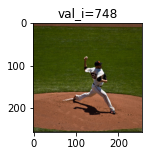

 76%|███████████████████████████████▎         | 749/982 [01:21<00:28,  8.09it/s]

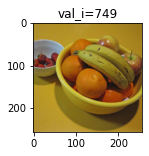

 76%|███████████████████████████████▎         | 750/982 [01:21<00:29,  7.83it/s]

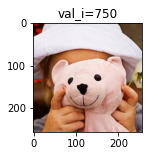

 76%|███████████████████████████████▎         | 751/982 [01:22<00:29,  7.91it/s]

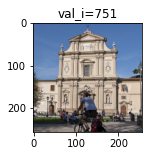

 77%|███████████████████████████████▍         | 752/982 [01:22<00:28,  8.09it/s]

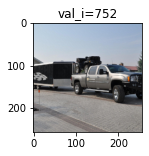

 77%|███████████████████████████████▍         | 753/982 [01:22<00:27,  8.41it/s]

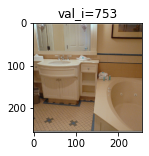

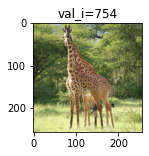

 77%|███████████████████████████████▌         | 755/982 [01:22<00:24,  9.37it/s]

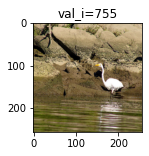

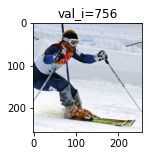

 77%|███████████████████████████████▌         | 757/982 [01:22<00:23,  9.78it/s]

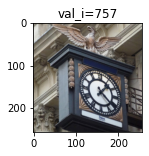

 77%|███████████████████████████████▋         | 758/982 [01:22<00:22,  9.80it/s]

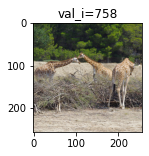

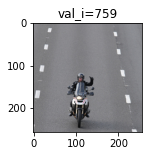

 77%|███████████████████████████████▋         | 760/982 [01:22<00:22,  9.92it/s]

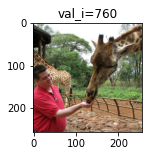

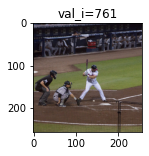

 78%|███████████████████████████████▊         | 762/982 [01:23<00:22,  9.97it/s]

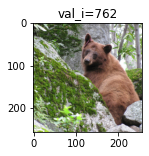

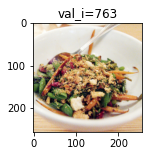

 78%|███████████████████████████████▉         | 764/982 [01:23<00:21, 10.18it/s]

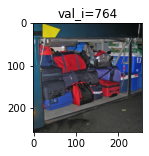

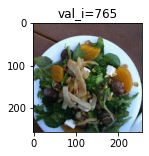

 78%|███████████████████████████████▉         | 766/982 [01:23<00:21, 10.05it/s]

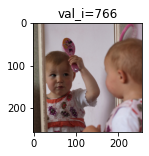

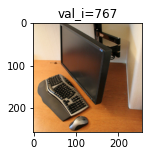

 78%|████████████████████████████████         | 768/982 [01:23<00:20, 10.21it/s]

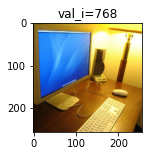

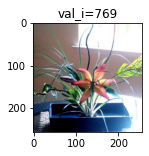

 78%|████████████████████████████████▏        | 770/982 [01:23<00:20, 10.18it/s]

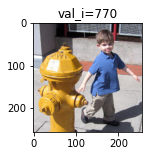

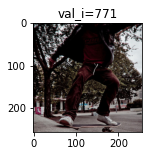

 79%|████████████████████████████████▏        | 772/982 [01:24<00:20, 10.35it/s]

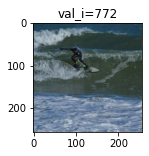

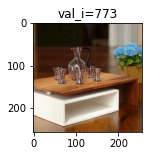

 79%|████████████████████████████████▎        | 774/982 [01:24<00:20, 10.28it/s]

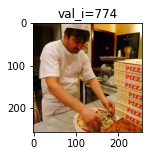

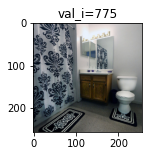

 79%|████████████████████████████████▍        | 776/982 [01:24<00:19, 10.37it/s]

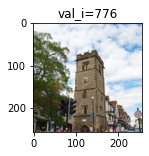

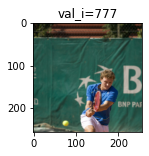

 79%|████████████████████████████████▍        | 778/982 [01:24<00:19, 10.29it/s]

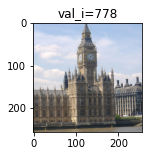

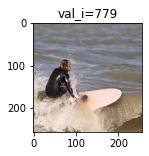

 79%|████████████████████████████████▌        | 780/982 [01:24<00:19, 10.25it/s]

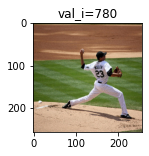

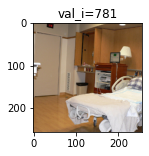

 80%|████████████████████████████████▋        | 782/982 [01:25<00:20,  9.56it/s]

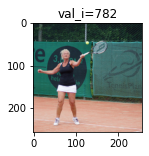

 80%|████████████████████████████████▋        | 783/982 [01:25<00:20,  9.62it/s]

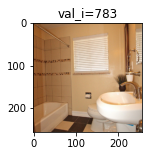

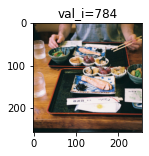

 80%|████████████████████████████████▊        | 785/982 [01:25<00:20,  9.48it/s]

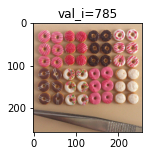

 80%|████████████████████████████████▊        | 786/982 [01:25<00:20,  9.57it/s]

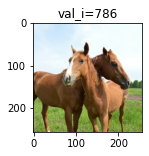

 80%|████████████████████████████████▊        | 787/982 [01:25<00:20,  9.62it/s]

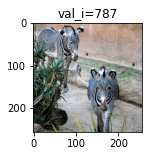

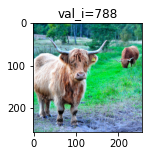

 80%|████████████████████████████████▉        | 789/982 [01:25<00:19,  9.73it/s]

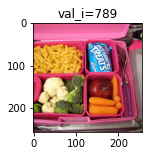

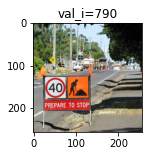

 81%|█████████████████████████████████        | 791/982 [01:26<00:32,  5.80it/s]

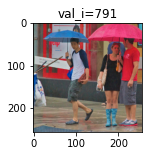

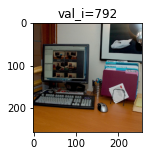

 81%|█████████████████████████████████        | 793/982 [01:26<00:28,  6.73it/s]

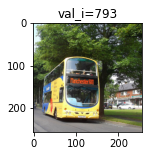

 81%|█████████████████████████████████▏       | 794/982 [01:26<00:26,  7.17it/s]

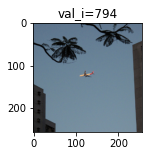

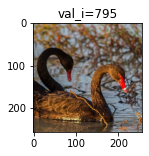

 81%|█████████████████████████████████▏       | 796/982 [01:26<00:23,  7.99it/s]

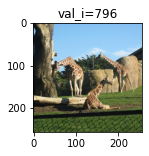

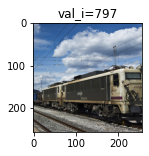

 81%|█████████████████████████████████▎       | 798/982 [01:27<00:21,  8.69it/s]

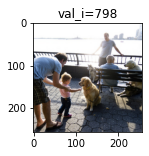

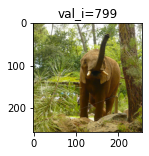

 81%|█████████████████████████████████▍       | 800/982 [01:27<00:20,  9.04it/s]

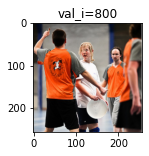

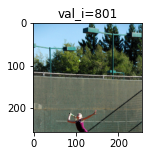

 82%|█████████████████████████████████▍       | 802/982 [01:27<00:18,  9.52it/s]

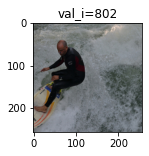

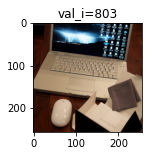

 82%|█████████████████████████████████▌       | 804/982 [01:27<00:18,  9.73it/s]

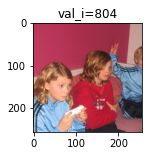

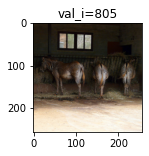

 82%|█████████████████████████████████▋       | 806/982 [01:27<00:17, 10.00it/s]

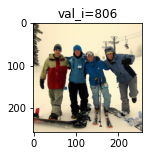

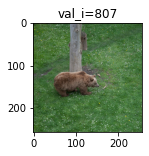

 82%|█████████████████████████████████▋       | 808/982 [01:28<00:17,  9.91it/s]

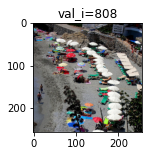

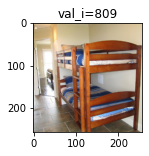

 82%|█████████████████████████████████▊       | 810/982 [01:28<00:17,  9.87it/s]

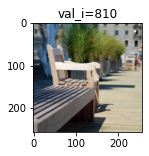

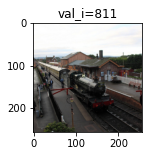

 83%|█████████████████████████████████▉       | 812/982 [01:28<00:17,  9.88it/s]

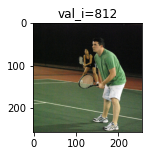

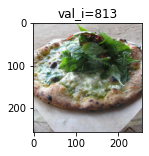

 83%|█████████████████████████████████▉       | 814/982 [01:28<00:16, 10.09it/s]

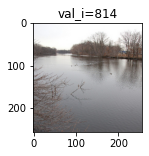

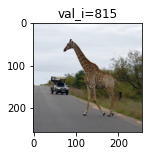

 83%|██████████████████████████████████       | 816/982 [01:28<00:16, 10.12it/s]

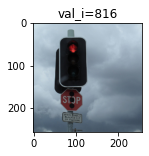

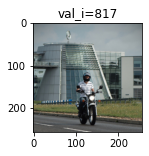

 83%|██████████████████████████████████▏      | 818/982 [01:29<00:15, 10.28it/s]

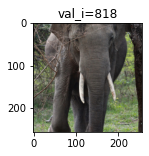

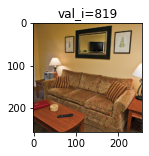

 84%|██████████████████████████████████▏      | 820/982 [01:29<00:15, 10.28it/s]

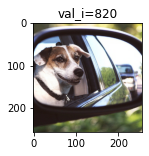

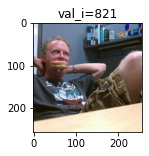

 84%|██████████████████████████████████▎      | 822/982 [01:29<00:15, 10.44it/s]

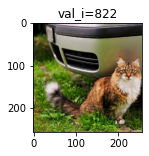

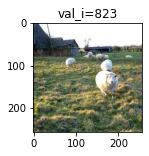

 84%|██████████████████████████████████▍      | 824/982 [01:29<00:15, 10.34it/s]

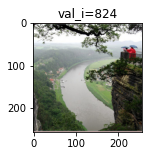

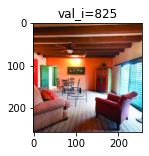

 84%|██████████████████████████████████▍      | 826/982 [01:29<00:14, 10.80it/s]

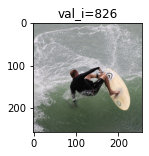

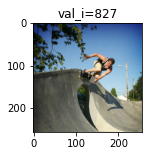

 84%|██████████████████████████████████▌      | 828/982 [01:30<00:14, 10.45it/s]

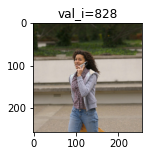

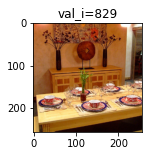

 85%|██████████████████████████████████▋      | 830/982 [01:30<00:14, 10.26it/s]

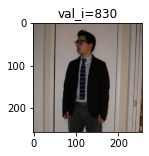

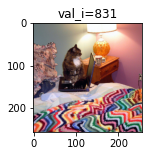

 85%|██████████████████████████████████▋      | 832/982 [01:30<00:14, 10.21it/s]

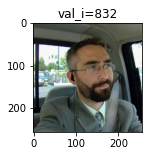

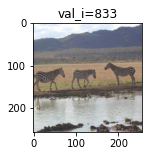

 85%|██████████████████████████████████▊      | 834/982 [01:30<00:14,  9.96it/s]

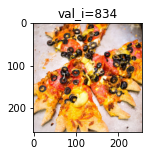

 85%|██████████████████████████████████▊      | 835/982 [01:30<00:14,  9.80it/s]

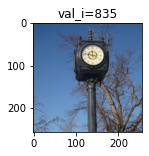

 85%|██████████████████████████████████▉      | 836/982 [01:30<00:14,  9.83it/s]

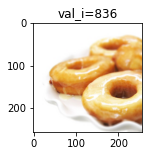

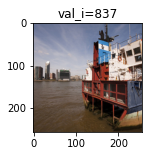

 85%|██████████████████████████████████▉      | 838/982 [01:31<00:14, 10.05it/s]

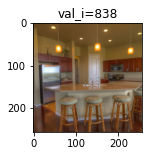

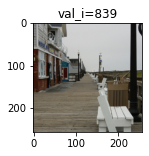

 86%|███████████████████████████████████      | 840/982 [01:31<00:14, 10.01it/s]

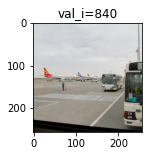

 86%|███████████████████████████████████      | 841/982 [01:31<00:14, 10.00it/s]

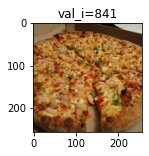

 86%|███████████████████████████████████▏     | 842/982 [01:31<00:26,  5.33it/s]

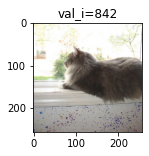

 86%|███████████████████████████████████▏     | 843/982 [01:31<00:23,  5.99it/s]

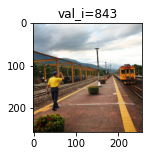

 86%|███████████████████████████████████▏     | 844/982 [01:32<00:20,  6.63it/s]

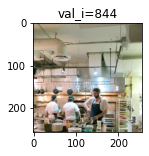

 86%|███████████████████████████████████▎     | 845/982 [01:32<00:18,  7.28it/s]

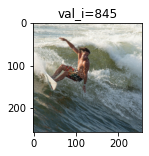

 86%|███████████████████████████████████▎     | 846/982 [01:32<00:17,  7.77it/s]

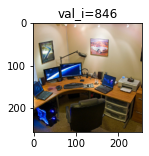

 86%|███████████████████████████████████▎     | 847/982 [01:32<00:16,  8.27it/s]

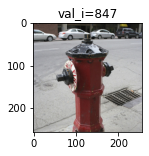

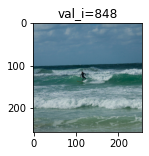

 86%|███████████████████████████████████▍     | 849/982 [01:32<00:14,  9.07it/s]

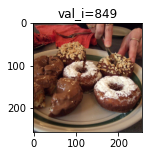

 87%|███████████████████████████████████▍     | 850/982 [01:32<00:14,  9.20it/s]

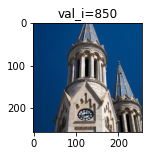

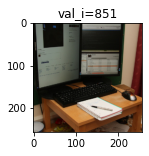

 87%|███████████████████████████████████▌     | 852/982 [01:32<00:13,  9.57it/s]

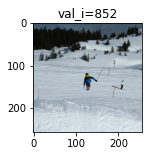

 87%|███████████████████████████████████▌     | 853/982 [01:32<00:13,  9.62it/s]

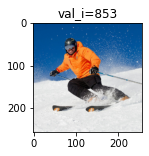

 87%|███████████████████████████████████▋     | 854/982 [01:33<00:13,  9.64it/s]

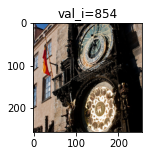

 87%|███████████████████████████████████▋     | 855/982 [01:33<00:13,  9.55it/s]

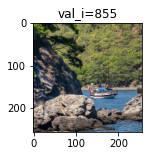

 87%|███████████████████████████████████▋     | 856/982 [01:33<00:13,  9.58it/s]

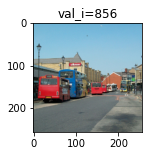

 87%|███████████████████████████████████▊     | 857/982 [01:33<00:12,  9.62it/s]

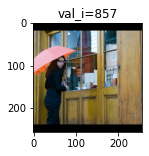

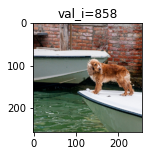

 87%|███████████████████████████████████▊     | 859/982 [01:33<00:12, 10.11it/s]

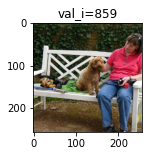

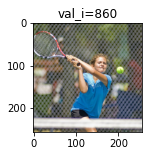

 88%|███████████████████████████████████▉     | 861/982 [01:33<00:11, 10.30it/s]

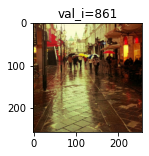

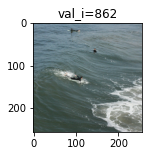

 88%|████████████████████████████████████     | 863/982 [01:33<00:11, 10.19it/s]

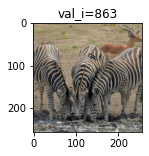

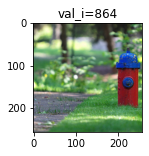

 88%|████████████████████████████████████     | 865/982 [01:34<00:11, 10.41it/s]

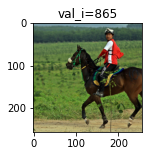

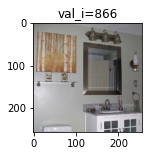

 88%|████████████████████████████████████▏    | 867/982 [01:34<00:11, 10.18it/s]

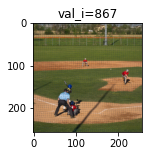

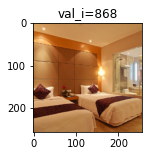

 88%|████████████████████████████████████▎    | 869/982 [01:34<00:12,  9.16it/s]

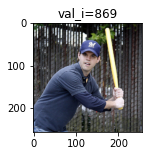

 89%|████████████████████████████████████▎    | 870/982 [01:34<00:12,  9.08it/s]

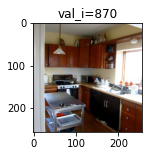

 89%|████████████████████████████████████▎    | 871/982 [01:34<00:12,  9.00it/s]

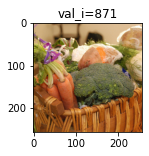

 89%|████████████████████████████████████▍    | 872/982 [01:34<00:12,  8.96it/s]

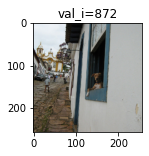

 89%|████████████████████████████████████▍    | 873/982 [01:35<00:12,  8.69it/s]

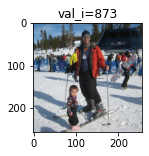

 89%|████████████████████████████████████▍    | 874/982 [01:35<00:12,  8.61it/s]

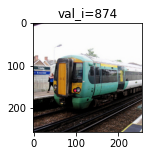

 89%|████████████████████████████████████▌    | 875/982 [01:35<00:12,  8.65it/s]

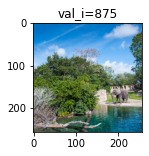

 89%|████████████████████████████████████▌    | 876/982 [01:35<00:13,  8.08it/s]

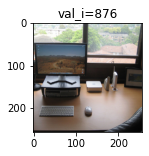

 89%|████████████████████████████████████▌    | 877/982 [01:35<00:13,  8.03it/s]

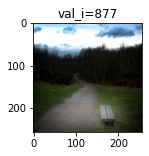

 89%|████████████████████████████████████▋    | 878/982 [01:35<00:12,  8.21it/s]

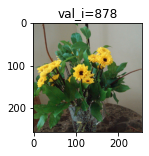

 90%|████████████████████████████████████▋    | 879/982 [01:35<00:13,  7.57it/s]

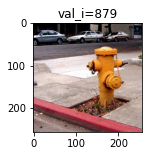

 90%|████████████████████████████████████▋    | 880/982 [01:35<00:12,  7.88it/s]

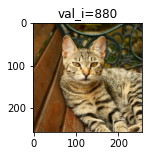

 90%|████████████████████████████████████▊    | 881/982 [01:36<00:12,  7.95it/s]

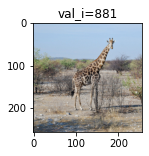

 90%|████████████████████████████████████▊    | 882/982 [01:36<00:12,  8.20it/s]

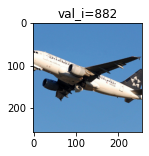

 90%|████████████████████████████████████▊    | 883/982 [01:36<00:11,  8.31it/s]

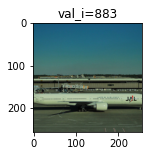

 90%|████████████████████████████████████▉    | 884/982 [01:36<00:11,  8.44it/s]

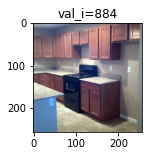

 90%|████████████████████████████████████▉    | 885/982 [01:36<00:11,  8.30it/s]

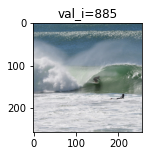

 90%|████████████████████████████████████▉    | 886/982 [01:36<00:11,  8.46it/s]

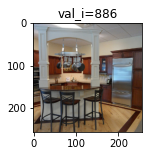

 90%|█████████████████████████████████████    | 887/982 [01:36<00:11,  8.60it/s]

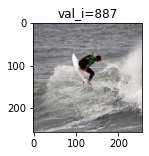

 90%|█████████████████████████████████████    | 888/982 [01:36<00:10,  8.70it/s]

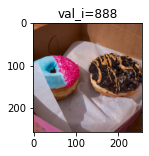

 91%|█████████████████████████████████████    | 889/982 [01:36<00:10,  8.52it/s]

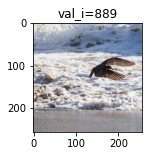

 91%|█████████████████████████████████████▏   | 890/982 [01:37<00:10,  8.65it/s]

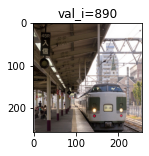

 91%|█████████████████████████████████████▏   | 891/982 [01:37<00:10,  8.70it/s]

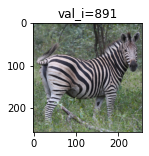

 91%|█████████████████████████████████████▏   | 892/982 [01:37<00:10,  8.53it/s]

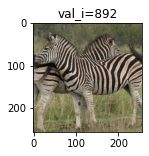

 91%|█████████████████████████████████████▎   | 893/982 [01:37<00:23,  3.79it/s]

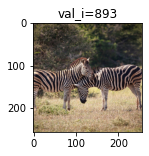

 91%|█████████████████████████████████████▎   | 894/982 [01:38<00:19,  4.58it/s]

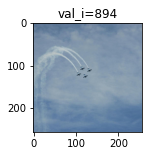

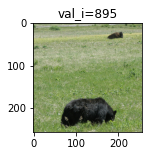

 91%|█████████████████████████████████████▍   | 896/982 [01:38<00:13,  6.32it/s]

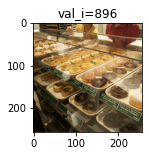

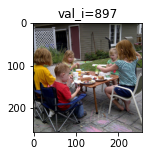

 91%|█████████████████████████████████████▍   | 898/982 [01:38<00:11,  7.52it/s]

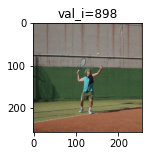

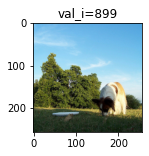

 92%|█████████████████████████████████████▌   | 900/982 [01:38<00:09,  8.27it/s]

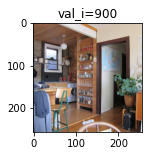

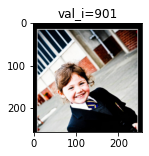

 92%|█████████████████████████████████████▋   | 902/982 [01:38<00:08,  9.01it/s]

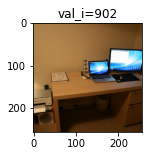

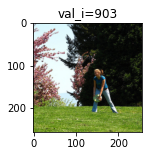

 92%|█████████████████████████████████████▋   | 904/982 [01:39<00:08,  9.37it/s]

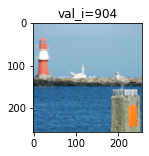

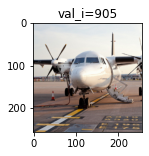

 92%|█████████████████████████████████████▊   | 906/982 [01:39<00:07,  9.74it/s]

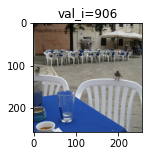

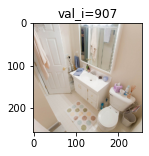

 92%|█████████████████████████████████████▉   | 908/982 [01:39<00:07,  9.90it/s]

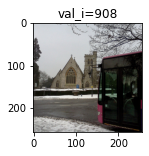

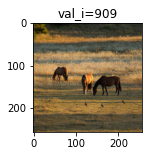

 93%|█████████████████████████████████████▉   | 910/982 [01:39<00:07, 10.25it/s]

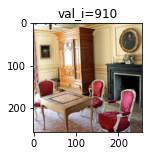

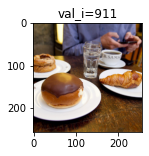

 93%|██████████████████████████████████████   | 912/982 [01:39<00:06, 10.27it/s]

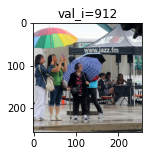

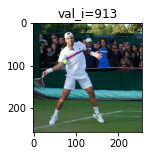

 93%|██████████████████████████████████████▏  | 914/982 [01:39<00:06, 10.19it/s]

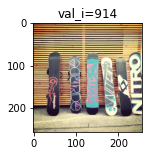

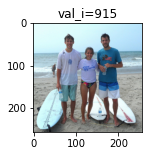

 93%|██████████████████████████████████████▏  | 916/982 [01:40<00:06, 10.11it/s]

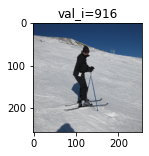

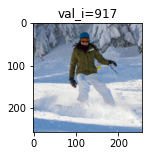

 93%|██████████████████████████████████████▎  | 918/982 [01:40<00:06,  9.32it/s]

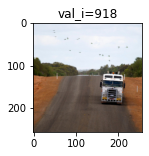

 94%|██████████████████████████████████████▎  | 919/982 [01:40<00:07,  8.76it/s]

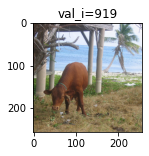

 94%|██████████████████████████████████████▍  | 920/982 [01:40<00:07,  8.32it/s]

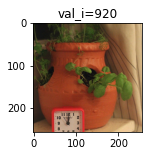

 94%|██████████████████████████████████████▍  | 921/982 [01:40<00:07,  8.29it/s]

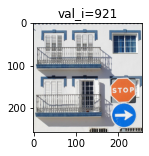

 94%|██████████████████████████████████████▍  | 922/982 [01:40<00:06,  8.64it/s]

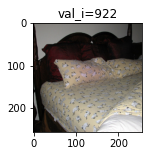

 94%|██████████████████████████████████████▌  | 923/982 [01:41<00:06,  8.65it/s]

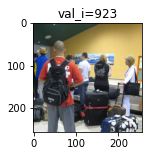

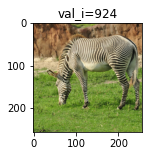

 94%|██████████████████████████████████████▌  | 925/982 [01:41<00:06,  9.49it/s]

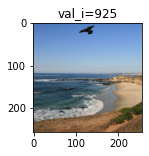

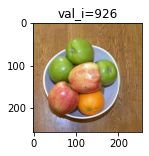

 94%|██████████████████████████████████████▋  | 927/982 [01:41<00:05,  9.79it/s]

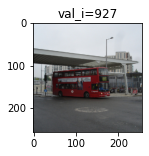

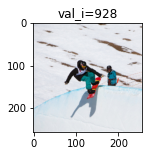

 95%|██████████████████████████████████████▊  | 929/982 [01:41<00:05, 10.13it/s]

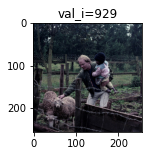

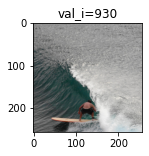

 95%|██████████████████████████████████████▊  | 931/982 [01:41<00:05,  9.97it/s]

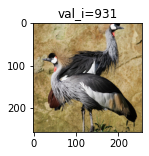

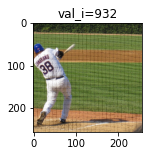

 95%|██████████████████████████████████████▉  | 933/982 [01:41<00:04, 10.26it/s]

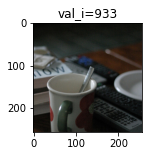

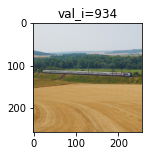

 95%|███████████████████████████████████████  | 935/982 [01:42<00:04, 10.25it/s]

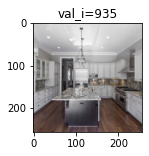

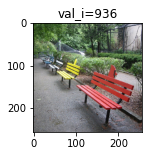

 95%|███████████████████████████████████████  | 937/982 [01:42<00:04, 10.46it/s]

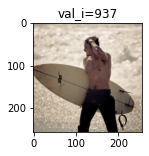

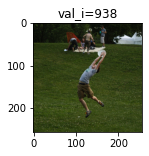

 96%|███████████████████████████████████████▏ | 939/982 [01:42<00:04, 10.29it/s]

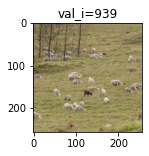

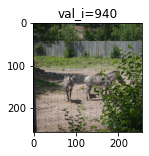

 96%|███████████████████████████████████████▎ | 941/982 [01:42<00:04, 10.09it/s]

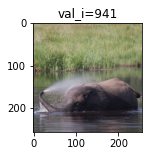

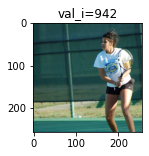

 96%|███████████████████████████████████████▎ | 943/982 [01:42<00:03, 10.20it/s]

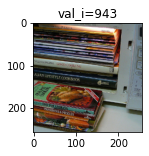

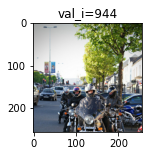

 96%|███████████████████████████████████████▍ | 945/982 [01:43<00:05,  6.73it/s]

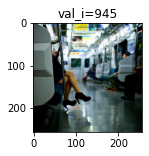

 96%|███████████████████████████████████████▍ | 946/982 [01:43<00:05,  7.11it/s]

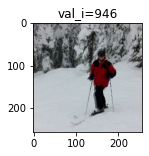

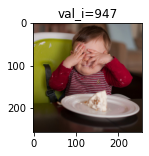

 97%|███████████████████████████████████████▌ | 948/982 [01:43<00:04,  8.02it/s]

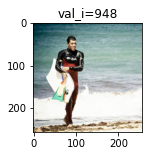

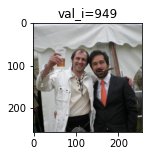

 97%|███████████████████████████████████████▋ | 950/982 [01:43<00:03,  8.62it/s]

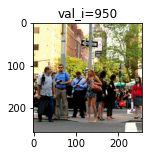

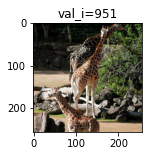

 97%|███████████████████████████████████████▋ | 952/982 [01:44<00:03,  9.20it/s]

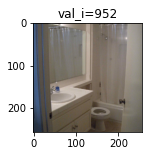

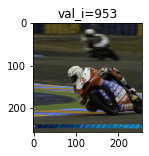

 97%|███████████████████████████████████████▊ | 954/982 [01:44<00:02,  9.49it/s]

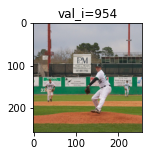

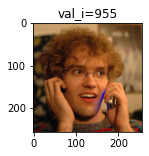

 97%|███████████████████████████████████████▉ | 956/982 [01:44<00:02,  9.88it/s]

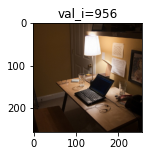

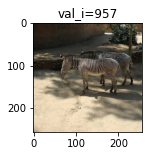

 98%|███████████████████████████████████████▉ | 958/982 [01:44<00:02,  9.93it/s]

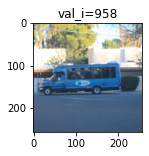

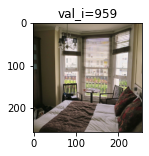

 98%|████████████████████████████████████████ | 960/982 [01:44<00:02, 10.12it/s]

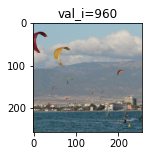

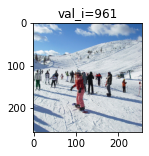

 98%|████████████████████████████████████████▏| 962/982 [01:45<00:01, 10.16it/s]

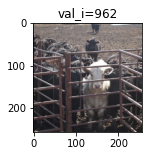

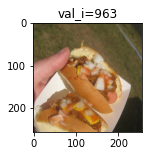

 98%|████████████████████████████████████████▏| 964/982 [01:45<00:01, 10.33it/s]

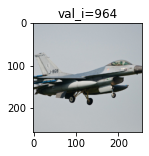

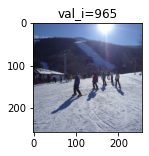

 98%|████████████████████████████████████████▎| 966/982 [01:45<00:01, 10.22it/s]

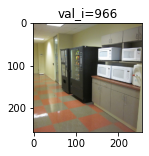

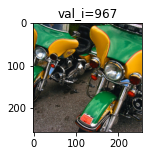

 99%|████████████████████████████████████████▍| 968/982 [01:45<00:01, 10.40it/s]

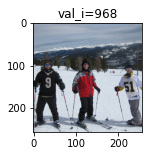

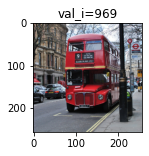

 99%|████████████████████████████████████████▍| 970/982 [01:45<00:01, 10.11it/s]

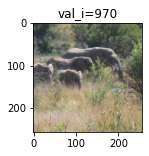

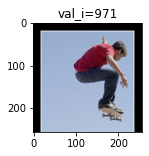

 99%|████████████████████████████████████████▌| 972/982 [01:46<00:01,  9.77it/s]

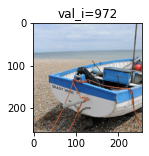

 99%|████████████████████████████████████████▌| 973/982 [01:46<00:00,  9.68it/s]

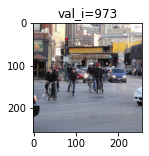

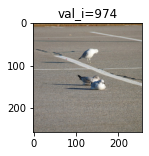

 99%|████████████████████████████████████████▋| 975/982 [01:46<00:00,  9.94it/s]

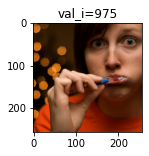

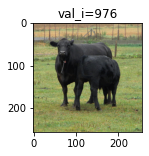

 99%|████████████████████████████████████████▊| 977/982 [01:46<00:00, 10.14it/s]

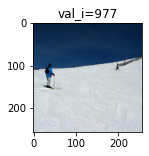

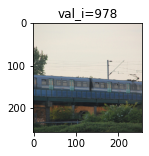

100%|████████████████████████████████████████▊| 979/982 [01:46<00:00, 10.24it/s]

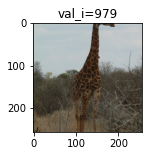

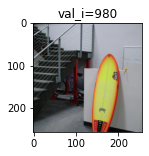

100%|████████████████████████████████████████▉| 981/982 [01:47<00:00, 10.27it/s]

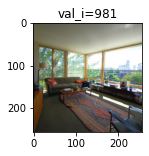

100%|█████████████████████████████████████████| 982/982 [01:47<00:00,  9.17it/s]


In [20]:
# for val_i, (voxel, img, coco) in enumerate(tqdm(val_dl,total=num_val)):
#     plt.figure(figsize=(2,2))
#     plt.imshow(utils.torch_to_Image(img))
#     plt.title(f"val_i={val_i}")
#     plt.show()

## Reconstruction via diffusion, one at a time
This will take awhile!!

In [ ]:
print(datetime.now().strftime('%Y-%m-%d %H:%M:%S'))
all_images = None
all_clip_recons = None
all_brain_recons = None
all_laion_picks = None

recons_per_clip = 0
recons_per_brain = 8

img2img = False
retrieve = False
plotting = False
v2c_ranking = True

if retrieve: assert batch_size == 1

ind_include = np.arange(num_val) #np.arange(3) #np.arange(num_val)

for val_i, (voxel, img, coco) in enumerate(tqdm(val_dl,total=num_val)):
    if val_i<np.min(ind_include):
        continue
    voxel = torch.mean(voxel,axis=1).to(device)
    # voxel = voxel[:,0].to(device)
    with torch.no_grad():
        if img2img:
            #ae_preds = voxel2sd(voxel.float())
            #blurry_recons = vae.decode(ae_preds.to(device)/0.18215).sample / 2 + 0.5
            
            blurry_recons = PIL.Image.open(f"blurry_recons/{coco.item()}.png").convert('RGB')
            blurry_recons = transforms.PILToTensor()(blurry_recons)
            blurry_recons = transforms.Resize((512,512))(blurry_recons)
            blurry_recons = (blurry_recons.float() / 255)[None]
        else:
            blurry_recons = None
            
        # prompt = utils.select_annotations(annots[coco.cpu().numpy()], random=True).tolist()
        # prompt = ['High-quality photograph']
        # print(prompt)
        # text_inputs = tokenizer(
        #             prompt,
        #             padding="max_length",
        #             max_length=tokenizer.model_max_length,
        #             truncation=True,
        #             return_tensors="pt",
        #         )
        # text_input_ids = text_inputs.input_ids
        # if hasattr(text_encoder.config, "use_attention_mask") and text_encoder.config.use_attention_mask:
        #     attention_mask = text_inputs.attention_mask.to(device)
        # else:
        #     attention_mask = None
        # prompt_embeds = text_encoder(
        #     text_input_ids.to(device),
        #     attention_mask=attention_mask,
        # )
        # embeds = text_encoder.text_projection(prompt_embeds.last_hidden_state)
        # embeds_pooled = prompt_embeds.text_embeds
        # text_token = embeds / torch.norm(embeds_pooled.unsqueeze(1), dim=-1, keepdim=True)

        # text_token = voxel2clip_txt(voxel.float()).reshape(len(voxel),-1,768)
        # text_token = text_token / torch.norm(text_token[:,0].unsqueeze(1), dim=-1, keepdim=True)
            
        grid, clip_recons, brain_recons, laion_best_picks, recon_img = utils.reconstruct_from_clip(
            img, voxel,
            clip_extractor, vd_pipe.image_unet, vd_pipe.vae, vd_pipe.scheduler,
            voxel2clip_img = voxel2clip_img, 
            diffusion_priors = diffusion_priors,
            text_token = None,
            img_lowlevel = blurry_recons,
            num_inference_steps = 20,
            n_samples_save = batch_size,
            recons_per_clip = recons_per_clip,
            recons_per_brain = recons_per_brain,
            guidance_scale = 3.5,
            img2img_strength = .95, # 0=fully rely on img_lowlevel, 1=not doing img2img
            timesteps_prior = 100,
            seed = seed,
            retrieve = retrieve,
            plotting = plotting,
            v2c_reference = True,
        )
            
        if plotting:
            plt.show()
            # grid.savefig(f'evals/{model_name}_{val_i}.png')
            # plt.close()

        if clip_recons is not None:
            clip_recons = clip_recons[:,0]
        if brain_recons is not None:
            brain_recons = brain_recons[:,laion_best_picks.astype(np.int8)]

        if all_brain_recons is None:
            all_brain_recons = brain_recons
            all_clip_recons = clip_recons
            all_images = img
        else:
            if recons_per_brain > 0 or retrieve:
                all_brain_recons = torch.vstack((all_brain_recons,brain_recons))
            if recons_per_clip > 0:
                all_clip_recons = torch.vstack((all_clip_recons,clip_recons))
            all_images = torch.vstack((all_images,img))
    if val_i>=np.max(ind_include):
        break

if recons_per_brain > 0 or retrieve:
    if recons_per_brain>0:
        all_brain_recons = all_brain_recons.view(-1,3,imsize,imsize)
    else:
        all_brain_recons = all_brain_recons.view(-1,3,imsize,imsize)
if recons_per_clip > 0:
    all_clip_recons = all_clip_recons.view(-1,3,imsize,imsize)

print("all_images.shape",all_images.shape)
if recons_per_brain > 0 or retrieve:
    print("all_brain_recons.shape",all_brain_recons.shape)
if recons_per_clip > 0: 
    print("all_clip_recons.shape",all_clip_recons.shape)
print(datetime.now().strftime('%Y-%m-%d %H:%M:%S'))

torch.save(all_brain_recons,f'evals/{model_name}_brain_recons_v2cranking')
# torch.save(all_clip_recons,'evals/all_clip_recons')
# torch.save(all_images,'evals/all_images')

2023-04-24 18:18:40


 10%|█████████▊                                                                                    | 103/982 [10:24<1:28:56,  6.07s/it]

sampling for image 1 of 1
voxel2clip out tensor([[-10.5895, -15.7087, -12.4231,  ...,  12.7402,   1.4796, -12.4079]],
       device='cuda:0')
p_sample_loop tensor([[[ 0.0058, -0.3239, -0.4196,  ...,  0.1587, -0.2105,  0.5406],
         [-0.2700,  0.3356,  0.0030,  ...,  0.2109, -0.6248, -0.6943],
         [-0.3421,  0.6070, -0.4496,  ...,  0.1097, -0.3564, -0.9101],
         ...,
         [ 0.0146,  0.0517, -0.5190,  ...,  0.1924,  0.0101, -0.4647],
         [-0.0066,  0.4647, -0.4958,  ...,  0.3374,  0.2740, -0.7228],
         [-0.2617, -0.1459, -0.1709,  ...,  0.0087, -0.1063, -0.2572]]],
       device='cuda:0')


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

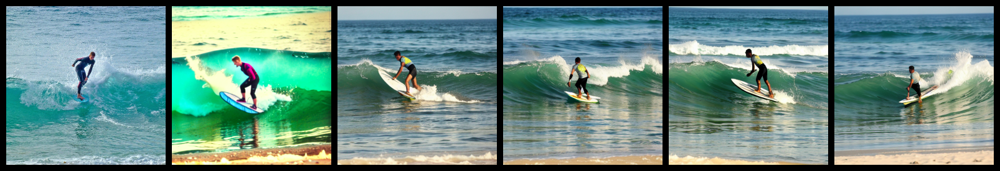

In [12]:
with torch.no_grad():
    grids,_ = utils.vd_sample_images(
                clip_extractor, diffusion_prior.voxel2clip, vd_pipe, diffusion_prior,
                voxel, img, seed=42,
            )
grids[0]

In [6]:
from transformers import CLIPVisionModelWithProjection
sd_cache_dir = '/fsx/proj-medarc/fmri/cache/models--shi-labs--versatile-diffusion/snapshots/2926f8e11ea526b562cd592b099fcf9c2985d0b7'
image_encoder = CLIPVisionModelWithProjection.from_pretrained(sd_cache_dir, subfolder='image_encoder').to(device)
image_encoder.eval()
for param in image_encoder.parameters():
    param.requires_grad = False # dont need to calculate gradients

emb = clip_extractor.embed_image(imgx.to(device)) # Original image
emb = emb.reshape(len(emb),-1)
emb = nn.functional.normalize(emb,dim=-1)

In [8]:
# clip_extractor = Clipper("ViT-L/14", hidden_state=True, norm_embs=True, device=device)
# train_url = "{/fsx/proj-medarc/fmri/natural-scenes-dataset/webdataset_avg_split/train/train_subj01_{0..17}.tar,/fsx/proj-medarc/fmri/natural-scenes-dataset/webdataset_avg_split/val/val_subj01_0.tar}"
# num_train = 8559 + 300
# batch_size = 100
# train_data = wds.WebDataset(train_url, resampled=False)\
#     .decode("torch")\
#     .rename(images="jpg;png", voxels='nsdgeneral.npy', trial="trial.npy", coco="coco73k.npy", reps="num_uniques.npy")\
#     .to_tuple("voxels", "images", "coco")\
#     .batched(batch_size, partial=False)
# train_dl = torch.utils.data.DataLoader(train_data, batch_size=None, shuffle=False)

# rgb2gray = transforms.Grayscale(num_output_channels=3)
# def mute_image(image_tensor, blend_factor=1.):
#     gray_image = rgb2gray(image_tensor)
#     # Blend the grayscale image with the original image
#     muted_image = (1 - blend_factor) * image_tensor + blend_factor * gray_image
#     return muted_image

# muted_embs = None
# for train_i, (voxel, img, coco) in enumerate(tqdm(train_dl,total=num_train//batch_size)):
#     with torch.no_grad():
#         emb = clip_extractor.embed_image(mute_image(img))
#         if muted_embs is None:
#             muted_embs = emb
#         else:
#             muted_embs = torch.vstack((muted_embs, emb))
# muted_avg = torch.mean(muted_embs,dim=0)[None]

ViT-L/14 cuda


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 88/88 [01:56<00:00,  1.32s/it]


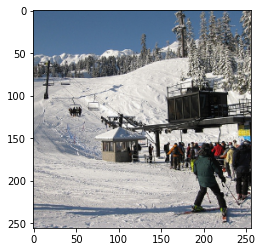

torch.Size([2, 257, 768])


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  7.48it/s]


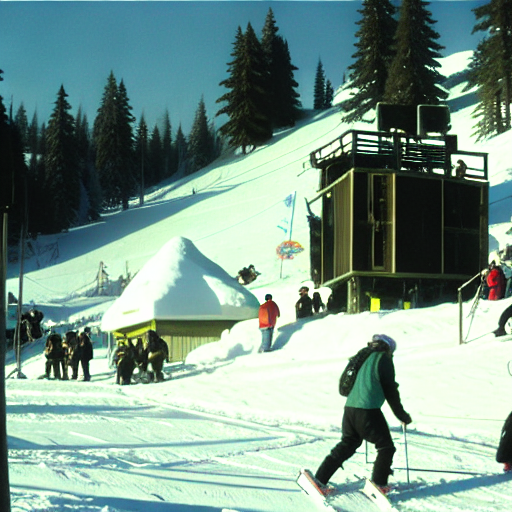

In [19]:
from diffusers.utils import randn_tensor
guidance_scale = 7.5
torch.manual_seed(0)
do_classifier_free_guidance = guidance_scale > 1.0
vae_scale_factor = 2 ** (len(vae.config.block_out_channels) - 1)
height = unet.config.sample_size * vae_scale_factor
width = unet.config.sample_size * vae_scale_factor
def decode_latents(latents):
    latents = 1 / 0.18215 * latents
    image = vae.decode(latents).sample
    image = (image / 2 + 0.5).clamp(0, 1)
    return image

preproc = transforms.Compose([
            transforms.Resize(size=224, interpolation=transforms.InterpolationMode.BICUBIC),
            transforms.CenterCrop(size=224),
            transforms.Normalize(mean=(0.48145466, 0.4578275, 0.40821073), std=(0.26862954, 0.26130258, 0.27577711))
        ])

plt.imshow(utils.torch_to_Image(img[[1]]))
plt.show()

with torch.no_grad():
    input_embedding = clip_extractor.embed_image(img[[1]].to(device)).float() + muted_avg
    # input_embedding /= torch.norm(input_embedding[:,-10],dim=-1)
    #input_embedding = voxel2clip(voxel.to(device).float()).reshape(len(voxel),-1,768)
    
    # push = torch.nn.functional.normalize(input_embedding - muted_avg, dim=1)
    # print(push.shape)
    # input_embedding = input_embedding + .9 * push

    input_embedding = torch.cat([torch.zeros_like(input_embedding), input_embedding]).to(device)
    print(input_embedding.shape)

    prompt_embeds = torch.randn(1,77,768).to(device)
    prompt_embeds = torch.cat([torch.zeros_like(prompt_embeds), prompt_embeds]).to(device)
    input_embedding = torch.cat([prompt_embeds, input_embedding], dim=1)

    noise_scheduler.set_timesteps(num_inference_steps=20, device=device)
    batch_size = input_embedding.shape[0] // 2 # divide by 2 bc we doubled it for classifier-free guidance
    shape = (batch_size, unet.in_channels, height // vae_scale_factor, width // vae_scale_factor)
    timesteps = noise_scheduler.timesteps
    latents = randn_tensor(shape, device=device, dtype=input_embedding.dtype)
    latents = latents * noise_scheduler.init_noise_sigma
    for i, t in enumerate(tqdm(timesteps)):
        latent_model_input = torch.cat([latents] * 2) if do_classifier_free_guidance else latents
        latent_model_input = noise_scheduler.scale_model_input(latent_model_input, t)
        noise_pred = unet(latent_model_input, t, encoder_hidden_states=input_embedding).sample
        # perform guidance
        if do_classifier_free_guidance:
            noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
            noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)
        # compute the previous noisy sample x_t -> x_t-1
        latents = noise_scheduler.step(noise_pred, t, latents).prev_sample
    recons = decode_latents(latents).detach().cpu()
utils.torch_to_Image(recons)

2nd-level reconstructing...
clip input_embedding torch.Size([1, 257, 768])
final img-variations input_embedding torch.Size([2, 1, 768])
input_embedding_cls torch.Size([768])
input_embedding_noprior_cls torch.Size([768])
input_embedding_img torch.Size([197376])
brain input_embedding_cls torch.Size([1, 1, 768])
brain input_embedding_img torch.Size([1, 256, 768])
brain input_embedding torch.Size([1, 257, 768])
final img-variations input_embedding torch.Size([4, 1, 768])
brain_recons torch.Size([1, 2, 3, 512, 512])


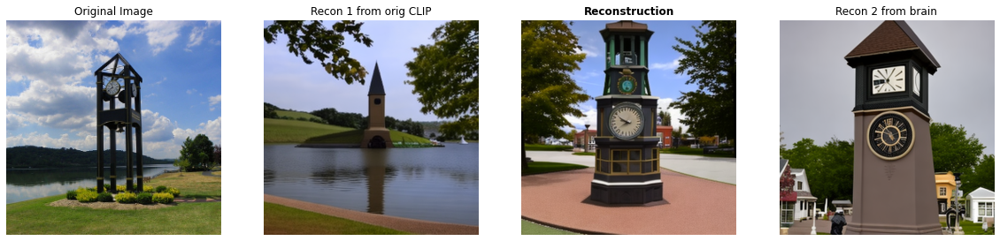

In [25]:
from diffusers import AutoencoderKL, PNDMScheduler, UNet2DConditionModel, UniPCMultistepScheduler

sd_cache_dir = '/fsx/home-paulscotti/.cache/huggingface/diffusers/models--lambdalabs--sd-image-variations-diffusers/snapshots/a2a13984e57db80adcc9e3f85d568dcccb9b29fc'
if not os.path.isdir(sd_cache_dir): # download from huggingface if not already downloaded / cached
    from diffusers import StableDiffusionImageVariationPipeline
    print("Downloading lambdalabs/sd-image-variations-diffusers from huggingface...")
    sd_pipe = StableDiffusionImageVariationPipeline.from_pretrained("lambdalabs/sd-image-variations-diffusers", revision="v2.0")
    sd_cache_dir = "lambdalabs/sd-image-variations-diffusers"

unet = UNet2DConditionModel.from_pretrained(sd_cache_dir,subfolder="unet").to(device)
unet.eval() # dont want to train model
unet.requires_grad_(False) # dont need to calculate gradients

vae = AutoencoderKL.from_pretrained(sd_cache_dir,subfolder="vae").to(device)
vae.eval()
vae.requires_grad_(False)

noise_scheduler = PNDMScheduler.from_pretrained(sd_cache_dir, subfolder="scheduler")
noise_scheduler = UniPCMultistepScheduler.from_config(noise_scheduler.config)
num_inference_steps = 20
    
recons_per_clip = 1
recons_per_brain = 2

print("img-variations reconstructing...")
with torch.no_grad():
    grid, clip_recons, brain_recons, laion_best_picks, recon_img2 = utils.reconstruct_from_clip(
        img, voxel,
        clip_extractor, unet, vae, noise_scheduler,
        voxel2clip_img = voxel2clip, 
        diffusion_priors = diffusion_priors,
        text_token = text_token,
        img_lowlevel = None,#recon_img[None],
        num_inference_steps = num_inference_steps,
        n_samples_save = batch_size,
        recons_per_clip = recons_per_clip,
        recons_per_brain = recons_per_brain,
        guidance_scale = 3.5,
        img2img_strength = .95, # 0=fully rely on img_lowlevel, 1=not doing img2img
        timesteps = 1000,
        seed = seed,
        retrieve = retrieve,
        plotting = plotting,
        variations = True,
    )

2023-04-05 18:29:55


  0%|                                                    | 0/982 [00:00<?, ?it/s]

clip input_embedding torch.Size([1, 257, 1024])
clip input_embedding torch.Size([1, 257, 768])
brain input_embedding torch.Size([1, 197376])
brain input_embedding torch.Size([1, 257, 768])
brain input_embedding torch.Size([1, 257, 768])


  0%|                                          | 1/982 [00:07<1:55:19,  7.05s/it]

clip input_embedding torch.Size([1, 257, 1024])
clip input_embedding torch.Size([1, 257, 768])
brain input_embedding torch.Size([1, 197376])
brain input_embedding torch.Size([1, 257, 768])
brain input_embedding torch.Size([1, 257, 768])


  0%|                                          | 2/982 [00:13<1:52:49,  6.91s/it]

clip input_embedding torch.Size([1, 257, 1024])
clip input_embedding torch.Size([1, 257, 768])
brain input_embedding torch.Size([1, 197376])
brain input_embedding torch.Size([1, 257, 768])
brain input_embedding torch.Size([1, 257, 768])


  0%|▏                                         | 3/982 [00:21<1:55:16,  7.06s/it]

clip input_embedding torch.Size([1, 257, 1024])
clip input_embedding torch.Size([1, 257, 768])
brain input_embedding torch.Size([1, 197376])
brain input_embedding torch.Size([1, 257, 768])
brain input_embedding torch.Size([1, 257, 768])


  0%|▏                                         | 4/982 [00:27<1:53:48,  6.98s/it]

clip input_embedding torch.Size([1, 257, 1024])
clip input_embedding torch.Size([1, 257, 768])
brain input_embedding torch.Size([1, 197376])
brain input_embedding torch.Size([1, 257, 768])
brain input_embedding torch.Size([1, 257, 768])


  0%|▏                                         | 4/982 [00:35<2:22:55,  8.77s/it]

all_images.shape torch.Size([5, 3, 256, 256])
all_brain_recons.shape torch.Size([5, 3, 512, 512])
all_clip_recons.shape torch.Size([5, 3, 512, 512])
2023-04-05 18:30:30


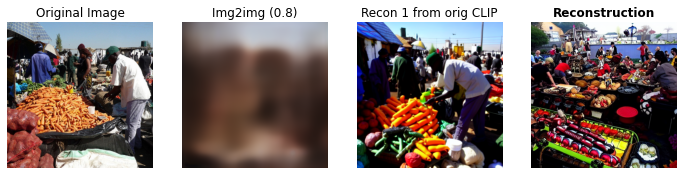

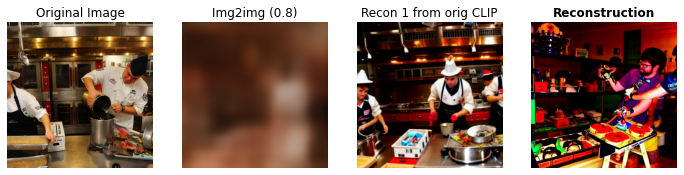

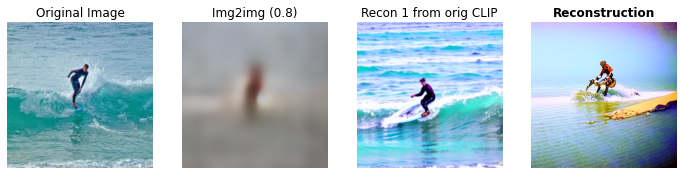

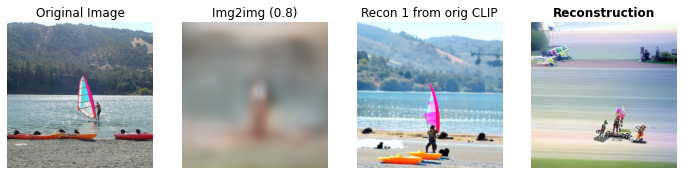

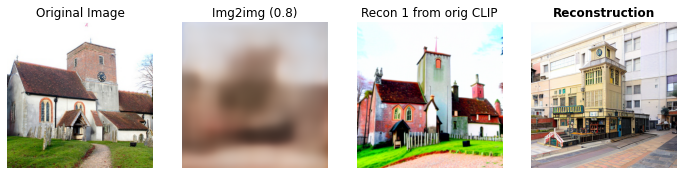

In [24]:
print(datetime.now().strftime('%Y-%m-%d %H:%M:%S'))
all_images = None
all_clip_recons = None
all_brain_recons = None
all_laion_picks = None

recons_per_clip = 1
recons_per_brain = 1

img2img = True
retrieve = False
plotting = True

if retrieve:
    assert batch_size == 1

for val_i, (voxel, img, coco) in enumerate(tqdm(val_dl,total=num_val)):
    voxel = torch.mean(voxel,axis=1).to(device)
    # voxel = voxel[:,0].to(device)
    with torch.no_grad():
        if img2img:
            ae_preds = voxel2sd(voxel.float())
            blurry_recons = vae.decode(ae_preds.to(device)/0.18215).sample / 2 + 0.5
        else:
            blurry_recons = None
          
        if versatile or openclip:
            grid, clip_recons, brain_recons, laion_best_picks = utils.reconstruct_from_clip(
                img, voxel,
                clip_extractor, unet, vae, noise_scheduler,
                voxel2clip=voxel2clip, 
                img_lowlevel = blurry_recons,
                num_inference_steps = num_inference_steps,
                n_samples_save = batch_size,
                recons_per_clip = recons_per_clip,
                recons_per_brain = recons_per_brain,
                guidance_scale = 7.5,
                img2img_strength = .8, # 0=fully rely on img_lowlevel, 1=not doing img2img
                timesteps = 1000,
                seed = seed,
                retrieve = retrieve,
                plotting = plotting,
                openclip = openclip,
                versatile = versatile,
                vers_prior_path = None,#'/fsx/proj-medarc/fmri/paulscotti/fMRI-reconstruction-NSD/train_logs',
                num_layers = None,
            )
        else:
            grid, clip_recons, brain_recons, laion_best_picks = utils.reconstruct_from_clip(
                img, voxel,
                clip_extractor, unet, vae, noise_scheduler,
                diffusion_priors=diffusion_priors, 
                img_lowlevel = blurry_recons,
                num_inference_steps = num_inference_steps,
                n_samples_save = batch_size,
                recons_per_clip = recons_per_clip,
                recons_per_brain = recons_per_brain,
                guidance_scale = 7.5,
                img2img_strength = .9, # 0=fully rely on img_lowlevel, 1=not doing img2img
                timesteps = 1000,
                seed = seed,
                retrieve = retrieve,
                plotting = plotting,
                openclip = openclip,
                versatile = versatile,
            )
            
        if plotting:
            grid.savefig(f'evals/{model_name}_{val_i}_{scheduler}.png')
            # plt.close()

        if clip_recons is not None:
            clip_recons = clip_recons[:,0]
        if brain_recons is not None:
            brain_recons = brain_recons[:,laion_best_picks.astype(np.int8)]

        if all_brain_recons is None:
            all_brain_recons = brain_recons
            all_clip_recons = clip_recons
            all_images = img
        else:
            if recons_per_brain > 0 or retrieve:
                all_brain_recons = torch.vstack((all_brain_recons,brain_recons))
            if recons_per_clip > 0:
                all_clip_recons = torch.vstack((all_clip_recons,clip_recons))
            all_images = torch.vstack((all_images,img))
    if val_i>=4:
        break

if recons_per_brain > 0 or retrieve:
    if recons_per_brain>0:
        all_brain_recons = all_brain_recons.view(-1,3,imsize,imsize)
    else:
        all_brain_recons = all_brain_recons.view(-1,3,imsize,imsize)
if recons_per_clip > 0:
    all_clip_recons = all_clip_recons.view(-1,3,imsize,imsize)

print("all_images.shape",all_images.shape)
if recons_per_brain > 0 or retrieve:
    print("all_brain_recons.shape",all_brain_recons.shape)
if recons_per_clip > 0: 
    print("all_clip_recons.shape",all_clip_recons.shape)
print(datetime.now().strftime('%Y-%m-%d %H:%M:%S'))

2023-04-02 18:48:33


  0%|▏                                        | 4/982 [00:54<3:41:30, 13.59s/it]

all_images.shape torch.Size([5, 3, 256, 256])
all_brain_recons.shape torch.Size([5, 3, 512, 512])
all_clip_recons.shape torch.Size([5, 3, 512, 512])
2023-04-02 18:49:27


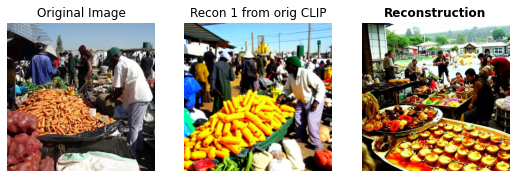

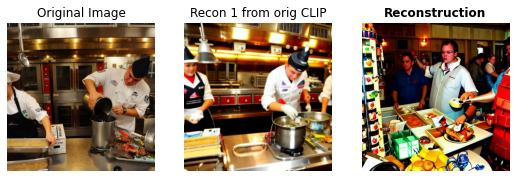

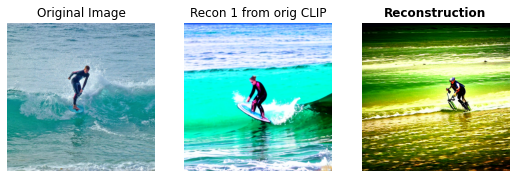

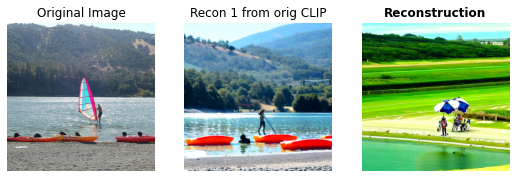

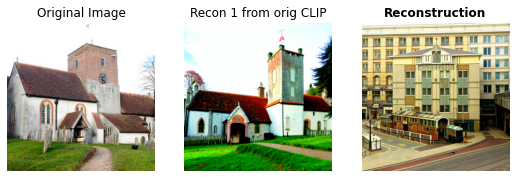

In [10]:
print(datetime.now().strftime('%Y-%m-%d %H:%M:%S'))
all_images = None
all_clip_recons = None
all_brain_recons = None
all_laion_picks = None

recons_per_clip = 1
recons_per_brain = 1

img2img = False
retrieve = False
plotting = True

if retrieve:
    assert batch_size == 1

for val_i, (voxel, img, coco) in enumerate(tqdm(val_dl,total=num_val)):
    voxel = torch.mean(voxel,axis=1).to(device)
    # voxel = voxel[:,0].to(device)
    with torch.no_grad():
        if img2img:
            ae_preds = voxel2sd(voxel.float())
            blurry_recons = vae.decode(ae_preds.to(device)/0.18215).sample / 2 + 0.5
        else:
            blurry_recons = None
          
        if versatile or openclip:
            grid, clip_recons, brain_recons, laion_best_picks = utils.reconstruct_from_clip(
                img, voxel,
                clip_extractor, unet, vae, noise_scheduler,
                voxel2clip=voxel2clip, 
                img_lowlevel = blurry_recons,
                num_inference_steps = num_inference_steps,
                n_samples_save = batch_size,
                recons_per_clip = recons_per_clip,
                recons_per_brain = recons_per_brain,
                guidance_scale = 7.5,
                img2img_strength = .9, # 0=fully rely on img_lowlevel, 1=not doing img2img
                timesteps = 1000,
                seed = seed,
                retrieve = retrieve,
                plotting = plotting,
                openclip = openclip,
                versatile = versatile,
            )
        else:
            grid, clip_recons, brain_recons, laion_best_picks = utils.reconstruct_from_clip(
                img, voxel,
                clip_extractor, unet, vae, noise_scheduler,
                diffusion_priors=diffusion_priors, 
                img_lowlevel = blurry_recons,
                num_inference_steps = num_inference_steps,
                n_samples_save = batch_size,
                recons_per_clip = recons_per_clip,
                recons_per_brain = recons_per_brain,
                guidance_scale = 7.5,
                img2img_strength = .9, # 0=fully rely on img_lowlevel, 1=not doing img2img
                timesteps = 1000,
                seed = seed,
                retrieve = retrieve,
                plotting = plotting,
                openclip = openclip,
                versatile = versatile,
            )
            
        if plotting:
            grid.savefig(f'evals/{model_name}_{val_i}_{scheduler}.png')
            # plt.close()

        if clip_recons is not None:
            clip_recons = clip_recons[:,0]
        if brain_recons is not None:
            brain_recons = brain_recons[:,laion_best_picks.astype(np.int8)]

        if all_brain_recons is None:
            all_brain_recons = brain_recons
            all_clip_recons = clip_recons
            all_images = img
        else:
            if recons_per_brain > 0 or retrieve:
                all_brain_recons = torch.vstack((all_brain_recons,brain_recons))
            if recons_per_clip > 0:
                all_clip_recons = torch.vstack((all_clip_recons,clip_recons))
            all_images = torch.vstack((all_images,img))
    if val_i>=4:
        break

if recons_per_brain > 0 or retrieve:
    if recons_per_brain>0:
        all_brain_recons = all_brain_recons.view(-1,3,imsize,imsize)
    else:
        all_brain_recons = all_brain_recons.view(-1,3,imsize,imsize)
if recons_per_clip > 0:
    all_clip_recons = all_clip_recons.view(-1,3,imsize,imsize)

print("all_images.shape",all_images.shape)
if recons_per_brain > 0 or retrieve:
    print("all_brain_recons.shape",all_brain_recons.shape)
if recons_per_clip > 0: 
    print("all_clip_recons.shape",all_clip_recons.shape)
print(datetime.now().strftime('%Y-%m-%d %H:%M:%S'))

2023-04-02 18:59:07


  0%|▏                                        | 4/982 [02:12<8:58:30, 33.04s/it]

all_images.shape torch.Size([5, 3, 256, 256])
all_brain_recons.shape torch.Size([5, 3, 512, 512])
all_clip_recons.shape torch.Size([5, 3, 512, 512])
2023-04-02 19:01:19


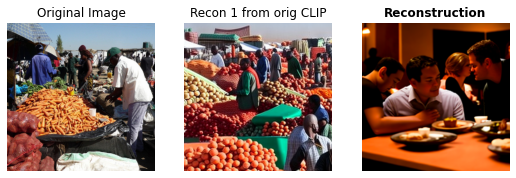

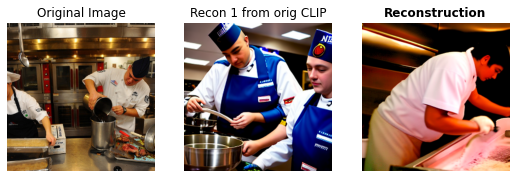

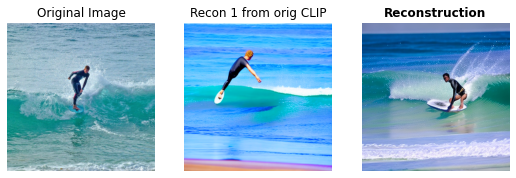

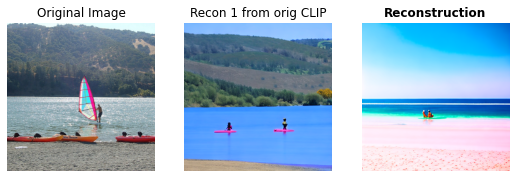

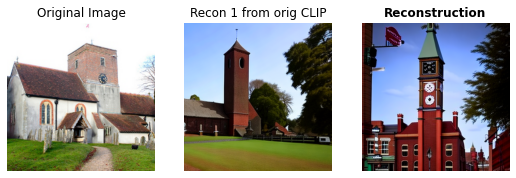

In [15]:
print(datetime.now().strftime('%Y-%m-%d %H:%M:%S'))
all_images = None
all_clip_recons = None
all_brain_recons = None
all_laion_picks = None

recons_per_clip = 1
recons_per_brain = 1

img2img = False
retrieve = False
plotting = True

if retrieve:
    assert batch_size == 1

for val_i, (voxel, img, coco) in enumerate(tqdm(val_dl,total=num_val)):
    voxel = torch.mean(voxel,axis=1).to(device)
    # voxel = voxel[:,0].to(device)
    with torch.no_grad():
        if img2img:
            ae_preds = voxel2sd(voxel.float())
            blurry_recons = vae.decode(ae_preds.to(device)/0.18215).sample / 2 + 0.5
        else:
            blurry_recons = None
          
        if versatile or openclip:
            grid, clip_recons, brain_recons, laion_best_picks = utils.reconstruct_from_clip(
                img, voxel,
                clip_extractor, unet, vae, noise_scheduler,
                voxel2clip=voxel2clip, 
                img_lowlevel = blurry_recons,
                num_inference_steps = num_inference_steps,
                n_samples_save = batch_size,
                recons_per_clip = recons_per_clip,
                recons_per_brain = recons_per_brain,
                guidance_scale = 7.5,
                img2img_strength = .9, # 0=fully rely on img_lowlevel, 1=not doing img2img
                timesteps = 1000,
                seed = seed,
                retrieve = retrieve,
                plotting = plotting,
                openclip = openclip,
                versatile = versatile,
            )
        else:
            grid, clip_recons, brain_recons, laion_best_picks = utils.reconstruct_from_clip(
                img, voxel,
                clip_extractor, unet, vae, noise_scheduler,
                diffusion_priors=diffusion_priors, 
                img_lowlevel = blurry_recons,
                num_inference_steps = num_inference_steps,
                n_samples_save = batch_size,
                recons_per_clip = recons_per_clip,
                recons_per_brain = recons_per_brain,
                guidance_scale = 7.5,
                img2img_strength = .9, # 0=fully rely on img_lowlevel, 1=not doing img2img
                timesteps = 1000,
                seed = seed,
                retrieve = retrieve,
                plotting = plotting,
                openclip = openclip,
                versatile = versatile,
            )
            
        if plotting:
            grid.savefig(f'evals/{model_name}_{val_i}_{scheduler}.png')
            # plt.close()

        if clip_recons is not None:
            clip_recons = clip_recons[:,0]
        if brain_recons is not None:
            brain_recons = brain_recons[:,laion_best_picks.astype(np.int8)]

        if all_brain_recons is None:
            all_brain_recons = brain_recons
            all_clip_recons = clip_recons
            all_images = img
        else:
            if recons_per_brain > 0 or retrieve:
                all_brain_recons = torch.vstack((all_brain_recons,brain_recons))
            if recons_per_clip > 0:
                all_clip_recons = torch.vstack((all_clip_recons,clip_recons))
            all_images = torch.vstack((all_images,img))
    if val_i>=4:
        break

if recons_per_brain > 0 or retrieve:
    if recons_per_brain>0:
        all_brain_recons = all_brain_recons.view(-1,3,imsize,imsize)
    else:
        all_brain_recons = all_brain_recons.view(-1,3,imsize,imsize)
if recons_per_clip > 0:
    all_clip_recons = all_clip_recons.view(-1,3,imsize,imsize)

print("all_images.shape",all_images.shape)
if recons_per_brain > 0 or retrieve:
    print("all_brain_recons.shape",all_brain_recons.shape)
if recons_per_clip > 0: 
    print("all_clip_recons.shape",all_clip_recons.shape)
print(datetime.now().strftime('%Y-%m-%d %H:%M:%S'))

In [37]:
mse=nn.MSELoss()
print(mse(eo,ef))
print(eo.shape, ef.shape)
print(eo.min(), ef.min())
print(eo.max(), ef.max())
print(eo.mean(), ef.mean())
print(eo.std(), ef.std())

tensor(0.0011, device='cuda:0')
torch.Size([1, 257, 768]) torch.Size([1, 257, 768])
tensor(-0.5389, device='cuda:0') tensor(-0.5588, device='cuda:0')
tensor(0.5678, device='cuda:0') tensor(0.6052, device='cuda:0')
tensor(1.6411e-05, device='cuda:0') tensor(-0.0004, device='cuda:0')
tensor(0.0361, device='cuda:0') tensor(0.0361, device='cuda:0')


In [15]:
img_lowlevel_embeddings = clip_extractor.preprocess(img_lowlevel[[emb_idx]])

img_lowlevel_embeddings = nn.functional.interpolate(img_lowlevel_embeddings, (768,768), mode="area", antialias=False)

init_latents = vae.encode(img_lowlevel_embeddings).latent_dist.sample(generator)
init_latents = vae.config.scaling_factor * init_latents
init_latents = init_latents.repeat(recons_per_sample, 1, 1, 1)

noise = randn_tensor(shape, generator=generator, device=device)
init_latents = noise_scheduler.add_noise(init_latents, noise, latent_timestep)
latents = init_latents

The config attributes {'class_embeddings_concat': False} were passed to UNet2DConditionModel, but are not expected and will be ignored. Please verify your config.json configuration file.


  0%|          | 0/21 [00:00<?, ?it/s]

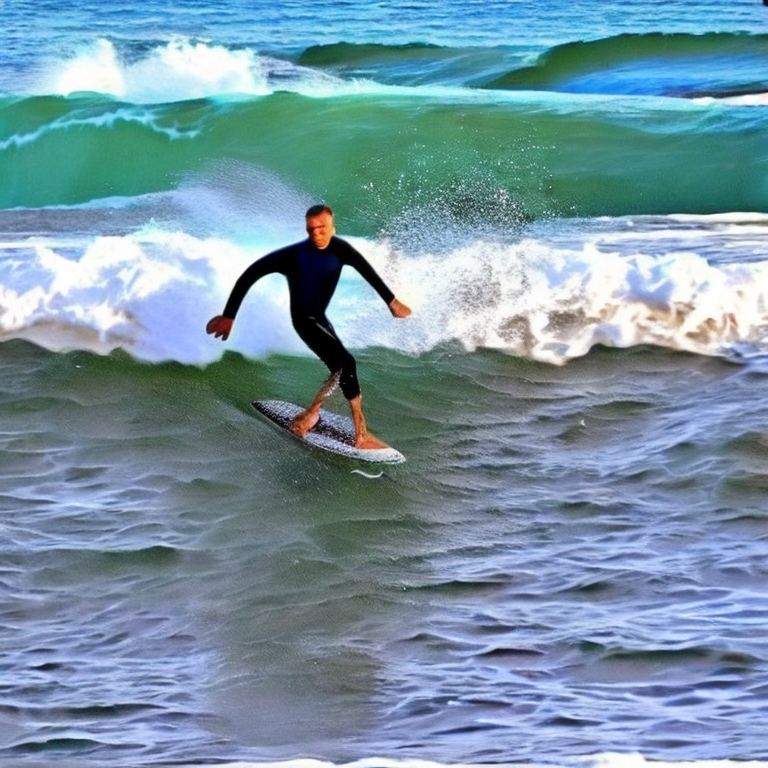

In [31]:
from diffusers import StableUnCLIPimg2ImgPipeline
with torch.no_grad():
    sd_pipe = StableUnCLIPimg2ImgPipeline.from_pretrained(
        sd_cache_dir, torch_dtype=torch.float16,
    )
    sd_pipe.to(device)

p=sd_pipe(image=utils.torch_to_Image(img),prompt='surfer')
p[0][0]

In [10]:
from diffusers import StableUnCLIPimg2ImgPipeline
with torch.no_grad():
    sd_pipe = StableUnCLIPimg2ImgPipeline.from_pretrained(
        sd_cache_dir, torch_dtype=torch.float16,
    )
    sd_pipe.to(device)

#     image_embeds = clip_extractor.embed_image(img).float()
#     print(image_embeds.shape)

#     # 8. Encode input prompt
#     prompt_embeds = sd_pipe._encode_prompt(
#         prompt="",
#         device=device,
#         num_images_per_prompt=2,
#         do_classifier_free_guidance=True,
#         negative_prompt="",
#     )
#     print(prompt_embeds.shape)

#     # 9. Prepare image embeddings
#     image_embeds = sd_pipe.noise_image_embeddings(
#         image_embeds=image_embeds,
#         noise_level=0, #0 to 1000
#     )
#     print(image_embeds.shape)
#     noise_pred = unet(
#         latent_model_input,
#         t,
#         encoder_hidden_states=prompt_embeds,
#         class_labels=image_embeds,
#         cross_attention_kwargs=None, 
#     ).sample

The config attributes {'class_embeddings_concat': False} were passed to UNet2DConditionModel, but are not expected and will be ignored. Please verify your config.json configuration file.


# Loading

### concatenate separate recon pipes

In [2]:
# import torch
# from tqdm import tqdm
# all_brain_recons = None
# for i in tqdm(range(9)):
#     j = i * 109
#     jj = j + 109
#     if jj==981: jj = 982
#     d = torch.load(f'evals/recons_prior_nomixco_86_{j}_{jj}',map_location=torch.device('cpu'))
#     # d = torch.load(f'evals/brain_imgtext_recons_{j}_{jj}',map_location=torch.device('cpu'))
#     # d = torch.load(f'evals/retrieval_recons_{j}_{jj}',map_location=torch.device('cpu'))
#     # e = torch.load(f'evals/retrieval_images_{j}_{jj}',map_location=torch.device('cpu'))

#     if all_brain_recons is None:
#         all_brain_recons = d
#         # all_images = e
#     else:
#         all_brain_recons = torch.vstack((all_brain_recons, d))
#         # all_images = torch.vstack((all_images, e))
# print(all_brain_recons.shape)
# # print(all_images.shape)
# # torch.save(all_images,'evals/all_images')
# torch.save(all_brain_recons,'evals/all_brain_prior_nomixco_86')

100%|███████████████████████████████████████████████████████████████████████| 9/9 [00:05<00:00,  1.52it/s]


torch.Size([982, 3, 512, 512])


### load image outputs

In [6]:
# import torch
# from torchvision import transforms
# import PIL
# from tqdm import tqdm

# toTensor = transforms.ToTensor()
# imgpath = 'brain-diffuser/results/versatile_diffusion/subj01'

# for i in tqdm(range(982)):
#     if i==0:
#         all_brain_recons = toTensor(PIL.Image.open(f'{imgpath}/{i}.png'))[None]
#     else:
#         all_brain_recons = torch.vstack((all_brain_recons, toTensor(PIL.Image.open(f'{imgpath}/{i}.png'))[None]))
# print(all_brain_recons.shape)
# torch.save(all_brain_recons,f'evals/braindiffuser_brain_recons')

100%|████████████████████████████████████████████████████████████████████████████████████████████████| 982/982 [05:08<00:00,  3.18it/s]


torch.Size([982, 3, 512, 512])

### load pretrained diffusion image outputs

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
device: cuda
ViT-L/14 cuda
torch.Size([982, 3, 256, 256])


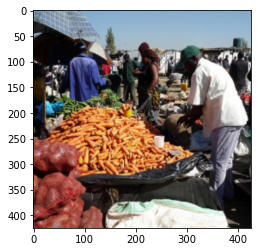

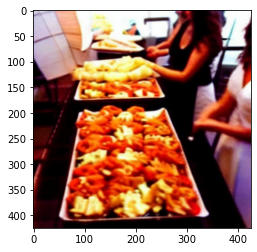

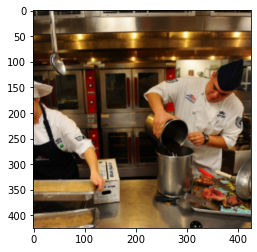

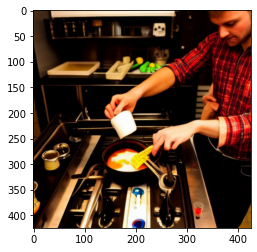

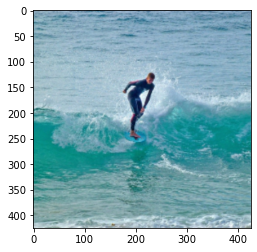

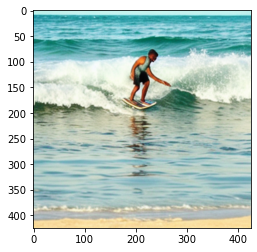

In [37]:
%load_ext autoreload
%autoreload 2

import os
import sys
import json
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import transforms
from tqdm import tqdm
from datetime import datetime

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
local_rank = 0
print("device:",device)

import utils
seed=42
utils.seed_everything(seed=seed)

# Load CLIP extractor
# from models import OpenClipper
# clip_extractor = OpenClipper("ViT-H-14", device=device)
# imsize = 768

from models import Clipper
clip_extractor = Clipper("ViT-L/14", hidden_state=False, norm_embs=True, device=device)
imsize = 512

# all_brain_recons = torch.load('evals/all_brain_recons')
# all_brain_recons = torch.load('evals/all_brain_retrievals')
# all_brain_recons = torch.load('evals/all_brain_imgtext_recons')

model_name = 'prior_nodetr_noncausal_posemb_240_cont'
all_brain_recons = torch.load(f'evals/{model_name}_brain_recons_img2img')
# all_brain_recons = torch.load('evals/all_brain_recons')
# all_brain_recons = torch.load('evals/all_blurred_recons')
# all_clip_recons = torch.load('evals/all_clip_recons')
all_images = torch.load('evals/all_images')
# all_laion_picks = torch.load('evals/all_laion_picks')

# all_brain_recons = torch.load(f'evals/braindiffuser_brain_recons')
# all_images = torch.Tensor(np.load('brain-diffuser/data/processed_data/subj01/nsd_test_stim_sub1.npy')/255).permute(0,3,1,2)

print(all_images.shape)
all_images = transforms.Resize((425,425))(all_images)
all_brain_recons = transforms.Resize((425,425))(all_brain_recons)

for ii in range(3):
    plt.imshow(utils.torch_to_Image(all_images[ii]))
    plt.show()
    plt.imshow(utils.torch_to_Image(all_brain_recons[ii]))
    plt.show()

## 2-way identification

In [38]:
def l2norm(x):
    return nn.functional.normalize(x, dim=-1)

def two_way_identification(all_brain_recons, groundtruth, model, preprocess):
    per_correct = []
    l2dist_list = []
    for irecon, recon in enumerate(tqdm(all_brain_recons,total=len(all_brain_recons))):
        with torch.no_grad():   
            if torch.all(recon==0) or torch.all(recon==1):
                print("Completely blank reconstruction?")
                continue
            real = groundtruth[[irecon]]
            fake = model(preprocess(recon)[None]).float().flatten()[None]

            rand = torch.cat((groundtruth[:irecon], groundtruth[irecon:]))
            # rand = model(preprocess(other_recons.to(device))).float()

            l2dist_fake = torch.mean(torch.sqrt((l2norm(real) - l2norm(fake))**2))
            l2dist_rand = torch.mean(torch.sqrt((l2norm(real) - l2norm(rand))**2))
            
            # # cosine similarity is faster and gives same per_correct results
            # l2dist_fake = utils.pairwise_cosine_similarity(real,fake).item()
            # l2dist_rand = utils.pairwise_cosine_similarity(real,rand).item()

            if l2dist_fake < l2dist_rand:
                per_correct.append(1)
            else:
                per_correct.append(0)
            l2dist_list.append(l2dist_fake.detach().cpu().numpy())
    return per_correct, l2dist_list

def two_way_identification_clip(all_brain_recons, groundtruth):
    per_correct = []
    l2dist_list = []
    for irecon, recon in enumerate(tqdm(all_brain_recons,total=len(all_brain_recons))):
        with torch.no_grad():       
            if torch.all(recon==0) or torch.all(recon==1):
                print("Completely blank reconstruction?")
                continue
            real = groundtruth[irecon].unsqueeze(0).to(device)
            fake = clip_extractor.embed_image(recon.unsqueeze(0).to(device)).float()

            rand = torch.cat((groundtruth[:irecon], groundtruth[irecon+1:])).to(device)

            l2dist_fake = torch.mean(torch.sqrt((l2norm(real) - l2norm(fake))**2))
            l2dist_rand = torch.mean(torch.sqrt((l2norm(real) - l2norm(rand))**2))

            # # cosine similarity is faster and gives same per_correct results
            # l2dist_fake = utils.pairwise_cosine_similarity(real,fake).item()
            # l2dist_rand = utils.pairwise_cosine_similarity(real,rand).item()

            if l2dist_fake < l2dist_rand:
                per_correct.append(1)
            else:
                per_correct.append(0)
            l2dist_list.append(l2dist_fake.detach().cpu().numpy())
    return per_correct, l2dist_list

## Pre-calculate ground truth image features for all 982 samples

In [39]:
# all_images = torch.load('evals/all_images')
# alex_early=alex_mid=alex_late=incep=clipimg=torch.Tensor([]).to(device)

# # alexnet #
# from torchvision.models import alexnet, AlexNet_Weights
# alex_weights = AlexNet_Weights.DEFAULT
# alex_model_late = alexnet(weights=alex_weights).eval()
# alex_model_mid = alexnet(weights=alex_weights).eval()
# alex_model_early = alexnet(weights=alex_weights).eval()
# alex_model_late.requires_grad_(False).to(device)
# alex_model_mid.requires_grad_(False).to(device)
# alex_model_early.requires_grad_(False).to(device)
# alex_preprocess = alex_weights.transforms()

# for i,f in enumerate(alex_model_late.features):
#     if i>7:
#         alex_model_late.features[i] = nn.Identity()
#     alex_model_late.avgpool=nn.Identity()
#     alex_model_late.classifier=nn.Identity()
    
# for i,f in enumerate(alex_model_mid.features):
#     if i>4:
#         alex_model_mid.features[i] = nn.Identity()
#     alex_model_mid.avgpool=nn.Identity()
#     alex_model_mid.classifier=nn.Identity()
    
# for i,f in enumerate(alex_model_early.features):
#     if i>1:
#         alex_model_early.features[i] = nn.Identity()
#     alex_model_early.avgpool=nn.Identity()
#     alex_model_early.classifier=nn.Identity()
    
# # inceptionv3 #
# from torchvision.models import inception_v3, Inception_V3_Weights

# incep_weights = Inception_V3_Weights.DEFAULT
# incep_model = inception_v3(weights=incep_weights).eval()
# incep_model.requires_grad_(False).to(device)
# incep_preprocess = incep_weights.transforms()

# incep_model.dropout = nn.Identity()
# incep_model.fc = nn.Identity()

# # clip vit-l/14 #
# clip_extractor = Clipper("ViT-L/14", device=device)

# for ii, orig_image in enumerate(tqdm(all_images,total=len(all_images))):
#     orig_image = orig_image.to(device)
    
#     ## ALEXNET ##
#     alex_early = torch.cat((alex_early,alex_model_early(alex_preprocess(orig_image).unsqueeze(0)).float()))
#     alex_mid = torch.cat((alex_mid,alex_model_mid(alex_preprocess(orig_image).unsqueeze(0)).float()))
#     alex_late = torch.cat((alex_late,alex_model_late(alex_preprocess(orig_image).unsqueeze(0)).float()))
    
#     ## INCEPTION V3 ##
#     incep = torch.cat((incep, incep_model(incep_preprocess(orig_image).unsqueeze(0)).float()))
    
#     ## CLIP ##
#     clipimg = torch.cat((clipimg,clip_extractor.embed_image(orig_image.unsqueeze(0)).float()))
    
# torch.save(alex_early.detach().cpu(),'orig_img_features/alex_early.pt')
# torch.save(alex_mid.detach().cpu(),'orig_img_features/alex_mid.pt')
# torch.save(alex_late.detach().cpu(),'orig_img_features/alex_late.pt')
# torch.save(incep.detach().cpu(),'orig_img_features/incep.pt')
# torch.save(clipimg.detach().cpu(),'orig_img_features/clipimg.pt')

In [40]:
alex_early=torch.load('orig_img_features/alex_early.pt')
alex_mid=torch.load('orig_img_features/alex_mid.pt')
alex_late=torch.load('orig_img_features/alex_late.pt')
incep=torch.load('orig_img_features/incep.pt')
clipimg=torch.load('orig_img_features/clipimg.pt')

### AlexNet

In [41]:
from torchvision.models import alexnet, AlexNet_Weights
alex_weights = AlexNet_Weights.DEFAULT
alex_model_late = alexnet(weights=alex_weights).eval().to(device)
alex_model_mid = alexnet(weights=alex_weights).eval().to(device)
alex_model_early = alexnet(weights=alex_weights).eval().to(device)
alex_model_late.requires_grad_(False).to(device)
alex_model_mid.requires_grad_(False).to(device)
alex_model_early.requires_grad_(False).to(device)
preprocess = alex_weights.transforms()

for i,f in enumerate(alex_model_late.features):
    if i>7:
        alex_model_late.features[i] = nn.Identity()
    alex_model_late.avgpool=nn.Identity()
    alex_model_late.classifier=nn.Identity()
    
for i,f in enumerate(alex_model_mid.features):
    if i>4:
        alex_model_mid.features[i] = nn.Identity()
    alex_model_mid.avgpool=nn.Identity()
    alex_model_mid.classifier=nn.Identity()
    
for i,f in enumerate(alex_model_early.features):
    if i>1:
        alex_model_early.features[i] = nn.Identity()
    alex_model_early.avgpool=nn.Identity()
    alex_model_early.classifier=nn.Identity()

# layer = 'late, AlexNet(8)'
# print(f"\n---{layer}---")
# all_per_correct, all_l2dist_list = two_way_identification(all_brain_recons.to(device), alex_late.to(device), 
#                                                           alex_model_late.to(device), preprocess)
# print(f"2-way Percent Correct (mu, std): {np.mean(all_per_correct):.4f} | {np.std(all_per_correct):.4f}")
# print(f"Avg l2dist_fake (mu, std): {np.mean(all_l2dist_list):.4f} | {np.std(all_l2dist_list):.4f}")

layer = 'mid, AlexNet(5)'
print(f"\n---{layer}---")
all_per_correct, all_l2dist_list = two_way_identification(all_brain_recons.to(device), alex_mid.to(device), 
                                                          alex_model_mid.to(device), preprocess)
print(f"2-way Percent Correct (mu, std): {np.mean(all_per_correct):.4f} | {np.std(all_per_correct):.4f}")
print(f"Avg l2dist_fake (mu, std): {np.mean(all_l2dist_list):.4f} | {np.std(all_l2dist_list):.4f}")

layer = 'early, AlexNet(2)'
print(f"\n---{layer}---")
all_per_correct, all_l2dist_list = two_way_identification(all_brain_recons.to(device), alex_early.to(device), 
                                                          alex_model_early.to(device), preprocess)
print(f"2-way Percent Correct (mu, std): {np.mean(all_per_correct):.4f} | {np.std(all_per_correct):.4f}")
print(f"Avg l2dist_fake (mu, std): {np.mean(all_l2dist_list):.4f} | {np.std(all_l2dist_list):.4f}")


---mid, AlexNet(5)---


100%|███████████████████████████████████████████████████████████████████████████████████████████████| 982/982 [00:06<00:00, 162.23it/s]


2-way Percent Correct (mu, std): 0.8299 | 0.3757
Avg l2dist_fake (mu, std): 0.0013 | 0.0001

---early, AlexNet(2)---


100%|███████████████████████████████████████████████████████████████████████████████████████████████| 982/982 [00:07<00:00, 126.61it/s]

2-way Percent Correct (mu, std): 0.8646 | 0.3422
Avg l2dist_fake (mu, std): 0.0013 | 0.0001


### InceptionV3

In [42]:
from torchvision.models import inception_v3, Inception_V3_Weights

weights = Inception_V3_Weights.DEFAULT
model = inception_v3(weights=weights).eval()
model.requires_grad_(False).to(device)
preprocess = weights.transforms()

model.dropout = nn.Identity()
model.fc = nn.Identity()
# print(model)

all_per_correct, all_l2dist_list = two_way_identification(all_brain_recons.to(device), incep.to(device), 
                                                          model.to(device), preprocess)
        
print(f"2-way Percent Correct (mu, std): {np.mean(all_per_correct):.4f} | {np.std(all_per_correct):.4f}")
print(f"Avg l2dist_fake (mu, std): {np.mean(all_l2dist_list):.4f} | {np.std(all_l2dist_list):.4f}")

100%|████████████████████████████████████████████████████████████████████████████████████████████████| 982/982 [00:10<00:00, 95.14it/s]

2-way Percent Correct (mu, std): 0.9532 | 0.2113
Avg l2dist_fake (mu, std): 0.0121 | 0.0024


### CLIP

In [15]:
all_per_correct, all_l2dist_list = two_way_identification_clip(all_brain_recons, clipimg)
print(f"2-way Percent Correct (mu, std): {np.mean(all_per_correct):.4f} | {np.std(all_per_correct):.4f}")
print(f"Avg l2dist_fake (mu, std): {np.mean(all_l2dist_list):.4f} | {np.std(all_l2dist_list):.4f}")

100%|████████████████████████████████████████████████████████████████████████████████████████████████| 982/982 [00:13<00:00, 70.49it/s]


2-way Percent Correct (mu, std): 0.8921 | 0.3103
Avg l2dist_fake (mu, std): 0.0221 | 0.0045


## SSIM

In [12]:
# see https://github.com/zijin-gu/meshconv-decoding/issues/3
from skimage.color import rgb2gray
from skimage.metrics import structural_similarity as ssim

# convert image to grayscale with rgb2grey
img_gray = rgb2gray(all_images.permute((0,2,3,1)))
recon_gray = rgb2gray(all_brain_recons.cpu().permute((0,2,3,1)))

ssim_score = ssim(img_gray, recon_gray, data_range=(img_gray.max()-img_gray.min()), gaussian_weights=True, use_sample_covariance=False)
print(ssim_score)

0.1316782614153024


## PixCorr

In [13]:
# Flatten images while keeping the batch dimension
all_images_flattened = all_images.reshape(len(all_images), -1)
all_brain_recons_flattened = all_brain_recons.view(len(all_brain_recons), -1).cpu()

print(all_images.shape, all_images_flattened.shape)
print(all_brain_recons.shape, all_brain_recons_flattened.shape)

corrsum = 0
for i in tqdm(range(982)):
    corrsum += np.corrcoef(all_images_flattened[i], all_brain_recons_flattened[i])[0][1]
corrmean = corrsum / 982

print(corrmean)

torch.Size([982, 3, 425, 425]) torch.Size([982, 541875])
torch.Size([982, 3, 425, 425]) torch.Size([982, 541875])


100%|███████████████████████████████████████████████████████████████████████████████████████████████| 982/982 [00:06<00:00, 162.04it/s]

0.13435909327623416


# UMAP

## Get CLIP embeddings

In [15]:
import umap

In [54]:
clip_extractor = Clipper("ViT-L/14", hidden_state=True, refine=False, norm_embs=True, device=device)

# load annotations for coco73k
annots = np.load("/fsx/proj-medarc/fmri/natural-scenes-dataset/COCO_73k_annots_curated.npy")

batch_size = 1 # increasing it doesnt really speed things up for this 

train_url = "{/fsx/proj-medarc/fmri/natural-scenes-dataset/webdataset_avg_split/train/train_subj01_{0..17}.tar,/fsx/proj-medarc/fmri/natural-scenes-dataset/webdataset_avg_split/val/val_subj01_0.tar}"
val_url = "/fsx/proj-medarc/fmri/natural-scenes-dataset/webdataset_avg_split/test/test_subj01_{0..1}.tar"
meta_url = "/fsx/proj -medarc/fmri/natural-scenes-dataset/webdataset_avg_split/metadata_subj01.json"
num_train = 8559 + 300
num_val = 982

# train_data = wds.WebDataset(train_url, resampled=False)\
#     .decode("torch")\
#     .rename(images="jpg;png", voxels='nsdgeneral.npy', trial="trial.npy", coco="coco73k.npy", reps="num_uniques.npy")\
#     .to_tuple("voxels", "images", "coco")\
#     .batched(batch_size, partial=True)

# train_dl = torch.utils.data.DataLoader(train_data, batch_size=None, shuffle=False)

train_data = wds.WebDataset(train_url, resampled=False)\
    .decode("torch")\
    .rename(images="jpg;png", voxels='nsdgeneral.npy', trial="trial.npy", coco="coco73k.npy", reps="num_uniques.npy")\
    .to_tuple("voxels", "images", "coco")\
    .batched(batch_size, partial=False)

train_dl = torch.utils.data.DataLoader(train_data, batch_size=None, shuffle=False)

clip_texts = None
clip_images = None
clip_brains = None
clip_brains_aligned = None

generator = torch.Generator(device=device)
generator.manual_seed(seed)

with torch.no_grad():
    for train_i, (voxel, image, coco) in enumerate(tqdm(train_dl,total=num_train)):
        # text = utils.select_annotations(annots[coco], random=False)
        # text_emb = clip_extractor.embed_text(text).float()

        #image_emb = nn.functional.normalize(clip_extractor.embed_image(image).reshape(len(voxel),-1).float(),dim=-1)
        image_emb = clip_extractor.embed_image(image).reshape(len(voxel),-1)

        voxel = torch.mean(voxel,axis=1).to(device) # average across repetitions
        voxel_emb = nn.functional.normalize(voxel2clip(voxel.float()).reshape(len(voxel),257,768)).reshape(len(voxel),-1)
        # voxel_emb = nn.functional.normalize(voxel2clip(voxel.float()).reshape(len(voxel),257,768).reshape(len(voxel),-1),dim=-1)
        
        # voxel_emb = nn.functional.normalize(diffusion_prior.voxel2clip(voxel.float()),dim=-1) * diffusion_prior.image_embed_scale

        # voxel_emb_aligned = diffusion_prior.p_sample_loop(voxel_emb.shape, 
        #                         text_cond = dict(text_embed = voxel_emb), 
        #                         cond_scale = 1., timesteps = 1000, generator=generator,
        #                         )

        if clip_images is None:
            # clip_texts = text_emb
            clip_images = image_emb
            clip_brains = voxel_emb
            # clip_brains_aligned = voxel_emb_aligned
        else:
            # clip_texts = torch.vstack((clip_texts, text_emb))
            clip_images = torch.vstack((clip_images, image_emb))       
            clip_brains = torch.vstack((clip_brains, voxel_emb))       
            # clip_brains_aligned = torch.vstack((clip_brains_aligned, voxel_emb_aligned)) 
        if len(clip_brains) >= 600:
            break
# print("clip_texts.shape",clip_texts.shape)
clip_images = clip_images.reshape(len(clip_images), -1)
clip_brains = clip_brains.reshape(len(clip_brains), -1)
print("clip_images.shape",clip_images.shape)
print("clip_brains.shape",clip_brains.shape)
# print("clip_brains_aligned.shape",clip_brains_aligned.shape)

# np.save("clip_texts",clip_texts.detach().cpu().numpy())
# np.save("clip_images_vers",clip_images.detach().cpu().numpy())
# np.save("clip_brains_vers",clip_brains.detach().cpu().numpy())
# np.save("clip_brains_aligned",clip_brains_aligned.detach().cpu().numpy())

print("Done!")    

ViT-L/14 cuda


  7%|█████▍                                                                          | 599/8859 [00:17<04:06, 33.57it/s]

clip_images.shape torch.Size([600, 197376])
clip_brains.shape torch.Size([600, 197376])
Done!


In [55]:
# clip_texts = np.load("clip_texts.npy")
# clip_images = np.load("clip_images_vers.npy")
# clip_brains = np.load("clip_brains_vers.npy")
# clip_brains_aligned = np.load("clip_brains_aligned.npy")

clip_images = clip_images.detach().cpu()
clip_brains = clip_brains.detach().cpu()

# print("clip_texts.shape",clip_texts.shape)
print("clip_images.shape",clip_images.shape)
print("clip_brains.shape",clip_brains.shape)
# print("clip_brains_aligned.shape",clip_brains_aligned.shape)

clip_images.shape torch.Size([600, 197376])
clip_brains.shape torch.Size([600, 197376])


In [18]:
combined = np.concatenate((clip_texts,clip_images),axis=0)
print("combined.shape",combined.shape)

reducer = umap.UMAP(random_state=42)
embedding = reducer.fit_transform(combined)

colors=np.array([[0,0,1,.5] for i in range(len(clip_images))])
colors=np.concatenate((colors, np.array([[1,.6,0,.5] for i in range(len(clip_texts))])))
# colors=np.concatenate((colors, np.array([[0,1,0,.5] for i in range(len(clip_brains))])))

plt.figure(figsize=(10,10))
plt.scatter(
    embedding[:, 0],
    embedding[:, 1],
    c=colors)
plt.title('UMAP projection',fontsize=16)
plt.savefig(f'UMAP_text_image.png')
plt.show()

TypeError: can't convert cuda:0 device type tensor to numpy. Use Tensor.cpu() to copy the tensor to host memory first.

combined.shape (2176, 768)


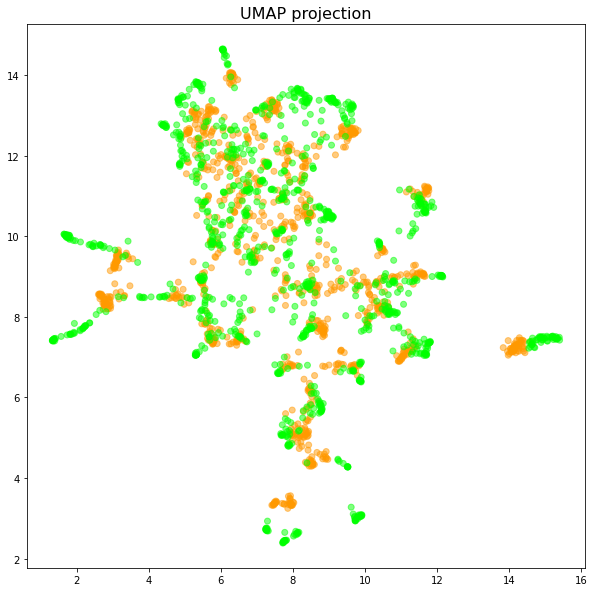

In [152]:
combined = np.concatenate((clip_texts,clip_brains),axis=0)
print("combined.shape",combined.shape)

reducer = umap.UMAP(random_state=42)
embedding = reducer.fit_transform(combined)

# colors=np.array([[0,0,1,.5] for i in range(len(clip_images))])
colors=np.array([[1,.6,0,.5] for i in range(len(clip_texts))])
colors=np.concatenate((colors, np.array([[0,1,0,.5] for i in range(len(clip_brains))])))

plt.figure(figsize=(10,10))
plt.scatter(
    embedding[:, 0],
    embedding[:, 1],
    c=colors)
plt.title('UMAP projection',fontsize=16)
plt.savefig(f'UMAP_text_brain.png')
plt.show()

combined.shape (2176, 768)


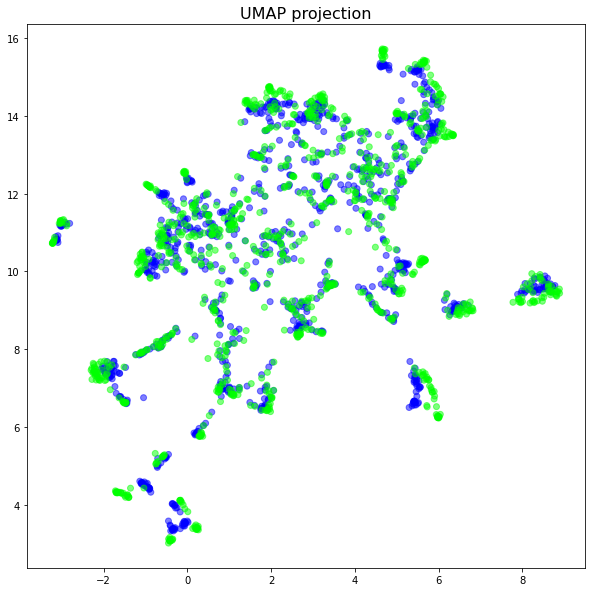

In [148]:
combined = np.concatenate((clip_images,clip_brains),axis=0)
print("combined.shape",combined.shape)

reducer = umap.UMAP(random_state=42)
embedding = reducer.fit_transform(combined)

colors=np.array([[0,0,1,.5] for i in range(len(clip_images))])
# colors=np.concatenate((colors, np.array([[1,.6,0,.5] for i in range(len(clip_texts))])))
colors=np.concatenate((colors, np.array([[0,1,0,.5] for i in range(len(clip_brains))])))

plt.figure(figsize=(10,10))
plt.scatter(
    embedding[:, 0],
    embedding[:, 1],
    c=colors)
plt.title('UMAP projection',fontsize=16)
plt.savefig(f'UMAP_image_brain.png')
plt.show()

combined.shape (2002, 197376)


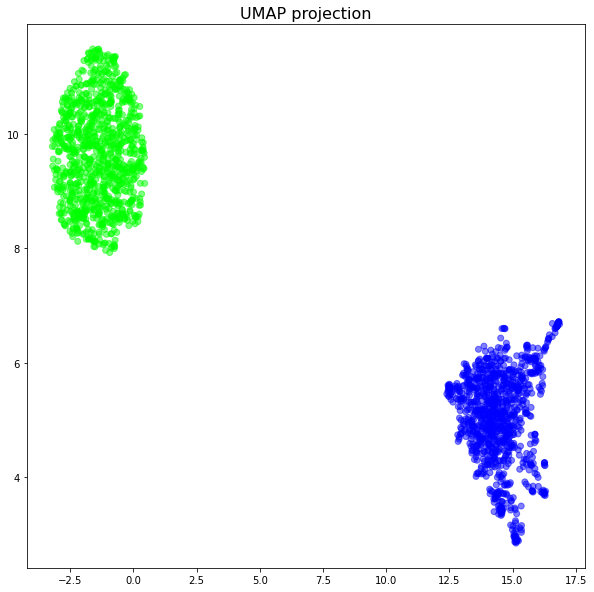

In [27]:
combined = np.concatenate((clip_images,clip_brains),axis=0)
print("combined.shape",combined.shape)

reducer = umap.UMAP(random_state=42)
embedding = reducer.fit_transform(combined)

colors=np.array([[0,0,1,.5] for i in range(len(clip_images))])
# colors=np.concatenate((colors, np.array([[1,.6,0,.5] for i in range(len(clip_texts))])))
colors=np.concatenate((colors, np.array([[0,1,0,.5] for i in range(len(clip_brains))])))

plt.figure(figsize=(10,10))
plt.scatter(
    embedding[:, 0],
    embedding[:, 1],
    c=colors)
plt.title('UMAP projection',fontsize=16)
plt.savefig(f'UMAP_image_brain.png')
plt.show()

combined.shape (1200, 197376)


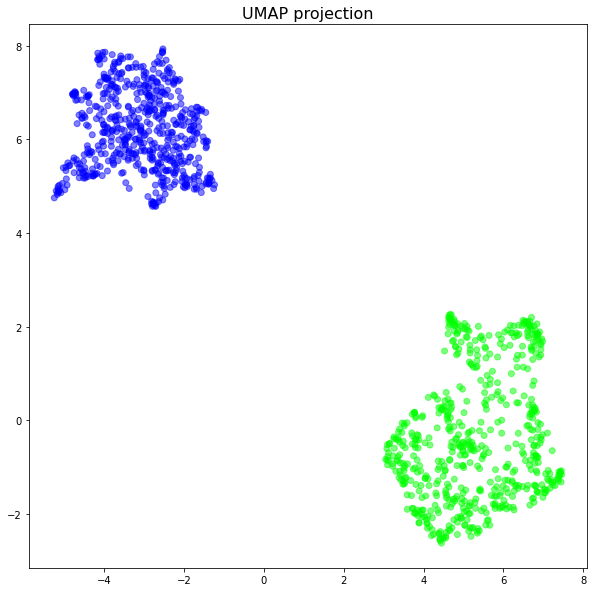

In [56]:
# pearson4 (normalized across last dimension of 3d input)
combined = np.concatenate((clip_images,clip_brains),axis=0)
print("combined.shape",combined.shape)

reducer = umap.UMAP(random_state=42)
embedding = reducer.fit_transform(combined)

colors=np.array([[0,0,1,.5] for i in range(len(clip_images))])
# colors=np.concatenate((colors, np.array([[1,.6,0,.5] for i in range(len(clip_texts))])))
colors=np.concatenate((colors, np.array([[0,1,0,.5] for i in range(len(clip_brains))])))

plt.figure(figsize=(10,10))
plt.scatter(
    embedding[:, 0],
    embedding[:, 1],
    c=colors)
plt.title('UMAP projection',fontsize=16)
# plt.savefig(f'UMAP_image_brain.png')
plt.show()

combined.shape (1200, 197376)


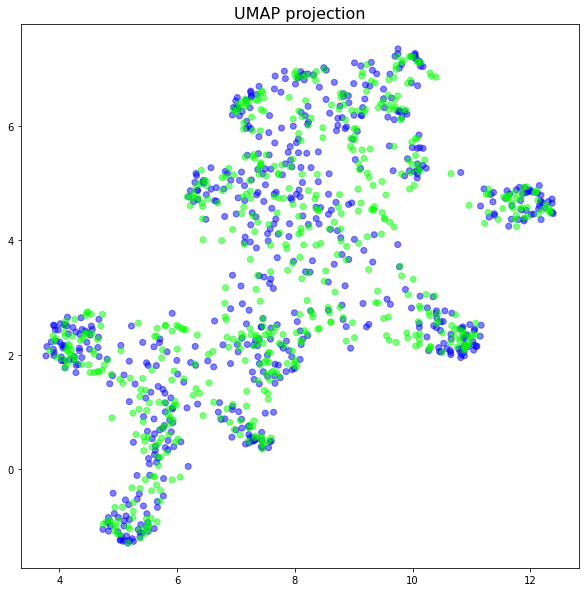

In [18]:
# pearsononly_mse
combined = np.concatenate((clip_images,clip_brains),axis=0)
print("combined.shape",combined.shape)

reducer = umap.UMAP(random_state=42)
embedding = reducer.fit_transform(combined)

colors=np.array([[0,0,1,.5] for i in range(len(clip_images))])
# colors=np.concatenate((colors, np.array([[1,.6,0,.5] for i in range(len(clip_texts))])))
colors=np.concatenate((colors, np.array([[0,1,0,.5] for i in range(len(clip_brains))])))

plt.figure(figsize=(10,10))
plt.scatter(
    embedding[:, 0],
    embedding[:, 1],
    c=colors)
plt.title('UMAP projection',fontsize=16)
# plt.savefig(f'UMAP_image_brain.png')
plt.show()

combined.shape (1200, 197376)


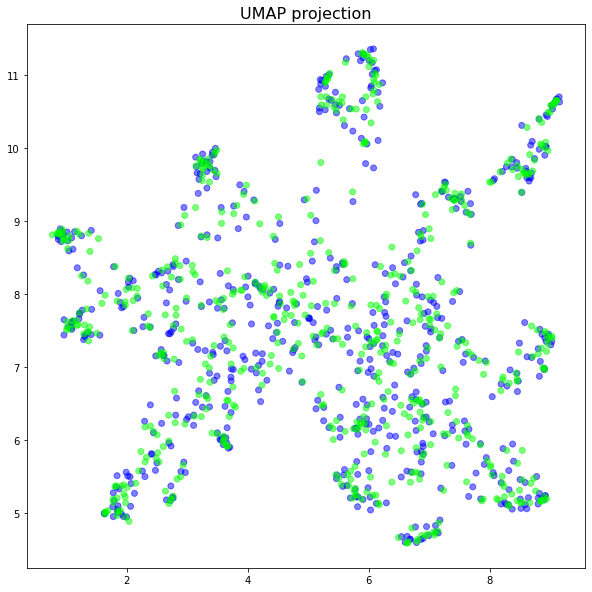

In [11]:
# pearsononly_
combined = np.concatenate((clip_images,clip_brains),axis=0)
print("combined.shape",combined.shape)

reducer = umap.UMAP(random_state=42)
embedding = reducer.fit_transform(combined)

colors=np.array([[0,0,1,.5] for i in range(len(clip_images))])
# colors=np.concatenate((colors, np.array([[1,.6,0,.5] for i in range(len(clip_texts))])))
colors=np.concatenate((colors, np.array([[0,1,0,.5] for i in range(len(clip_brains))])))

plt.figure(figsize=(10,10))
plt.scatter(
    embedding[:, 0],
    embedding[:, 1],
    c=colors)
plt.title('UMAP projection',fontsize=16)
# plt.savefig(f'UMAP_image_brain.png')
plt.show()

combined.shape (800, 197376)


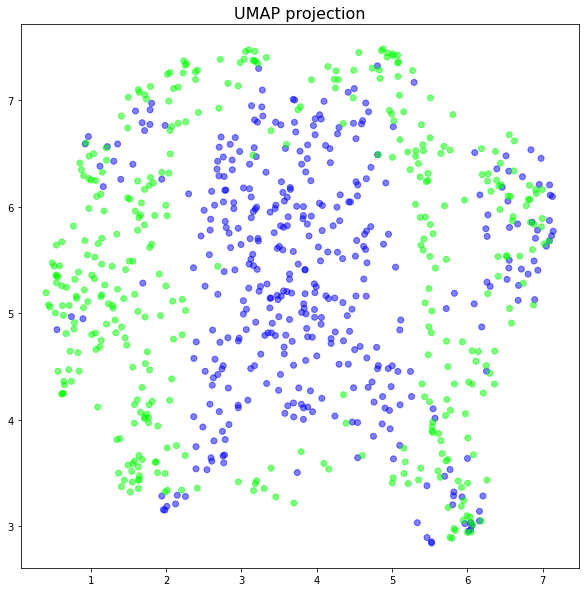

In [11]:
# mse5 finetuned more
combined = np.concatenate((clip_images,clip_brains),axis=0)
print("combined.shape",combined.shape)

reducer = umap.UMAP(random_state=42)
embedding = reducer.fit_transform(combined)

colors=np.array([[0,0,1,.5] for i in range(len(clip_images))])
# colors=np.concatenate((colors, np.array([[1,.6,0,.5] for i in range(len(clip_texts))])))
colors=np.concatenate((colors, np.array([[0,1,0,.5] for i in range(len(clip_brains))])))

plt.figure(figsize=(10,10))
plt.scatter(
    embedding[:, 0],
    embedding[:, 1],
    c=colors)
plt.title('UMAP projection',fontsize=16)
plt.savefig(f'UMAP_image_brain.png')
plt.show()

combined.shape (2176, 768)


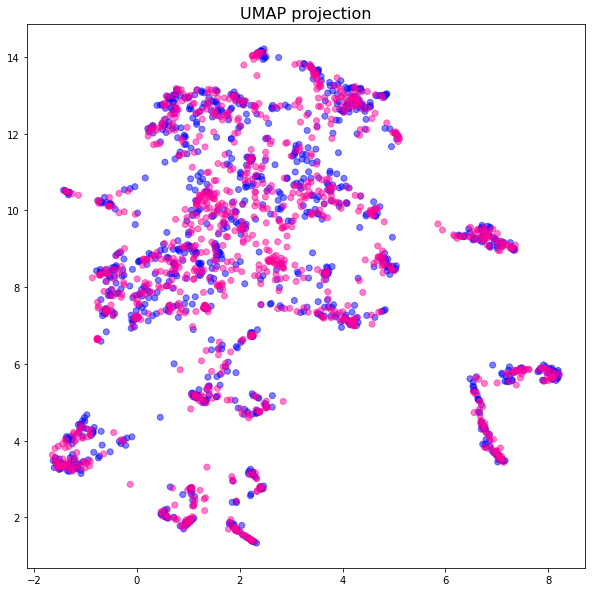

In [149]:
combined = np.concatenate((clip_images,clip_brains_aligned),axis=0)
print("combined.shape",combined.shape)

reducer = umap.UMAP(random_state=42)
embedding = reducer.fit_transform(combined)

colors=np.array([[0,0,1,.5] for i in range(len(clip_images))])
# colors=np.concatenate((colors, np.array([[1,.6,0,.5] for i in range(len(clip_texts))])))
colors=np.concatenate((colors, np.array([[1,0,.6,.5] for i in range(len(clip_brains_aligned))])))

plt.figure(figsize=(10,10))
plt.scatter(
    embedding[:, 0],
    embedding[:, 1],
    c=colors)
plt.title('UMAP projection',fontsize=16)
plt.savefig(f'UMAP_image_brain-aligned.png')
plt.show()

combined.shape (2176, 768)


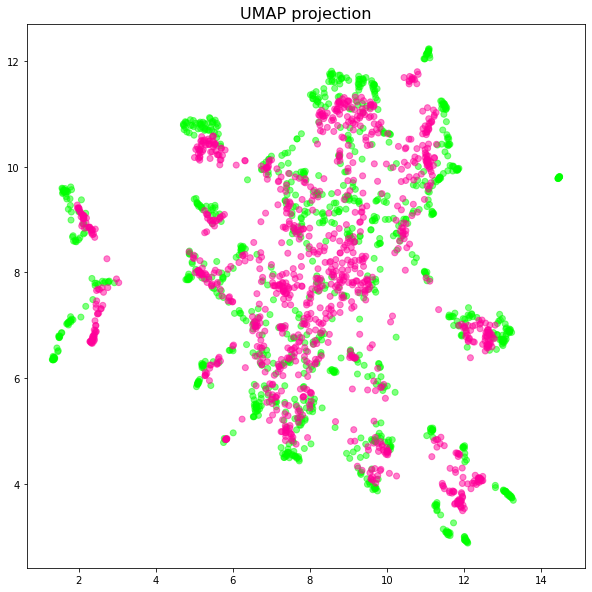

In [150]:
combined = np.concatenate((clip_brains,clip_brains_aligned),axis=0)
print("combined.shape",combined.shape)

reducer = umap.UMAP(random_state=42)
embedding = reducer.fit_transform(combined)

colors=np.array([[0,1,0,.5] for i in range(len(clip_brains))])
colors=np.concatenate((colors, np.array([[1,0,.6,.5] for i in range(len(clip_brains_aligned))])))

plt.figure(figsize=(10,10))
plt.scatter(
    embedding[:, 0],
    embedding[:, 1],
    c=colors)
plt.title('UMAP projection',fontsize=16)
plt.savefig(f'UMAP_brain_brain-aligned.png')
plt.show()

combined.shape (3264, 768)


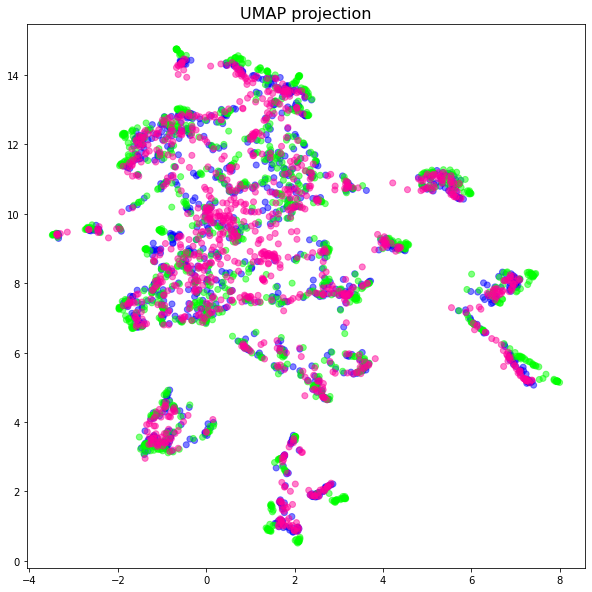

In [13]:
combined = np.concatenate((clip_images,clip_brains,clip_brains_aligned),axis=0)
print("combined.shape",combined.shape)

reducer = umap.UMAP(random_state=42)
embedding = reducer.fit_transform(combined)

colors=np.array([[0,0,1,.5] for i in range(len(clip_images))])
colors=np.concatenate((colors, np.array([[0,1,0,.5] for i in range(len(clip_brains))])))
colors=np.concatenate((colors, np.array([[1,0,.6,.5] for i in range(len(clip_brains_aligned))])))

plt.figure(figsize=(10,10))
plt.scatter(
    embedding[:, 0],
    embedding[:, 1],
    c=colors)
plt.title('UMAP projection',fontsize=16)
plt.savefig(f'UMAP_image_brain_brain-aligned.png')
plt.show()

In [ ]:
combined = np.concatenate((clip_images,clip_texts,clip_brains),axis=0)
print("combined.shape",combined.shape)

reducer = umap.UMAP()
embedding = reducer.fit_transform(combined)

colors=np.array([[0,0,1,.5] for i in range(len(clip_images))])
colors=np.concatenate((colors, np.array([[1,.6,0,.5] for i in range(len(clip_texts))])))
colors=np.concatenate((colors, np.array([[0,1,0,.5] for i in range(len(clip_brains))])))

plt.figure(figsize=(10,10))
plt.scatter(
    embedding[:, 0],
    embedding[:, 1],
    c=colors)
plt.title('UMAP projection',fontsize=16)
plt.savefig(f'UMAP_text_image_brain.png')
plt.show()